In [1]:
import os, glob

import pickle
import numpy as np
import pandas as pd
import lightkurve as lk
import matplotlib.pyplot as plt
from matplotlib import colors
from matplotlib import patches
from tqdm.auto import tqdm

from astropy.io import fits
from astropy.table import Table

path = os.path.dirname(os.getcwd())
sys.path.append(path)
from kepler_apertures import EXBAMachine

%matplotlib inline

In [4]:
Q = 5
quarters = np.arange(5, 18)
channels = np.arange(1, 85)
channels = np.delete(channels, [4,5,6,7])
quarters, channels

(array([ 5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17]),
 array([ 1,  2,  3,  4,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21,
        22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38,
        39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55,
        56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72,
        73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84]))

In [5]:
# Load EXBA stamp, catalo, and metadata
catalogs_q = {}
stamps_q = {}
for q in tqdm(quarters, desc="Quarters"):
    catalogs_ch = {}
    stamps_ch = {}
    for ch in channels:
        hdu = fits.open("../data/export/%i/%02i/image_gaiadr3.fits.gz" % (q, ch))
        hdr = hdu[0].header
        img = hdu[1].data
        cat = Table(hdu[2].data).to_pandas()
        catalogs_ch[ch] = cat
        stamps_ch[ch] = img
    catalogs = pd.concat(list(catalogs_ch.values()), axis=0)
    catalogs_q[q] = catalogs
    stamps_q[q] = stamps_ch

Quarters:   0%|          | 0/13 [00:00<?, ?it/s]

In [11]:
# Load EXBA stamp, catalo, and metadata
bls_results_q = {}
clcs_q = {}
for q in tqdm(quarters, desc="Quarters"):
    bls_results_ch = {}
    clcs_ch = {}
    for ch in channels:
        aux = pickle.load(open("../data/export/%i/%02i/bls_results_new.pkl" % (q, ch), "rb"))
        # power.append(aux["power"])
        # frequency.append(aux["frequency"])
        clcs_ch[ch] = aux["lc_corrected"]
        df_ = aux["table"]
        df_["channel"] = ch
        bls_results_ch[ch] = df_

    df = pd.concat(list(bls_results_ch.values()), axis=0)
    bls_results_q[q] = df
    clcs_q[q] = clcs_ch

Quarters:   0%|          | 0/13 [00:00<?, ?it/s]

FileNotFoundError: [Errno 2] No such file or directory: '../data/export/9/09/bls_results_new.pkl'

In [7]:
def plot_stamp(flux, catalog, idx, aperture=None, ax=None, row0=0, col0=0):

    if ax is None:
        fig, ax = plt.subplots(1)
    pc = ax.pcolor(
        flux,
        shading="auto",
        norm=colors.SymLogNorm(linthresh=50, vmin=3, vmax=5000, base=10),
    )
    ax.scatter(
        catalog.col - col0 + 0.5,
        catalog.row - row0 + 0.5,
        s=20,
        facecolors="y",
        marker="o",
        edgecolors="k",
    )
    ax.scatter(
        catalog.col.iloc[idx] - col0 + 0.5,
        catalog.row.iloc[idx] - row0 + 0.5,
        s=25,
        facecolors="r",
        marker="o",
        edgecolors="r",
    )
    ax.set_xlabel("Pixels")
    ax.set_ylabel("Pixels")
    plt.colorbar(pc, label=r"Flux ($e^{-}s^{-1}$)", ax=ax)
    ax.set_aspect("equal", adjustable="box")

    if not aperture is None:
        for i in range(flux.shape[0]):
            for j in range(flux.shape[1]):
                if aperture[i, j]:
                    rect = patches.Rectangle(
                        xy=(j, i),
                        width=1,
                        height=1,
                        color="red",
                        fill=False,
                        hatch="",
                        lw=1.5,
                    )
                    ax.add_patch(rect)
        zoom = np.argwhere(aperture == True)
        ax.set_ylim(
            np.maximum(0, zoom[0, 0] - 5),
            np.minimum(zoom[-1, 0] + 5, flux.shape[0]),
        )
        ax.set_xlim(
            np.maximum(0, zoom[0, -1] - 5),
            np.minimum(zoom[-1, -1] + 5, flux.shape[1]),
        )

    return ax

ap_names = np.array(["O", 1, 2 ,3 ,4, 5, 6 ,7])
def plot_highlights(table, do_interact=False):
    user = []
    for i, row, in table.iterrows():
        fname = "../data/export/%i/%02i/lc_%s.fits.gz" % (Q, row.channel, row.designation.replace(" ", "_"))
        lc = lk.KeplerLightCurve.read(fname)
        win = row.Aperture if row.Aperture != "O" else ""
        lc.flux = lc["flux%s" % str(win)]
        lc.flux_err = lc["flux_err%s" % str(win)]
        k = 0 if row.Aperture == "O" else int(row.Aperture)
        k = 7
        FLFRCSAP = lc.meta["FLFRSAP%s" % (k)]
        CROWDSAP = lc.meta["CRWDSAP%s" % (k)]
        ap_mask = fits.open(fname)[k + 2].data
        
        clc = clcs[row.channel][i]
        print(catalogs[catalogs.designation == clc.label].iloc[0])

        fig = plt.figure(figsize=(13, 7))
        sub1 = fig.add_subplot(2, 3, (1,3))
        sub1.set_title("Ch %i      " % (row.channel) + clc.label)
        lc.normalize().plot(ax=sub1, c="k", label="Raw")
        clc.normalize().plot(ax=sub1, c="tab:blue", label="Corrected")

        sub2 = fig.add_subplot(2, 3, (4,5))
        folded_clc = clc.remove_outliers(sigma_upper=5, 
                                         sigma_lower=1e10).fold(row.BLS_period)
        info = "\nP = %.4f  \nSNR = %.0f \nDepth = %.5f" % (row.BLS_period, row.BLS_period_SNR, row.BLS_depth)
        folded_clc.normalize().scatter(ax=sub2, alpha=.5, c='k', marker='.', 
                                       label=info)

        sub3 = fig.add_subplot(2, 3, 6)
        sub3.set_title("FLFRCSAP    %.3f \nCROWDSAP %.3f" % 
                       (FLFRCSAP, CROWDSAP),
                  fontsize=12,
                  bbox=dict(facecolor='white', alpha=1))
        
        
        plot_stamp(stamps[row.channel], catalogs_dict[row.channel], i, 
                   aperture=ap_mask, ax=sub3, row0=558, col0=556)
        # sub3.axes.xaxis.set_ticks([])
        # sub3.axes.yaxis.set_ticks([])

        plt.show()

        #whatis = input("What type of variable ([E]cl, [S]in, [A]ct, [F]alse): ")
        #user.append(whatis)
        print("___________________________________________________")
        # break
    return

## Filtering by Power SNR

In [11]:
high_snr = df.query("BLS_period_SNR >= 50").sort_values("BLS_period", ascending=False)
high_snr

,designation,FLFRSAP,CRWDSAP,Aperture,BLS_period,BLS_period_SNR,BLS_duration,BLS_depth,channel
133,Gaia EDR3 2079019807723929088,0.8503,0.4492,O,29.029433,60.397009,0.030,0.003593,81
25,Gaia EDR3 2101137038167330816,0.8699,0.7469,7,29.029433,72.500604,0.030,0.010558,27
65,Gaia EDR3 2126835511126494464,0.8871,0.6208,7,29.029433,58.927980,0.030,0.005244,42
14,Gaia EDR3 2077708781842667776,0.9167,0.657,7,29.029433,67.294486,0.030,0.003475,47
29,Gaia EDR3 2101033924593917056,0.7306,0.8408,O,29.029433,55.628952,0.030,0.018829,28
...,...,...,...,...,...,...,...,...,...
93,Gaia EDR3 2101137450481652480,0.7525,0.8251,7,0.508755,313.512764,0.330,0.002349,27
94,Gaia EDR3 2101137450486311680,0.9568,0.5851,7,0.508526,487.760046,0.399,0.002015,27
139,Gaia EDR3 2082093084451836672,0.9106,0.3198,7,0.500098,163.338878,0.450,0.000771,84
140,Gaia EDR3 2082093084461923328,0.917,0.3596,O,0.500098,161.667128,0.450,0.000755,84


## Filtering by depth, period, and duration

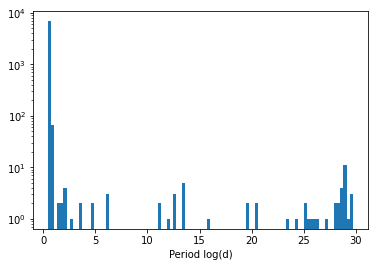

In [12]:
plt.hist(df.BLS_period, bins=100, log=True)
plt.xlabel("Period log(d)")
# plt.xscale("log")
plt.show()

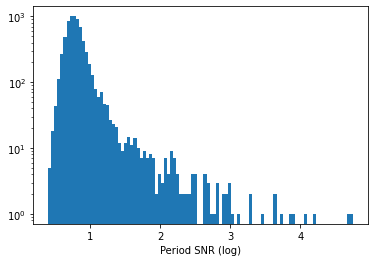

In [14]:
plt.hist(np.log10(df.BLS_period_SNR), bins=100, log=True)
plt.xlabel("Period SNR (log)")
plt.show()

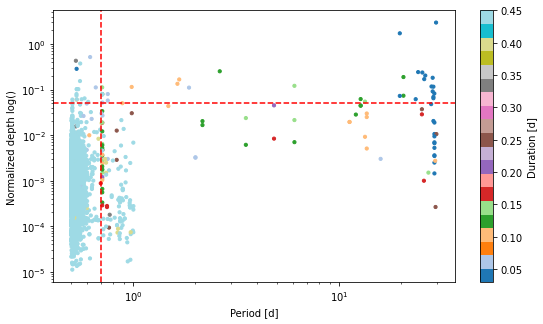

In [19]:
plt.figure(figsize=(9,5))
cbar = plt.scatter(df.BLS_period, df.BLS_depth, c=df.BLS_duration, s=10, cmap="tab20")
plt.colorbar(cbar, label="Duration [d]")
plt.axvline(0.7, c="r", ls="--")
plt.axhline(0.05, c="r", ls="--")
plt.xscale("log")
plt.yscale("log")
plt.xlabel("Period [d]")
plt.ylabel("Normalized depth log()")
plt.show()

In [34]:
from_depth = df.query("BLS_depth < 0.1 and BLS_period > 0.7").sort_values("BLS_period", ascending=True)
from_depth

,designation,FLFRSAP,CRWDSAP,Aperture,BLS_period,BLS_period_SNR,BLS_duration,BLS_depth,channel
91,Gaia EDR3 2082091568328182528,0.5568,0.9365,O,0.701866,83.453327,0.051,0.030010,84
73,Gaia EDR3 2127957700182224256,0.8695,0.9632,7,0.702351,447.162805,0.399,0.018250,61
1,Gaia EDR3 2073682438989966592,0.7926,0.5676,7,0.707531,17.717531,0.174,0.000286,72
89,Gaia EDR3 2075405128886640384,0.676,0.9849,O,0.707695,42.021504,0.174,0.018684,70
34,Gaia EDR3 2073682610777760640,0.7243,0.4439,O,0.707777,25.404306,0.150,0.001106,72
...,...,...,...,...,...,...,...,...,...
29,Gaia EDR3 2101033924593917056,0.7306,0.8408,O,29.029433,55.628952,0.030,0.018829,28
14,Gaia EDR3 2077708781842667776,0.9167,0.657,7,29.029433,67.294486,0.030,0.003475,47
15,Gaia EDR3 2128156883587655424,0.8991,0.4585,7,29.280183,25.123114,0.099,0.002726,63
32,Gaia EDR3 2107266570672734592,0.9861,1.0,O,29.393024,40.670573,0.249,0.000264,17


## Whitening the BLS periodogram

In [21]:
max_shape = np.asarray([pow.shape for pow in power]).max()
padded_power = np.vstack([np.pad(pow, ((0,0), (0, max_shape - pow.shape[1]))) for pow in power])

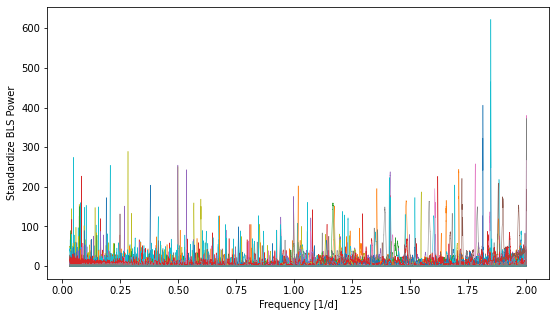

In [22]:
filtered = {}
plt.figure(figsize=(9, 5))
for ic in range(len(power)):
    pmean, pstd = power[ic].mean(), power[ic].std()
    aux = []
    for s in range(power[ic].shape[0]):
        freq = frequency[ic]
        pow = power[ic][s, :]
        pow_n = (pow - pmean) / pstd
        if np.any(pow_n > 100):
            aux.append(s)
        plt.plot(freq, pow_n, lw=0.5)
    filtered[channels[ic]] = aux

    # if ic == 10: break
        
plt.xlabel("Frequency [1/d]")
plt.ylabel("Standardize BLS Power")
plt.show()


In [24]:
from_whitening = pd.concat([bls_results[i].loc[filtered[i]] for i in channels], axis=0)
from_whitening

,designation,FLFRSAP,CRWDSAP,Aperture,BLS_period,BLS_period_SNR,BLS_duration,BLS_depth,channel
17,Gaia EDR3 2104814389164263168,0.5665,0.8762,O,0.595185,457.112753,0.051,0.049293,3
30,Gaia EDR3 2100490555389337984,0.9176,0.9918,O,0.580674,208.742975,0.450,0.063922,9
38,Gaia EDR3 2100240347774313728,0.3576,0.9973,7,1.673510,157.334655,0.099,0.166682,12
0,Gaia EDR3 2107265956496766208,0.9546,0.9923,7,0.604514,5206.718431,0.450,0.053687,17
16,Gaia EDR3 2106327622103110784,0.8709,0.7286,O,20.531197,225.083582,0.126,0.188219,18
22,Gaia EDR3 2102900998414760448,0.876,0.9809,7,1.481478,196.862048,0.099,0.043416,22
94,Gaia EDR3 2101137450486311680,0.9568,0.5851,7,0.508526,487.760046,0.399,0.002015,27
27,Gaia EDR3 2101033890234177792,0.6208,0.9853,7,1.867195,151.049931,0.051,0.110262,28
49,Gaia EDR3 2051919599177738752,0.7097,0.9132,7,0.531480,521.960357,0.099,0.059974,31
55,Gaia EDR3 2051773845167236352,0.7969,0.9732,O,0.852823,99.625078,0.450,0.000272,32


## Combine all filters 

# Plotting results

designation                Gaia EDR3 2082091568328182528
ra                                            300.706337
ra_error                                        0.536262
dec                                            44.588175
dec_error                                       0.536333
pmra                                           -1.007749
pmdec                                          -4.137242
parallax                                        1.010692
parallax_error                                   0.60526
phot_g_n_obs                                         358
phot_g_mean_flux                              721.000781
phot_g_mean_flux_error                          5.391713
phot_g_mean_mag                                18.542528
phot_bp_n_obs                                         42
phot_bp_mean_flux                             342.239988
phot_bp_mean_flux_error                         7.870771
phot_bp_mean_mag                               19.002716
phot_rp_n_obs                  

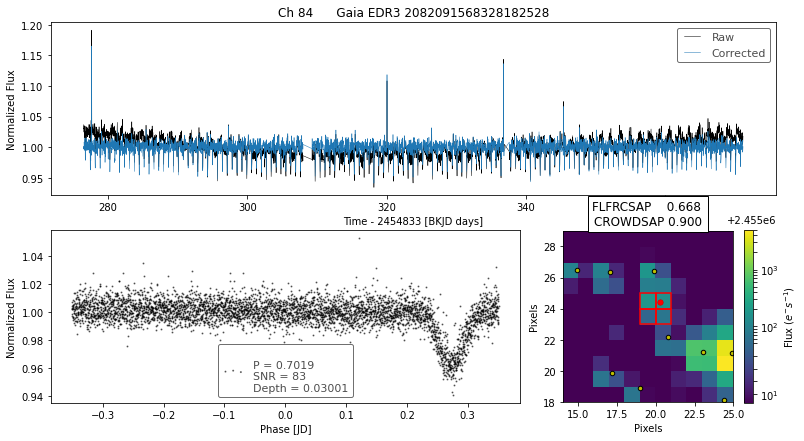

___________________________________________________
designation                Gaia EDR3 2127957700182224256
ra                                            293.874203
ra_error                                        0.035765
dec                                            45.223999
dec_error                                        0.04142
pmra                                             4.43126
pmdec                                           1.116559
parallax                                        5.953327
parallax_error                                  0.041449
phot_g_n_obs                                         393
phot_g_mean_flux                             4178.306347
phot_g_mean_flux_error                           5.06697
phot_g_mean_mag                                16.634867
phot_bp_n_obs                                         45
phot_bp_mean_flux                             636.083397
phot_bp_mean_flux_error                         8.377221
phot_bp_mean_mag                    

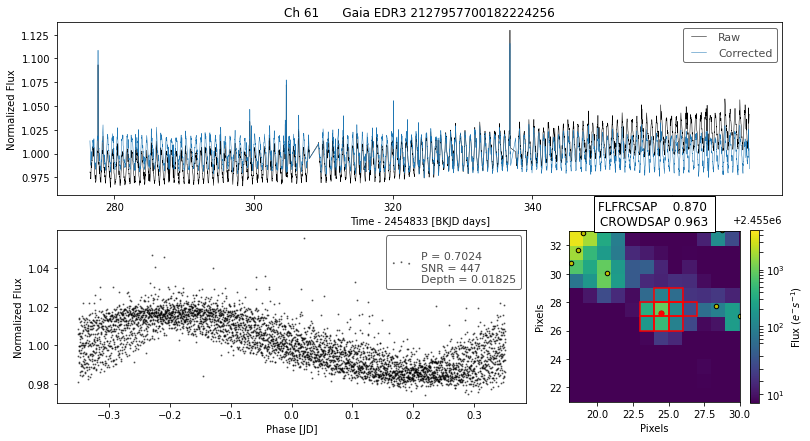

___________________________________________________
designation                Gaia EDR3 2073682438989966592
ra                                             297.65259
ra_error                                         0.02627
dec                                            40.238272
dec_error                                       0.030298
pmra                                           -2.031415
pmdec                                          -3.997324
parallax                                        0.323921
parallax_error                                  0.033372
phot_g_n_obs                                         397
phot_g_mean_flux                             7159.109876
phot_g_mean_flux_error                          2.850908
phot_g_mean_mag                                16.050219
phot_bp_n_obs                                         23
phot_bp_mean_flux                            3299.090994
phot_bp_mean_flux_error                        10.760449
phot_bp_mean_mag                    

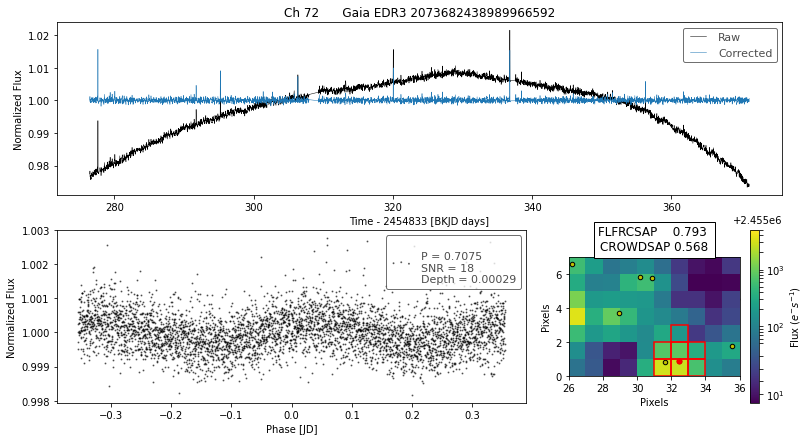

___________________________________________________
designation                Gaia EDR3 2075405128886640384
ra                                            298.300025
ra_error                                        0.199299
dec                                            41.806164
dec_error                                       0.218637
pmra                                           -2.904548
pmdec                                          -3.785807
parallax                                         0.30875
parallax_error                                  0.229989
phot_g_n_obs                                         389
phot_g_mean_flux                              295.129789
phot_g_mean_flux_error                          0.778933
phot_g_mean_mag                                19.512335
phot_bp_n_obs                                         43
phot_bp_mean_flux                             119.576089
phot_bp_mean_flux_error                         4.081766
phot_bp_mean_mag                    

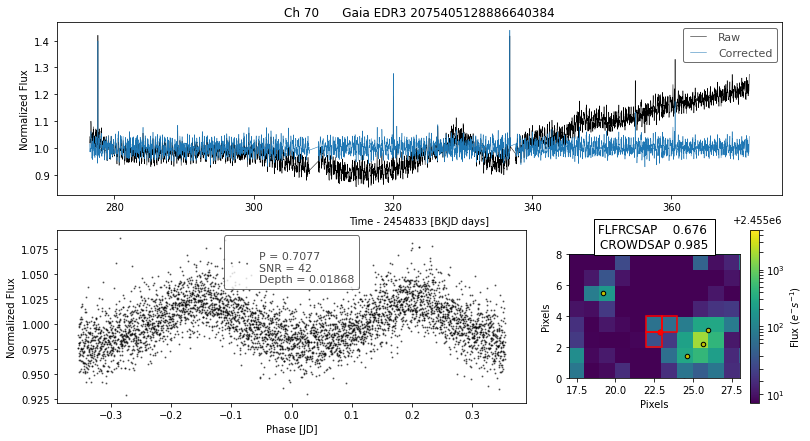

___________________________________________________
designation                Gaia EDR3 2073682610777760640
ra                                            297.626996
ra_error                                        0.040583
dec                                            40.236587
dec_error                                       0.046402
pmra                                           -3.907147
pmdec                                          -0.601569
parallax                                        0.489693
parallax_error                                  0.051519
phot_g_n_obs                                         400
phot_g_mean_flux                             3016.759688
phot_g_mean_flux_error                          1.941408
phot_g_mean_mag                                16.988516
phot_bp_n_obs                                         47
phot_bp_mean_flux                            1294.156515
phot_bp_mean_flux_error                         8.267686
phot_bp_mean_mag                    

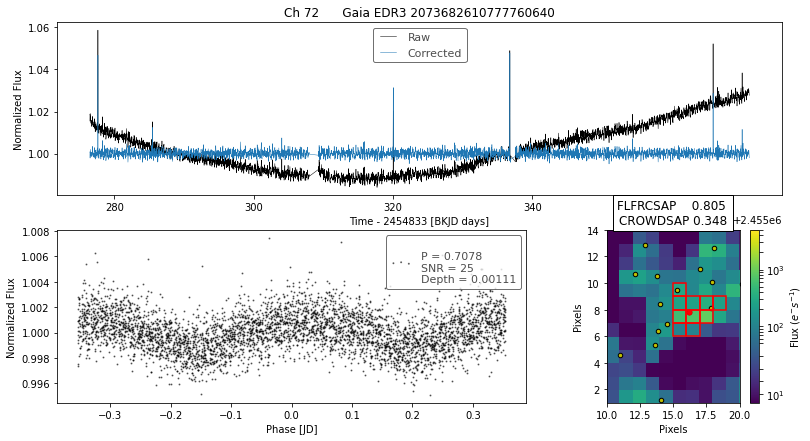

___________________________________________________
designation                Gaia EDR3 2073682709562067712
ra                                            297.630642
ra_error                                        0.049656
dec                                            40.240718
dec_error                                       0.055627
pmra                                           -3.369246
pmdec                                          -8.352567
parallax                                        0.272918
parallax_error                                  0.063284
phot_g_n_obs                                         381
phot_g_mean_flux                             2266.151655
phot_g_mean_flux_error                          1.603718
phot_g_mean_mag                                17.299145
phot_bp_n_obs                                         43
phot_bp_mean_flux                             947.003546
phot_bp_mean_flux_error                        13.147779
phot_bp_mean_mag                    

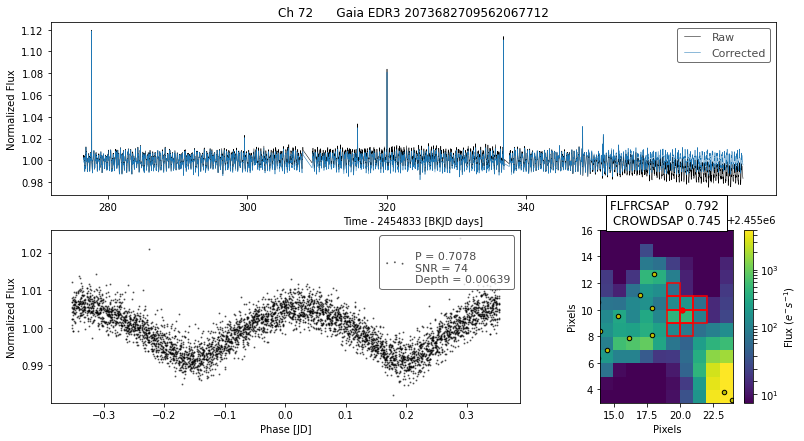

___________________________________________________
designation                Gaia EDR3 2073682645147919616
ra                                            297.640068
ra_error                                        0.010282
dec                                            40.236063
dec_error                                       0.010969
pmra                                           -3.730202
pmdec                                          -7.869544
parallax                                         1.25622
parallax_error                                  0.012478
phot_g_n_obs                                         437
phot_g_mean_flux                           481638.560593
phot_g_mean_flux_error                         2468.6584
phot_g_mean_mag                                11.480564
phot_bp_n_obs                                         51
phot_bp_mean_flux                          281855.570612
phot_bp_mean_flux_error                        4331.7393
phot_bp_mean_mag                    

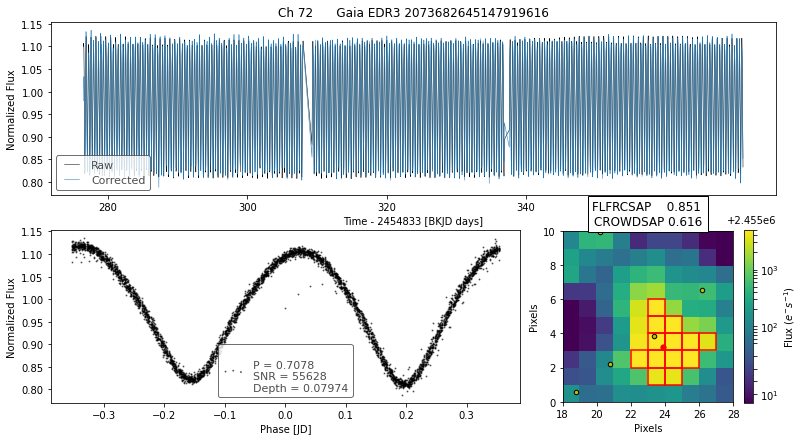

___________________________________________________
designation                Gaia EDR3 2073682645147919104
ra                                            297.638902
ra_error                                        0.017516
dec                                            40.236398
dec_error                                       0.019735
pmra                                           -2.663372
pmdec                                          -6.132508
parallax                                        0.427393
parallax_error                                  0.021972
phot_g_n_obs                                         375
phot_g_mean_flux                            16100.603597
phot_g_mean_flux_error                          5.504622
phot_g_mean_mag                                15.170261
phot_bp_n_obs                                         34
phot_bp_mean_flux                            9000.915577
phot_bp_mean_flux_error                         135.6857
phot_bp_mean_mag                    

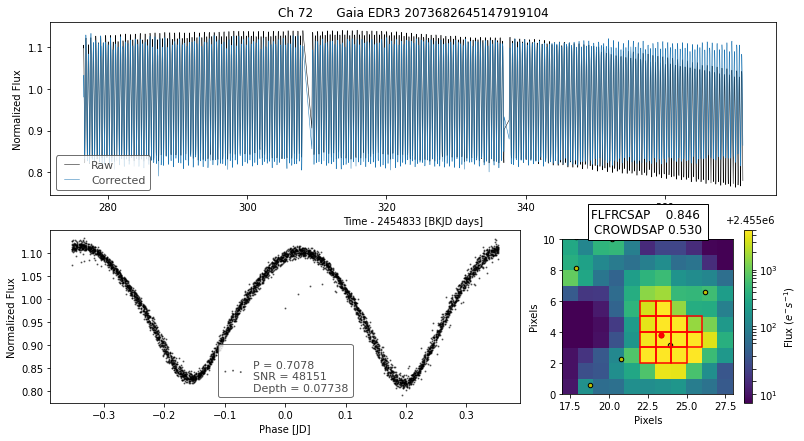

___________________________________________________
designation                Gaia EDR3 2073682606482850176
ra                                            297.625873
ra_error                                         0.18762
dec                                            40.240155
dec_error                                       0.215443
pmra                                           -4.693275
pmdec                                          -9.205584
parallax                                        0.675053
parallax_error                                   0.24048
phot_g_n_obs                                         369
phot_g_mean_flux                              331.883187
phot_g_mean_flux_error                           0.82794
phot_g_mean_mag                                19.384903
phot_bp_n_obs                                         45
phot_bp_mean_flux                              94.018472
phot_bp_mean_flux_error                         5.160549
phot_bp_mean_mag                    

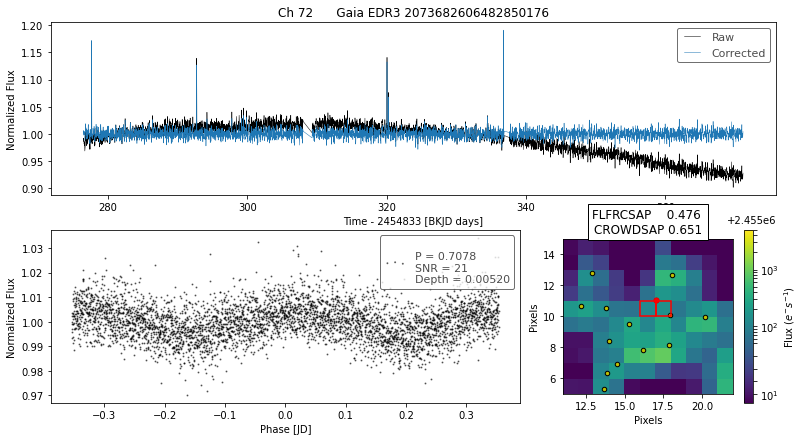

___________________________________________________
designation                Gaia EDR3 2073682537763335040
ra                                            297.628902
ra_error                                        0.130415
dec                                             40.22905
dec_error                                       0.147568
pmra                                           -2.592898
pmdec                                          -4.446498
parallax                                        0.116572
parallax_error                                   0.16561
phot_g_n_obs                                         360
phot_g_mean_flux                              549.255307
phot_g_mean_flux_error                          1.023918
phot_g_mean_mag                                 18.83793
phot_bp_n_obs                                         43
phot_bp_mean_flux                             249.738797
phot_bp_mean_flux_error                         5.887923
phot_bp_mean_mag                    

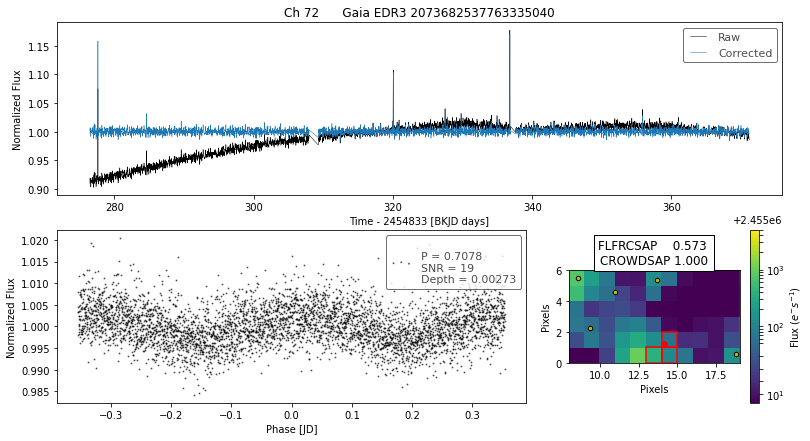

___________________________________________________
designation                Gaia EDR3 2073682645147922688
ra                                            297.640639
ra_error                                        0.042465
dec                                            40.240539
dec_error                                       0.046284
pmra                                           -1.065017
pmdec                                          -7.212282
parallax                                        0.239668
parallax_error                                  0.051906
phot_g_n_obs                                         370
phot_g_mean_flux                             3038.819401
phot_g_mean_flux_error                          1.895849
phot_g_mean_mag                                16.980604
phot_bp_n_obs                                         47
phot_bp_mean_flux                             1357.09476
phot_bp_mean_flux_error                         8.896752
phot_bp_mean_mag                    

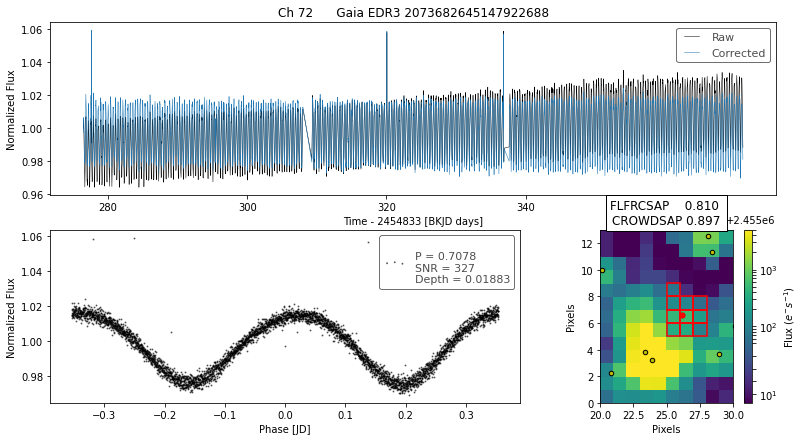

___________________________________________________
designation                Gaia EDR3 2073682645139867264
ra                                            297.645667
ra_error                                        0.176998
dec                                            40.246768
dec_error                                       0.204458
pmra                                            -1.63986
pmdec                                          -3.893655
parallax                                        0.178213
parallax_error                                  0.229017
phot_g_n_obs                                         382
phot_g_mean_flux                              341.068619
phot_g_mean_flux_error                          0.945723
phot_g_mean_mag                                19.355263
phot_bp_n_obs                                         25
phot_bp_mean_flux                             157.518425
phot_bp_mean_flux_error                         5.333365
phot_bp_mean_mag                    

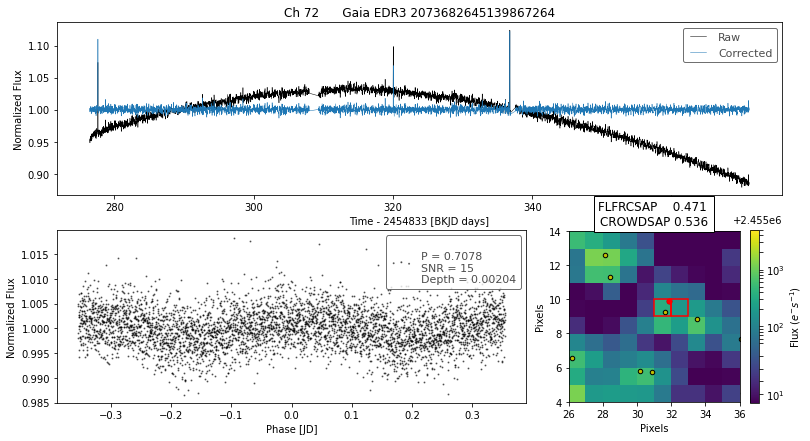

___________________________________________________
designation                Gaia EDR3 2075405133185896960
ra                                            298.296025
ra_error                                        0.092049
dec                                            41.804426
dec_error                                       0.101537
pmra                                           -1.241426
pmdec                                          -4.536844
parallax                                        0.123613
parallax_error                                  0.107739
phot_g_n_obs                                         412
phot_g_mean_flux                              843.675548
phot_g_mean_flux_error                          1.108298
phot_g_mean_mag                                18.371927
phot_bp_n_obs                                         43
phot_bp_mean_flux                             394.112324
phot_bp_mean_flux_error                         6.751357
phot_bp_mean_mag                    

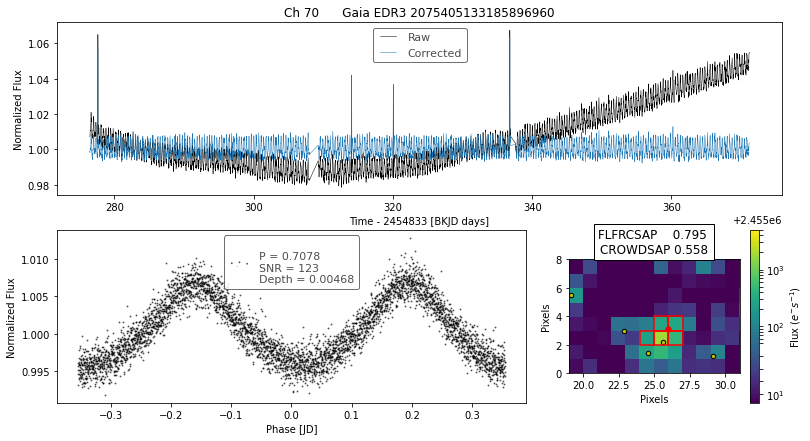

___________________________________________________
designation                Gaia EDR3 2073682542058306816
ra                                            297.636747
ra_error                                        0.331737
dec                                            40.233504
dec_error                                       0.417692
pmra                                           -2.092239
pmdec                                          -4.065271
parallax                                        1.241501
parallax_error                                  0.440588
phot_g_n_obs                                         357
phot_g_mean_flux                              207.276845
phot_g_mean_flux_error                          1.438322
phot_g_mean_mag                                 19.89599
phot_bp_n_obs                                         39
phot_bp_mean_flux                              85.660771
phot_bp_mean_flux_error                         6.799253
phot_bp_mean_mag                    

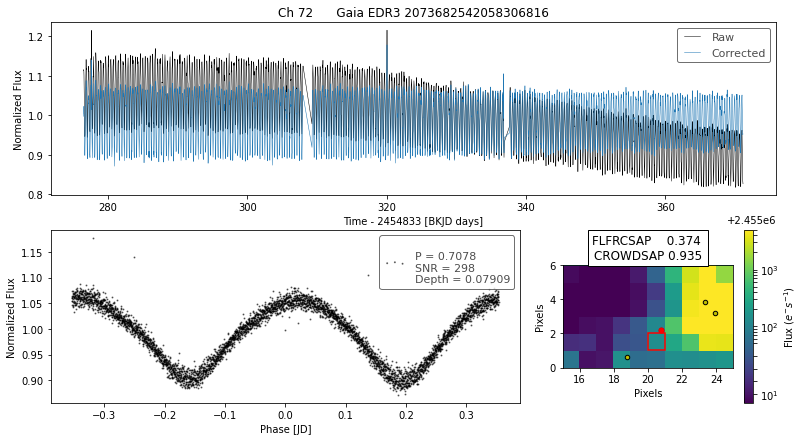

___________________________________________________
designation                Gaia EDR3 2073682713867399552
ra                                            297.635068
ra_error                                        0.027686
dec                                             40.24767
dec_error                                       0.030929
pmra                                            -3.18346
pmdec                                          -7.210478
parallax                                        0.293339
parallax_error                                  0.034541
phot_g_n_obs                                         399
phot_g_mean_flux                             6063.800162
phot_g_mean_flux_error                          2.583657
phot_g_mean_mag                                16.230505
phot_bp_n_obs                                         46
phot_bp_mean_flux                            2588.741296
phot_bp_mean_flux_error                         8.597982
phot_bp_mean_mag                    

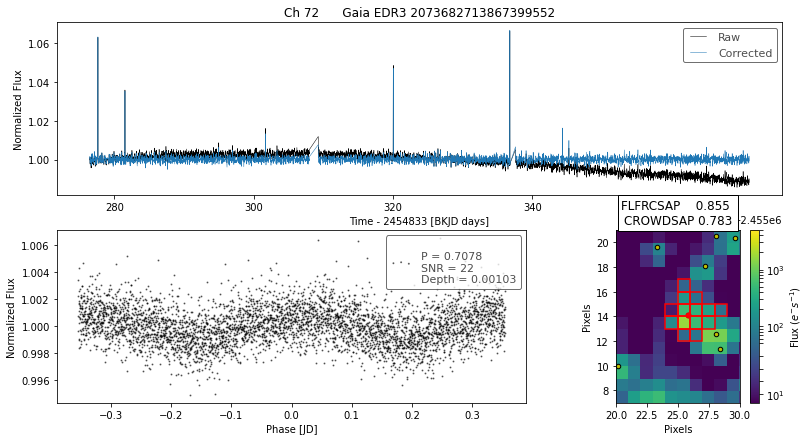

___________________________________________________
designation                Gaia EDR3 2073682640842586368
ra                                            297.646184
ra_error                                        0.037215
dec                                            40.239192
dec_error                                       0.042999
pmra                                            3.790537
pmdec                                          -1.115233
parallax                                        1.864157
parallax_error                                  0.048459
phot_g_n_obs                                         375
phot_g_mean_flux                             3731.459924
phot_g_mean_flux_error                           2.11353
phot_g_mean_mag                                 16.75767
phot_bp_n_obs                                         48
phot_bp_mean_flux                             984.896995
phot_bp_mean_flux_error                         7.433358
phot_bp_mean_mag                    

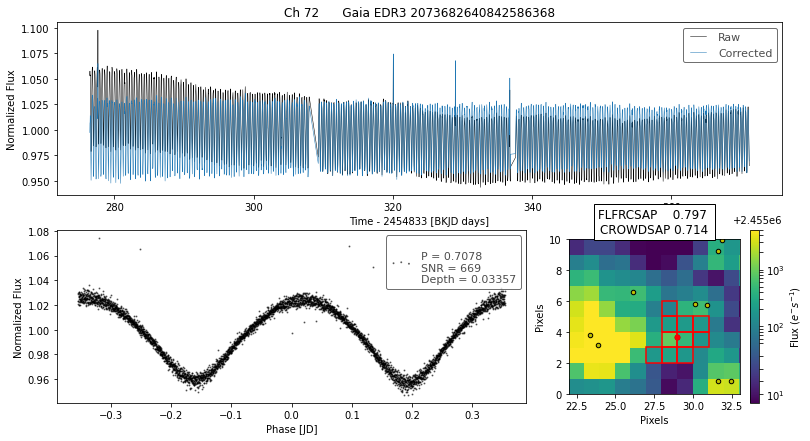

___________________________________________________
designation                Gaia EDR3 2073682640842595968
ra                                            297.646256
ra_error                                        0.051359
dec                                            40.241866
dec_error                                       0.059749
pmra                                           -5.725938
pmdec                                          -8.524964
parallax                                        0.374271
parallax_error                                  0.065971
phot_g_n_obs                                         389
phot_g_mean_flux                             2047.167845
phot_g_mean_flux_error                          1.768883
phot_g_mean_mag                                17.409483
phot_bp_n_obs                                         43
phot_bp_mean_flux                             942.193289
phot_bp_mean_flux_error                          7.12143
phot_bp_mean_mag                    

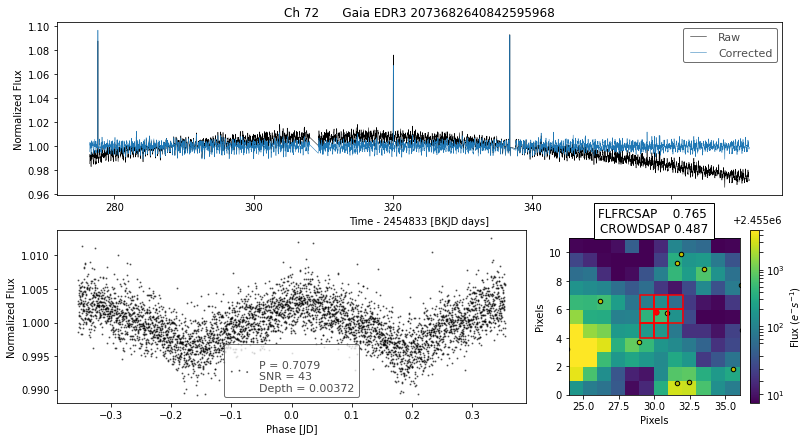

___________________________________________________
designation                Gaia EDR3 2073682542068698496
ra                                            297.635276
ra_error                                        0.141904
dec                                            40.230857
dec_error                                       0.160205
pmra                                           -3.816611
pmdec                                          -1.114109
parallax                                        0.479098
parallax_error                                  0.179901
phot_g_n_obs                                         389
phot_g_mean_flux                              450.544166
phot_g_mean_flux_error                          0.955252
phot_g_mean_mag                                19.053024
phot_bp_n_obs                                         42
phot_bp_mean_flux                              194.09256
phot_bp_mean_flux_error                         7.449246
phot_bp_mean_mag                    

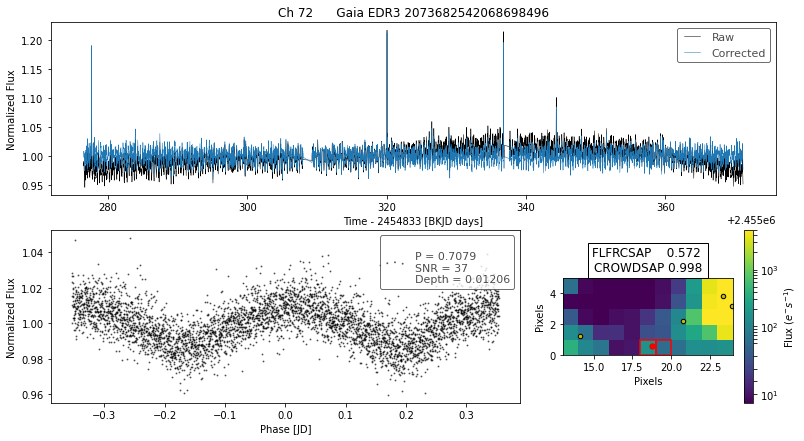

___________________________________________________
designation                Gaia EDR3 2073682606482850048
ra                                            297.627656
ra_error                                        0.100456
dec                                            40.239665
dec_error                                        0.11461
pmra                                           -0.376927
pmdec                                          -1.894851
parallax                                        0.184024
parallax_error                                  0.128249
phot_g_n_obs                                         389
phot_g_mean_flux                              739.329613
phot_g_mean_flux_error                          1.100877
phot_g_mean_mag                                18.515272
phot_bp_n_obs                                         43
phot_bp_mean_flux                             321.908148
phot_bp_mean_flux_error                         4.256342
phot_bp_mean_mag                    

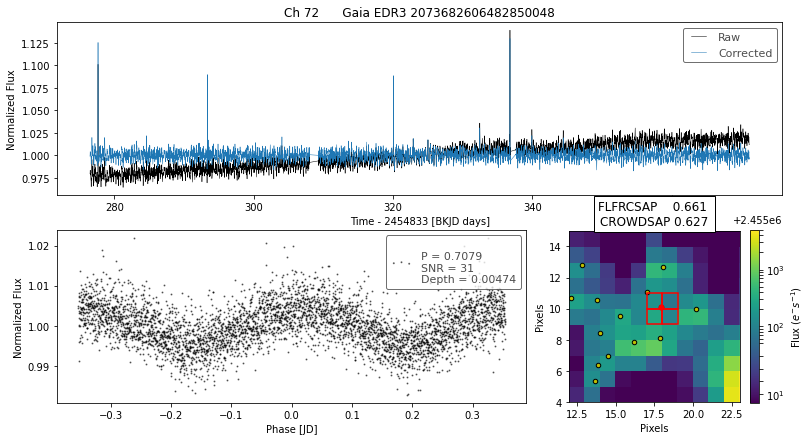

___________________________________________________
designation                Gaia EDR3 2073682438989499392
ra                                            297.651519
ra_error                                        0.022799
dec                                              40.2378
dec_error                                       0.026695
pmra                                           -2.477084
pmdec                                          -5.023764
parallax                                        0.300229
parallax_error                                  0.029183
phot_g_n_obs                                         381
phot_g_mean_flux                             8658.657305
phot_g_mean_flux_error                          2.986493
phot_g_mean_mag                                 15.84374
phot_bp_n_obs                                         46
phot_bp_mean_flux                            4054.347777
phot_bp_mean_flux_error                         8.764532
phot_bp_mean_mag                    

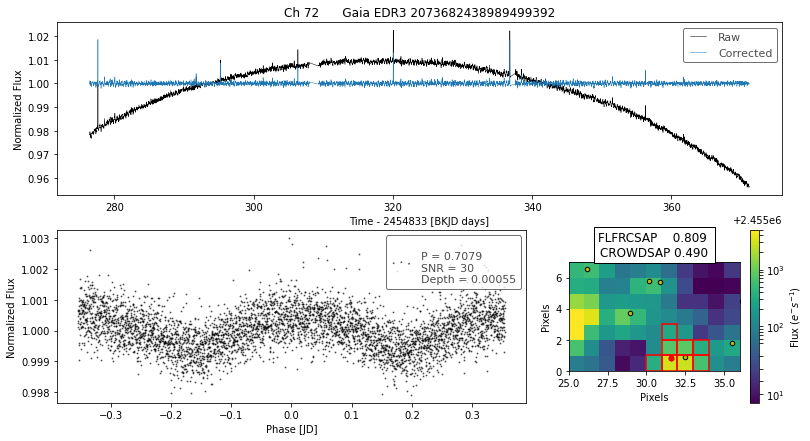

___________________________________________________
designation                Gaia EDR3 2073682469043897600
ra                                            297.655894
ra_error                                        0.117476
dec                                            40.240765
dec_error                                       0.134227
pmra                                           -1.665599
pmdec                                          -2.575447
parallax                                        0.115507
parallax_error                                  0.147817
phot_g_n_obs                                         390
phot_g_mean_flux                              765.917208
phot_g_mean_flux_error                          1.334251
phot_g_mean_mag                                18.476912
phot_bp_n_obs                                         48
phot_bp_mean_flux                             271.097207
phot_bp_mean_flux_error                         5.409967
phot_bp_mean_mag                    

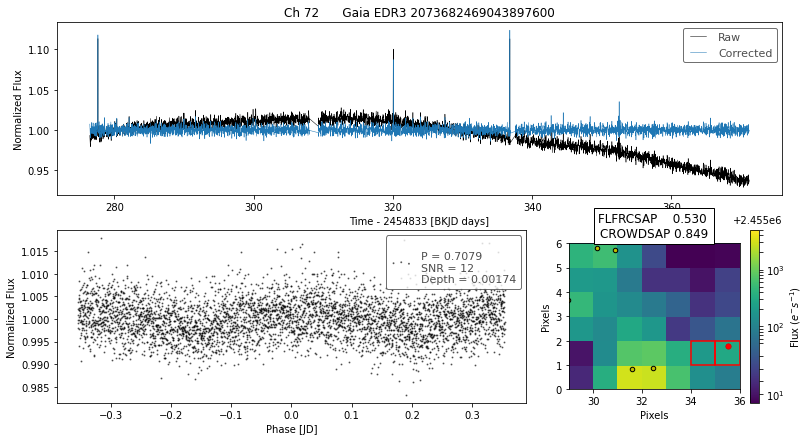

___________________________________________________
designation                Gaia EDR3 2075408088132432000
ra                                            298.295859
ra_error                                        0.030162
dec                                             41.80548
dec_error                                       0.035955
pmra                                           -1.450553
pmdec                                          -0.399245
parallax                                        0.479929
parallax_error                                  0.036832
phot_g_n_obs                                         376
phot_g_mean_flux                             5274.358069
phot_g_mean_flux_error                          2.492395
phot_g_mean_mag                                16.381943
phot_bp_n_obs                                         47
phot_bp_mean_flux                            2588.375321
phot_bp_mean_flux_error                         6.175026
phot_bp_mean_mag                    

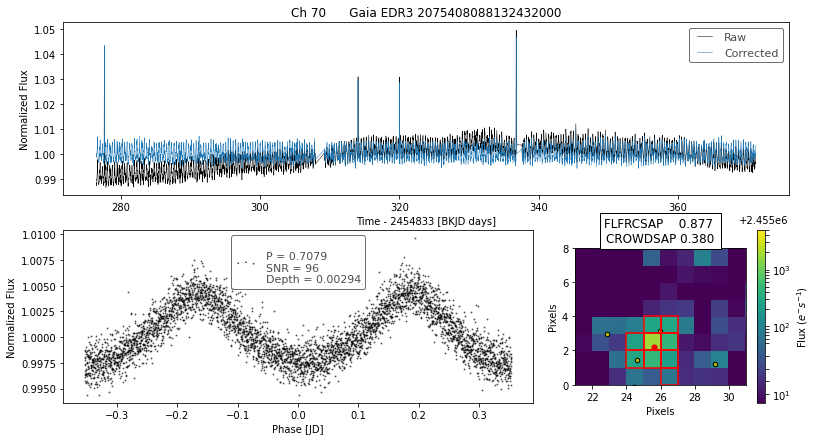

___________________________________________________
designation                Gaia EDR3 2073682537763365376
ra                                            297.628981
ra_error                                        0.043964
dec                                            40.237732
dec_error                                       0.048942
pmra                                           -1.498933
pmdec                                          -1.724225
parallax                                        0.040084
parallax_error                                  0.055266
phot_g_n_obs                                         390
phot_g_mean_flux                             2918.915191
phot_g_mean_flux_error                          1.979935
phot_g_mean_mag                                17.024313
phot_bp_n_obs                                         48
phot_bp_mean_flux                              901.08579
phot_bp_mean_flux_error                         6.511789
phot_bp_mean_mag                    

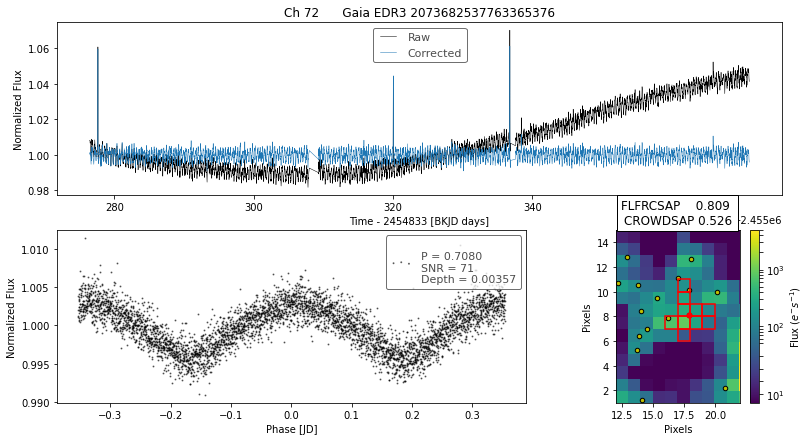

___________________________________________________
designation                Gaia EDR3 2073608462483627904
ra                                            299.010728
ra_error                                        0.043658
dec                                             40.78514
dec_error                                       0.041431
pmra                                            0.877809
pmdec                                          -0.261395
parallax                                        0.563022
parallax_error                                  0.051339
phot_g_n_obs                                         316
phot_g_mean_flux                            18920.929614
phot_g_mean_flux_error                         15.096578
phot_g_mean_mag                                 14.99501
phot_bp_n_obs                                         38
phot_bp_mean_flux                           13245.210461
phot_bp_mean_flux_error                        287.75543
phot_bp_mean_mag                    

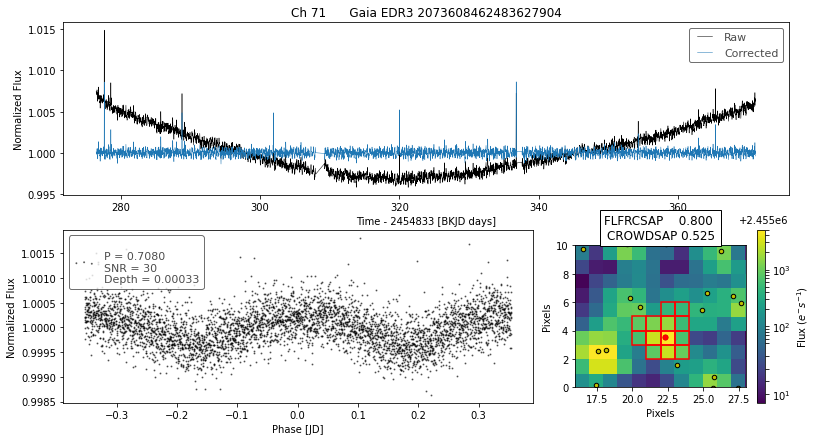

___________________________________________________
designation                Gaia EDR3 2073682645137576448
ra                                            297.640246
ra_error                                        0.275497
dec                                            40.246341
dec_error                                       0.300859
pmra                                           -1.409364
pmdec                                          -2.921175
parallax                                        0.223164
parallax_error                                  0.344056
phot_g_n_obs                                         344
phot_g_mean_flux                              201.499726
phot_g_mean_flux_error                          0.746988
phot_g_mean_mag                                19.926682
phot_bp_n_obs                                         36
phot_bp_mean_flux                              82.843667
phot_bp_mean_flux_error                         6.399987
phot_bp_mean_mag                    

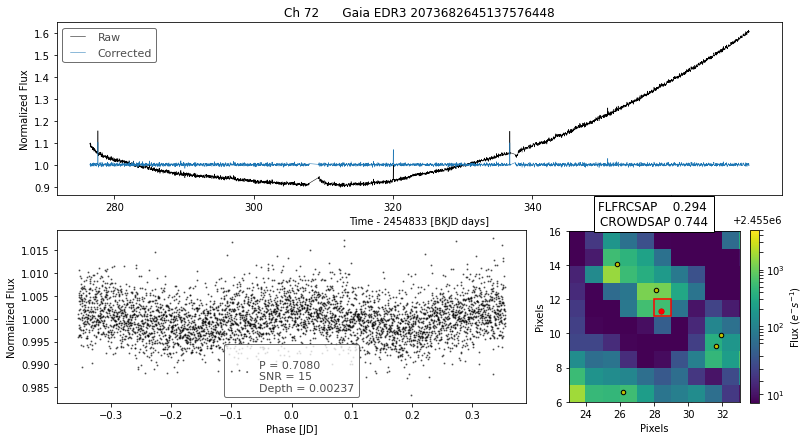

___________________________________________________
designation                Gaia EDR3 2073682537763329920
ra                                            297.622116
ra_error                                        0.173175
dec                                            40.227523
dec_error                                       0.191623
pmra                                           -2.512365
pmdec                                          -3.781634
parallax                                       -0.196781
parallax_error                                  0.225101
phot_g_n_obs                                         381
phot_g_mean_flux                              364.177025
phot_g_mean_flux_error                           0.96748
phot_g_mean_mag                                19.284086
phot_bp_n_obs                                         45
phot_bp_mean_flux                              155.62338
phot_bp_mean_flux_error                         4.938113
phot_bp_mean_mag                    

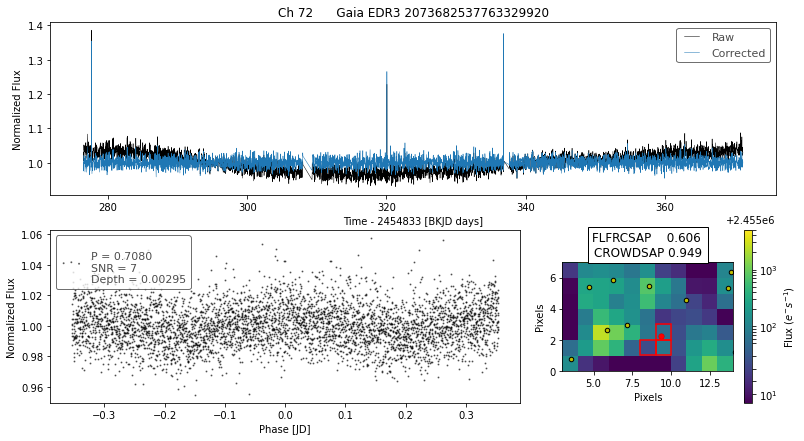

___________________________________________________
designation                Gaia EDR3 2073682645137588992
ra                                            297.647245
ra_error                                        0.134736
dec                                            40.242187
dec_error                                       0.158103
pmra                                           -0.780127
pmdec                                          -6.368555
parallax                                        0.193988
parallax_error                                  0.174612
phot_g_n_obs                                         388
phot_g_mean_flux                              485.568412
phot_g_mean_flux_error                          1.033113
phot_g_mean_mag                                 18.97174
phot_bp_n_obs                                         15
phot_bp_mean_flux                             196.906376
phot_bp_mean_flux_error                         8.218881
phot_bp_mean_mag                    

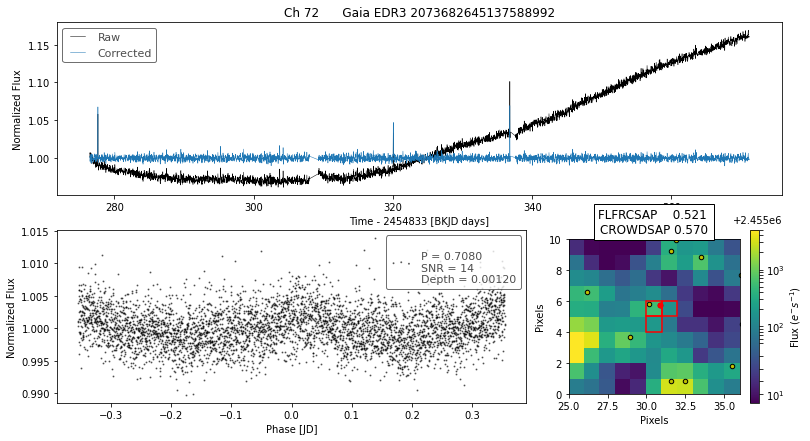

___________________________________________________
designation                Gaia EDR3 2073682709562118656
ra                                            297.626561
ra_error                                        0.279511
dec                                            40.255103
dec_error                                        0.31045
pmra                                           -2.624508
pmdec                                          -2.766912
parallax                                       -0.189933
parallax_error                                  0.350096
phot_g_n_obs                                         371
phot_g_mean_flux                              197.529304
phot_g_mean_flux_error                          0.763757
phot_g_mean_mag                                19.948288
phot_bp_n_obs                                         44
phot_bp_mean_flux                              84.328718
phot_bp_mean_flux_error                         5.218186
phot_bp_mean_mag                    

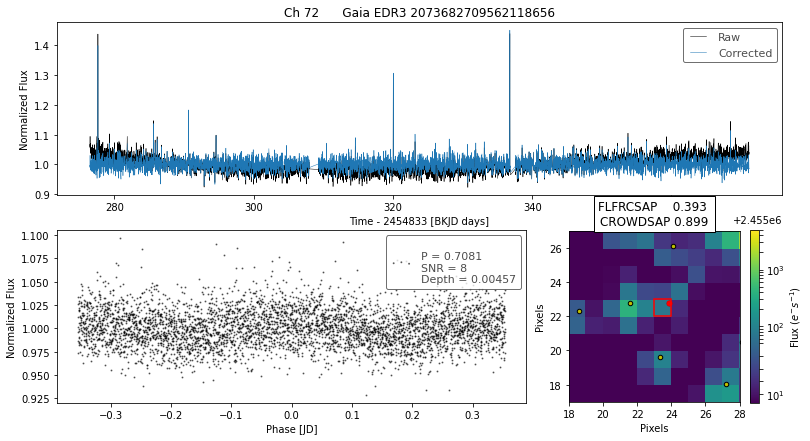

___________________________________________________
designation                Gaia EDR3 2073682645147926016
ra                                            297.638987
ra_error                                        0.026282
dec                                            40.247393
dec_error                                       0.028942
pmra                                           -0.909351
pmdec                                          -1.180338
parallax                                        0.353969
parallax_error                                  0.032228
phot_g_n_obs                                         393
phot_g_mean_flux                             7081.034725
phot_g_mean_flux_error                          2.965667
phot_g_mean_mag                                16.062124
phot_bp_n_obs                                         48
phot_bp_mean_flux                            2636.505869
phot_bp_mean_flux_error                         9.195895
phot_bp_mean_mag                    

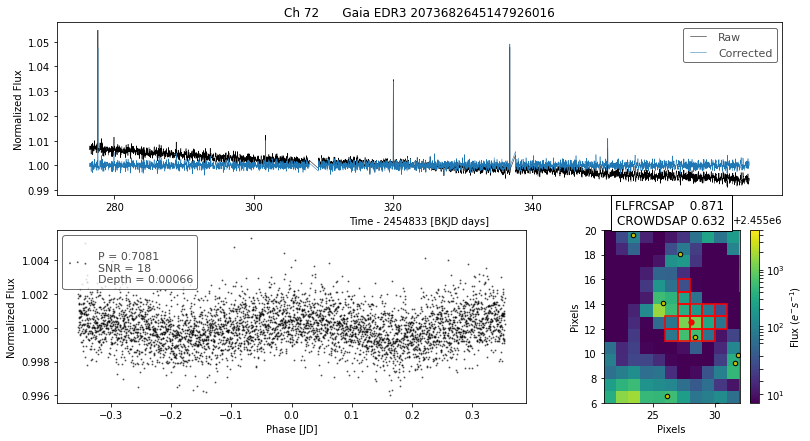

___________________________________________________
designation                Gaia EDR3 2073682610788175360
ra                                            297.626113
ra_error                                        0.168753
dec                                            40.242249
dec_error                                       0.187192
pmra                                          -21.716942
pmdec                                         -15.350632
parallax                                        4.957048
parallax_error                                    0.2101
phot_g_n_obs                                         393
phot_g_mean_flux                             2304.180284
phot_g_mean_flux_error                         10.792838
phot_g_mean_mag                                17.281076
phot_bp_n_obs                                         45
phot_bp_mean_flux                             383.349015
phot_bp_mean_flux_error                         5.590925
phot_bp_mean_mag                    

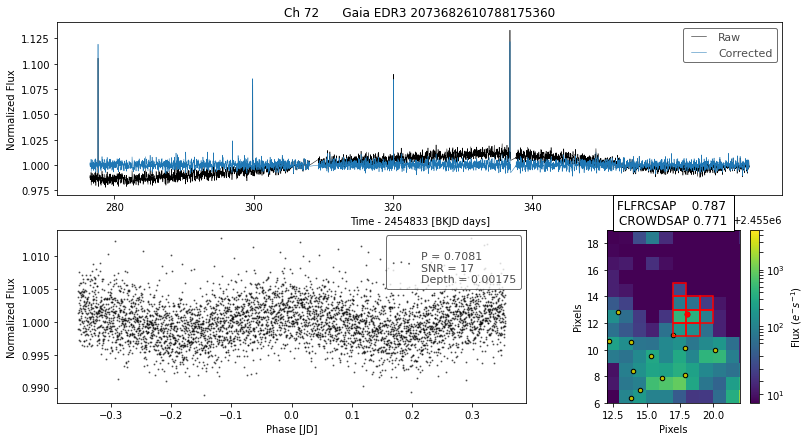

___________________________________________________
designation                Gaia EDR3 2073682709562105856
ra                                            297.628098
ra_error                                        0.149081
dec                                            40.251744
dec_error                                       0.166648
pmra                                           -3.834076
pmdec                                          -6.343166
parallax                                        0.159942
parallax_error                                  0.188703
phot_g_n_obs                                         373
phot_g_mean_flux                              431.994979
phot_g_mean_flux_error                          0.922726
phot_g_mean_mag                                19.098671
phot_bp_n_obs                                         44
phot_bp_mean_flux                             169.236897
phot_bp_mean_flux_error                         3.816325
phot_bp_mean_mag                    

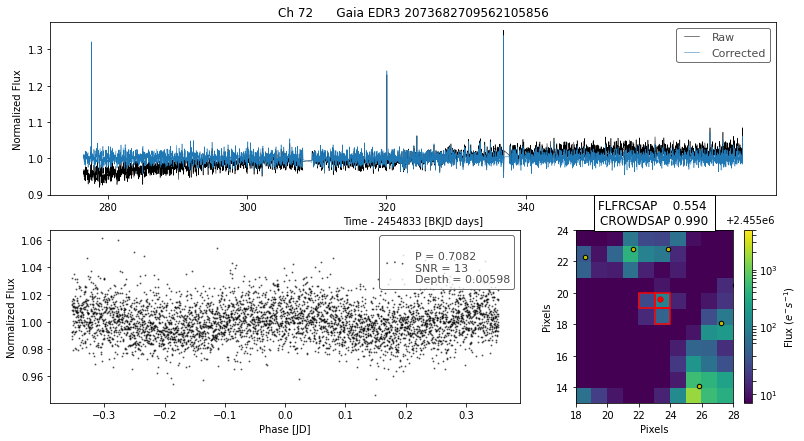

___________________________________________________
designation                Gaia EDR3 2073682606482842240
ra                                             297.62475
ra_error                                        0.080133
dec                                            40.237738
dec_error                                       0.090007
pmra                                            -2.44806
pmdec                                          -2.944596
parallax                                        0.054887
parallax_error                                  0.102045
phot_g_n_obs                                         407
phot_g_mean_flux                             1024.404204
phot_g_mean_flux_error                          1.149827
phot_g_mean_mag                                18.161188
phot_bp_n_obs                                         46
phot_bp_mean_flux                             409.756272
phot_bp_mean_flux_error                          6.00412
phot_bp_mean_mag                    

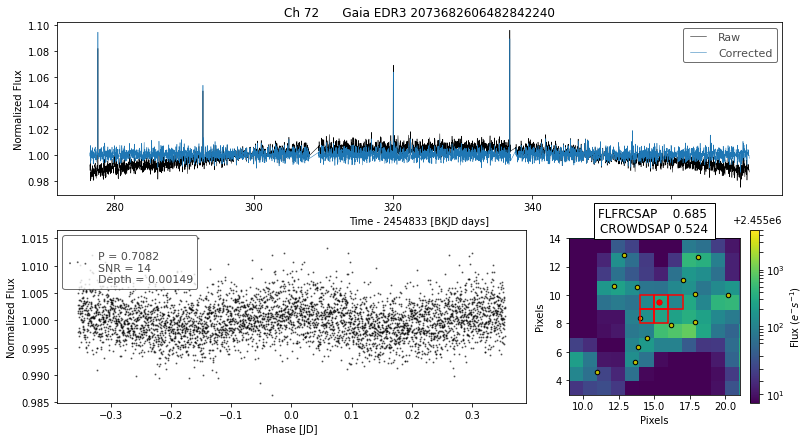

___________________________________________________
designation                Gaia EDR3 2080297753765434496
ra                                            297.416558
ra_error                                        0.077305
dec                                            46.626683
dec_error                                       0.075891
pmra                                           -2.327354
pmdec                                          -8.656441
parallax                                        0.159834
parallax_error                                  0.086219
phot_g_n_obs                                         360
phot_g_mean_flux                             1161.445103
phot_g_mean_flux_error                          1.284479
phot_g_mean_mag                                 18.02487
phot_bp_n_obs                                         41
phot_bp_mean_flux                             517.642597
phot_bp_mean_flux_error                         7.609371
phot_bp_mean_mag                    

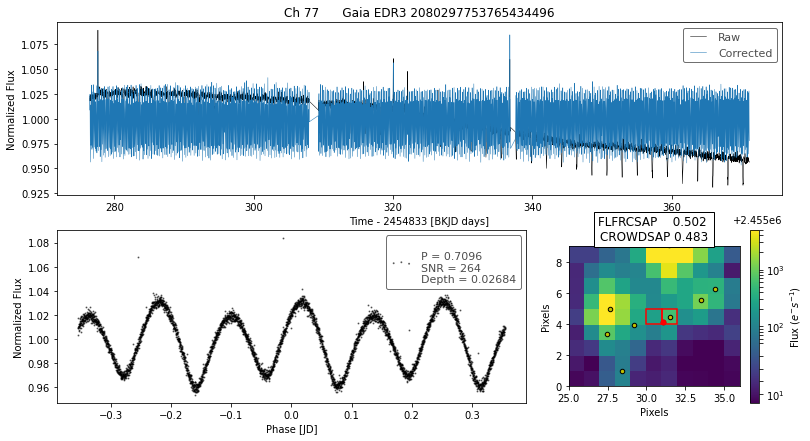

___________________________________________________
designation                Gaia EDR3 2080297753770788864
ra                                            297.416181
ra_error                                        0.049023
dec                                             46.62538
dec_error                                       0.050086
pmra                                            3.843415
pmdec                                         -10.556638
parallax                                        0.599422
parallax_error                                  0.055495
phot_g_n_obs                                         374
phot_g_mean_flux                             2382.390459
phot_g_mean_flux_error                         11.414193
phot_g_mean_mag                                17.244835
phot_bp_n_obs                                         44
phot_bp_mean_flux                             935.310224
phot_bp_mean_flux_error                        24.087175
phot_bp_mean_mag                    

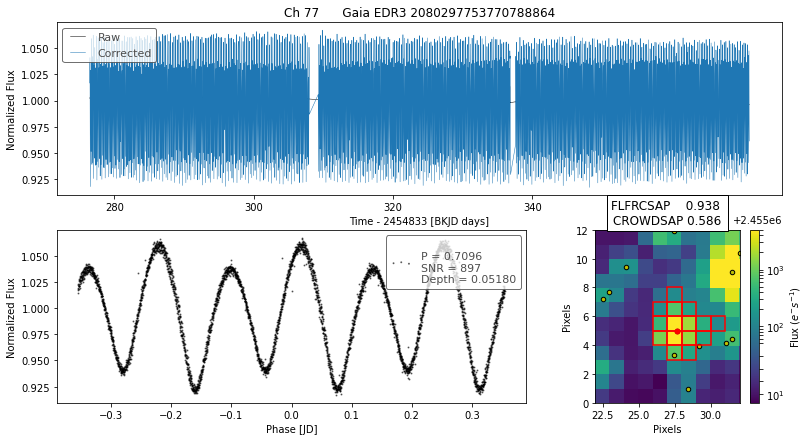

___________________________________________________
designation                Gaia EDR3 2077708850561344640
ra                                            293.824975
ra_error                                        0.061219
dec                                            41.915389
dec_error                                       0.075247
pmra                                           -1.817239
pmdec                                          -2.717907
parallax                                        0.172253
parallax_error                                  0.080094
phot_g_n_obs                                         308
phot_g_mean_flux                             2117.648124
phot_g_mean_flux_error                          2.069187
phot_g_mean_mag                                17.372732
phot_bp_n_obs                                         32
phot_bp_mean_flux                            1050.108044
phot_bp_mean_flux_error                        25.819563
phot_bp_mean_mag                    

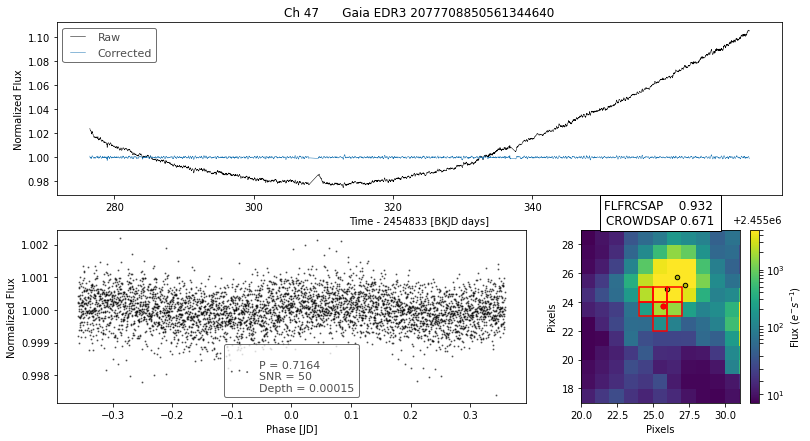

___________________________________________________
designation                Gaia EDR3 2077708846259791616
ra                                            293.823701
ra_error                                        0.009192
dec                                            41.916408
dec_error                                       0.011856
pmra                                           -1.033747
pmdec                                         -10.805417
parallax                                        0.455476
parallax_error                                  0.012744
phot_g_n_obs                                         308
phot_g_mean_flux                           175380.454985
phot_g_mean_flux_error                          28.22225
phot_g_mean_mag                                12.577414
phot_bp_n_obs                                         36
phot_bp_mean_flux                           74365.229462
phot_bp_mean_flux_error                        56.402645
phot_bp_mean_mag                    

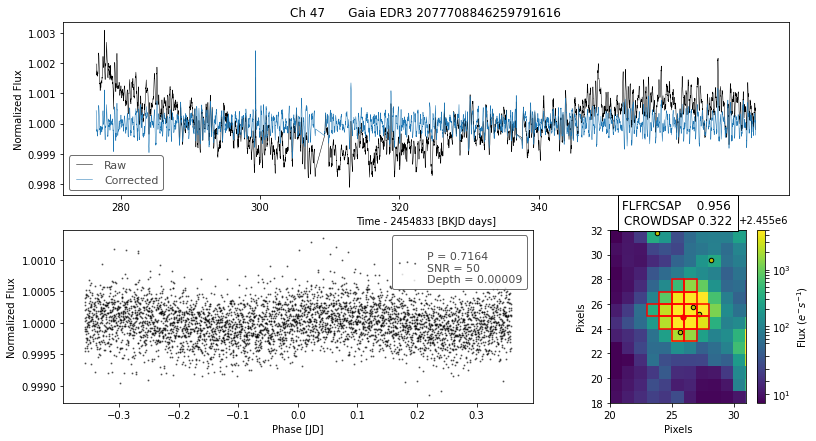

___________________________________________________
designation                Gaia EDR3 2077709056721167360
ra                                            293.822138
ra_error                                        0.010294
dec                                            41.916739
dec_error                                       0.012163
pmra                                             -3.1956
pmdec                                          -5.011226
parallax                                        0.972662
parallax_error                                  0.013193
phot_g_n_obs                                         312
phot_g_mean_flux                           154472.574393
phot_g_mean_flux_error                         31.080362
phot_g_mean_mag                                12.715239
phot_bp_n_obs                                         33
phot_bp_mean_flux                           87703.130283
phot_bp_mean_flux_error                        51.497868
phot_bp_mean_mag                    

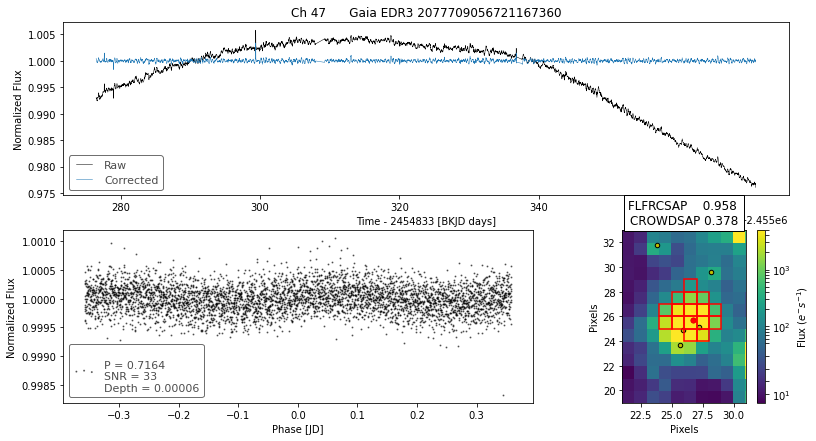

___________________________________________________
designation                Gaia EDR3 2079398830002411648
ra                                            298.560962
ra_error                                        0.143367
dec                                            45.146545
dec_error                                       0.141618
pmra                                            -2.71452
pmdec                                           -4.37318
parallax                                        0.020243
parallax_error                                  0.162409
phot_g_n_obs                                         341
phot_g_mean_flux                              481.328096
phot_g_mean_flux_error                          0.994502
phot_g_mean_mag                                18.981264
phot_bp_n_obs                                         38
phot_bp_mean_flux                             187.063221
phot_bp_mean_flux_error                         5.721185
phot_bp_mean_mag                    

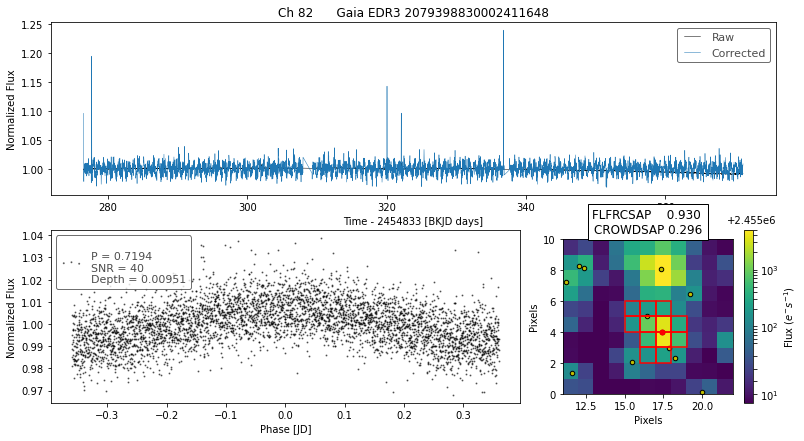

___________________________________________________
designation                Gaia EDR3 2079398903014925440
ra                                            298.523768
ra_error                                        0.229965
dec                                            45.146853
dec_error                                         0.2485
pmra                                           -1.032897
pmdec                                          -7.441999
parallax                                        0.948007
parallax_error                                  0.274288
phot_g_n_obs                                         361
phot_g_mean_flux                              336.768322
phot_g_mean_flux_error                          1.566763
phot_g_mean_mag                                 19.36904
phot_bp_n_obs                                         37
phot_bp_mean_flux                             120.093388
phot_bp_mean_flux_error                         5.448634
phot_bp_mean_mag                    

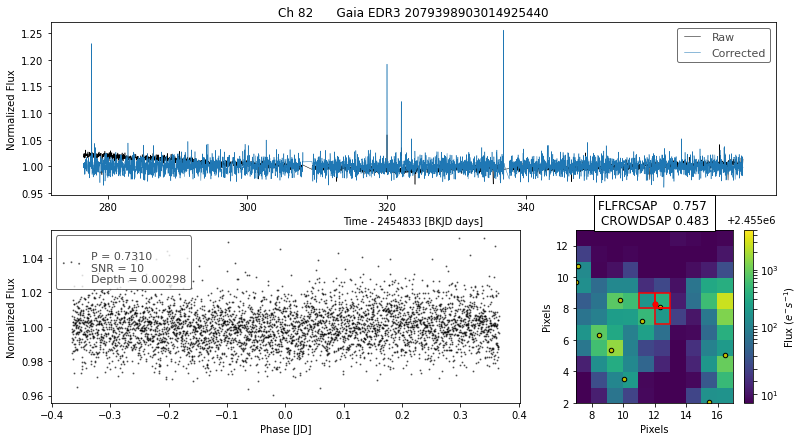

___________________________________________________
designation                Gaia EDR3 2073608423810301824
ra                                            298.996593
ra_error                                        0.048153
dec                                            40.780773
dec_error                                       0.055365
pmra                                           -1.608119
pmdec                                           -4.23704
parallax                                        0.286764
parallax_error                                   0.06253
phot_g_n_obs                                         348
phot_g_mean_flux                              2435.44883
phot_g_mean_flux_error                          1.679276
phot_g_mean_mag                                17.220919
phot_bp_n_obs                                         41
phot_bp_mean_flux                            1179.667641
phot_bp_mean_flux_error                         7.701368
phot_bp_mean_mag                    

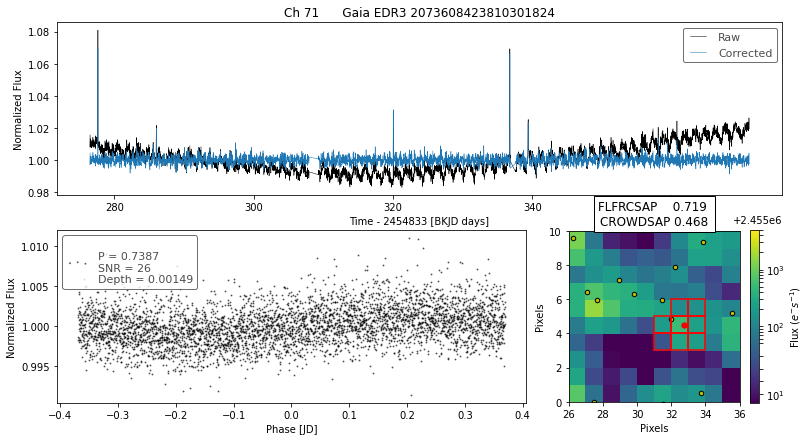

___________________________________________________
designation                Gaia EDR3 2073608428118285440
ra                                            298.997363
ra_error                                        0.160777
dec                                            40.781527
dec_error                                        0.18453
pmra                                           -1.489999
pmdec                                           1.459071
parallax                                        0.845398
parallax_error                                  0.203107
phot_g_n_obs                                         355
phot_g_mean_flux                              370.471759
phot_g_mean_flux_error                          1.070249
phot_g_mean_mag                                 19.26548
phot_bp_n_obs                                         27
phot_bp_mean_flux                             123.708357
phot_bp_mean_flux_error                         7.044592
phot_bp_mean_mag                    

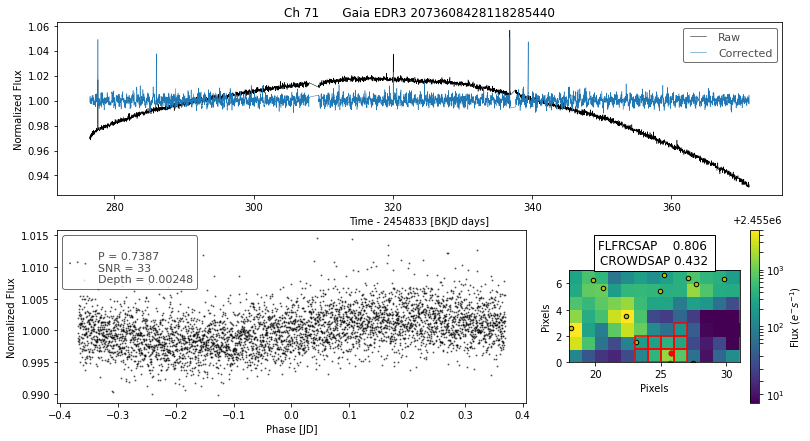

___________________________________________________
designation                Gaia EDR3 2087226803027587072
ra                                             296.91065
ra_error                                        0.013523
dec                                            49.668638
dec_error                                       0.014755
pmra                                           -2.803198
pmdec                                         -10.341458
parallax                                        0.430208
parallax_error                                  0.015854
phot_g_n_obs                                         372
phot_g_mean_flux                           248820.391182
phot_g_mean_flux_error                          37.64555
phot_g_mean_mag                                12.197652
phot_bp_n_obs                                         42
phot_bp_mean_flux                          107548.987357
phot_bp_mean_flux_error                         67.11217
phot_bp_mean_mag                    

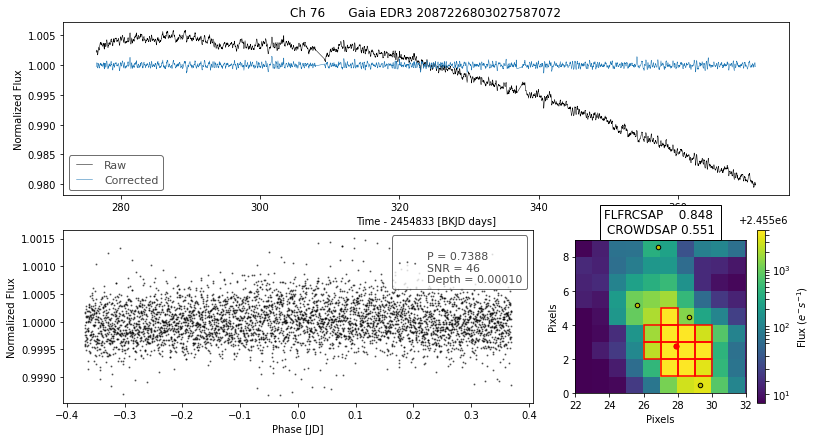

___________________________________________________
designation                Gaia EDR3 2073608423810304000
ra                                            298.997229
ra_error                                        0.100572
dec                                            40.782878
dec_error                                       0.112672
pmra                                           -4.908252
pmdec                                          -6.545357
parallax                                        0.196307
parallax_error                                  0.125855
phot_g_n_obs                                         363
phot_g_mean_flux                              725.240513
phot_g_mean_flux_error                          1.065749
phot_g_mean_mag                                18.536161
phot_bp_n_obs                                         40
phot_bp_mean_flux                             323.280161
phot_bp_mean_flux_error                         5.712946
phot_bp_mean_mag                    

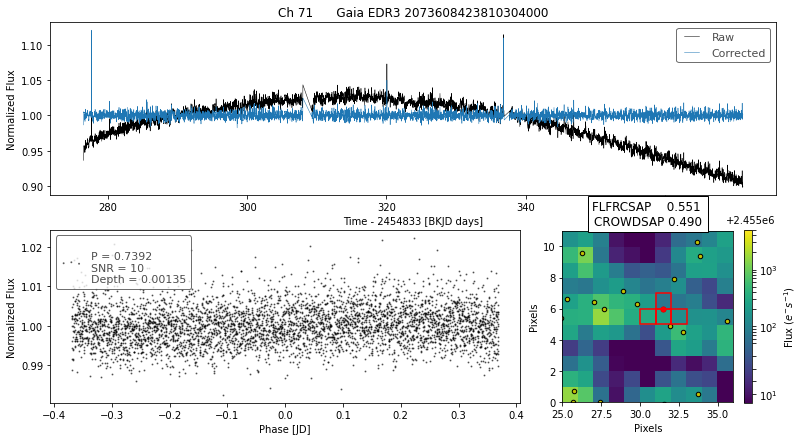

___________________________________________________
designation                Gaia EDR3 2102901513810877696
ra                                            288.489552
ra_error                                        0.010685
dec                                            42.753246
dec_error                                       0.011613
pmra                                           -3.438126
pmdec                                          -8.843462
parallax                                        0.225101
parallax_error                                  0.012103
phot_g_n_obs                                         402
phot_g_mean_flux                             45103.65103
phot_g_mean_flux_error                          6.579156
phot_g_mean_mag                                14.051838
phot_bp_n_obs                                         47
phot_bp_mean_flux                           19133.959979
phot_bp_mean_flux_error                        27.212856
phot_bp_mean_mag                    

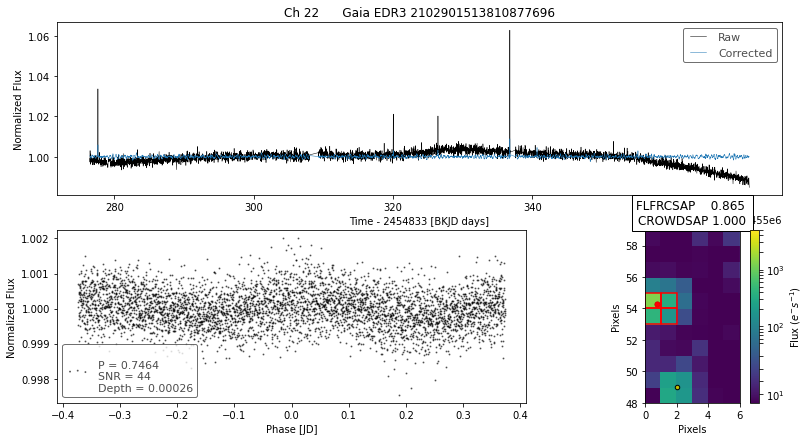

___________________________________________________
designation                Gaia EDR3 2102901513805608704
ra                                            288.489105
ra_error                                        0.092024
dec                                            42.753696
dec_error                                       0.103673
pmra                                           -4.469008
pmdec                                          -7.367453
parallax                                        0.767073
parallax_error                                  0.100267
phot_g_n_obs                                         270
phot_g_mean_flux                             1248.638682
phot_g_mean_flux_error                          2.059671
phot_g_mean_mag                                17.946276
phot_bp_n_obs                                          0
phot_bp_mean_flux                100000000000000000000.0
phot_bp_mean_flux_error          100000000000000000000.0
phot_bp_mean_mag                 100

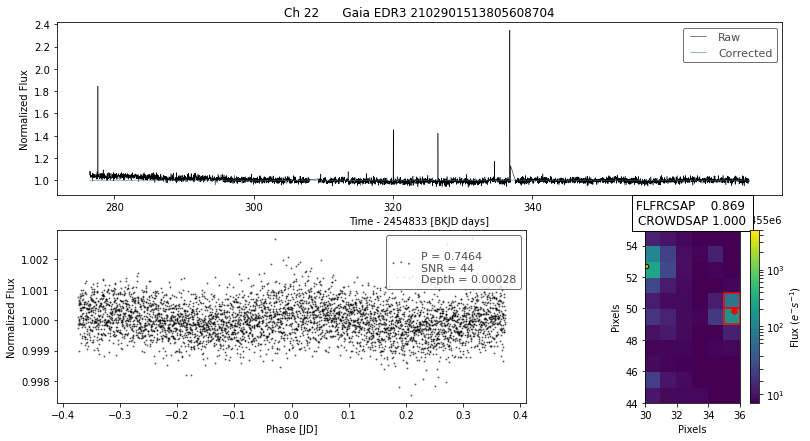

___________________________________________________
designation                Gaia EDR3 2143714934457116928
ra                                            282.720435
ra_error                                        0.009462
dec                                            48.258944
dec_error                                       0.009433
pmra                                            2.228803
pmdec                                          -2.826559
parallax                                        0.505625
parallax_error                                  0.009874
phot_g_n_obs                                         320
phot_g_mean_flux                           217286.831657
phot_g_mean_flux_error                         32.753975
phot_g_mean_mag                                12.344784
phot_bp_n_obs                                         38
phot_bp_mean_flux                           86877.260807
phot_bp_mean_flux_error                         53.69385
phot_bp_mean_mag                    

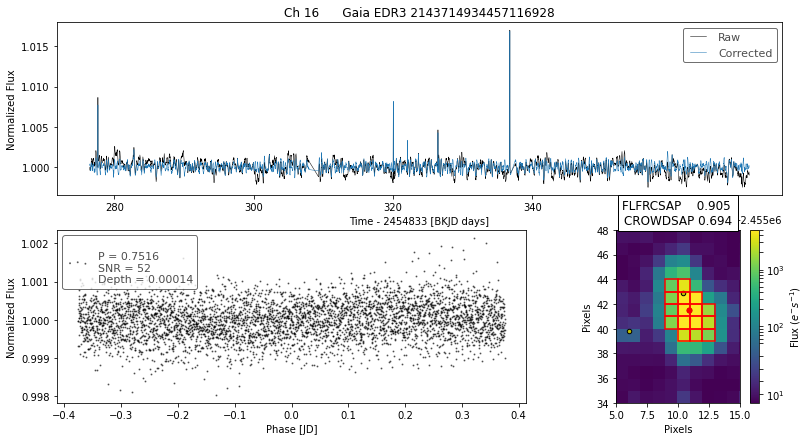

___________________________________________________
designation                Gaia EDR3 2101136419694168320
ra                                            290.650615
ra_error                                        0.027138
dec                                            40.402914
dec_error                                        0.02776
pmra                                           -3.157111
pmdec                                          -5.873823
parallax                                        0.116814
parallax_error                                  0.031374
phot_g_n_obs                                         397
phot_g_mean_flux                             6878.999911
phot_g_mean_flux_error                          2.801253
phot_g_mean_mag                                16.093554
phot_bp_n_obs                                         44
phot_bp_mean_flux                            2871.248976
phot_bp_mean_flux_error                         9.465172
phot_bp_mean_mag                    

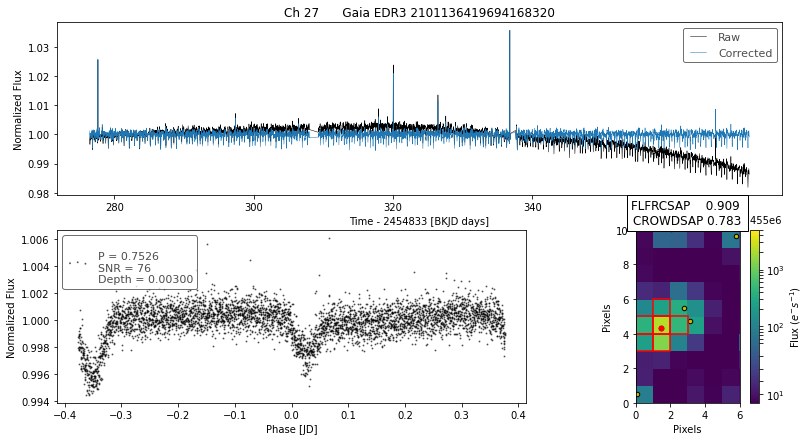

___________________________________________________
designation                Gaia EDR3 2101136419694167040
ra                                            290.648045
ra_error                                        0.112048
dec                                            40.403228
dec_error                                       0.110802
pmra                                           -1.929957
pmdec                                          -3.047022
parallax                                        0.795976
parallax_error                                  0.128643
phot_g_n_obs                                         382
phot_g_mean_flux                              645.300761
phot_g_mean_flux_error                          1.908764
phot_g_mean_mag                                18.662962
phot_bp_n_obs                                         38
phot_bp_mean_flux                             163.886965
phot_bp_mean_flux_error                         8.030206
phot_bp_mean_mag                    

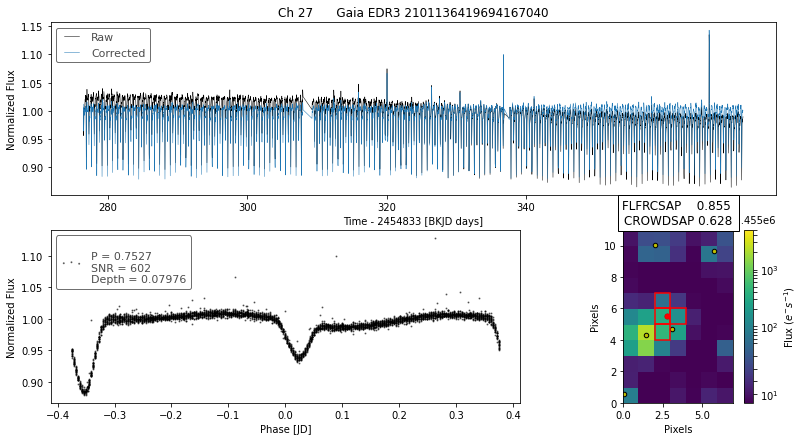

___________________________________________________
designation                Gaia EDR3 2101136415390982528
ra                                            290.648252
ra_error                                        0.118974
dec                                            40.402277
dec_error                                       0.120312
pmra                                           -2.312777
pmdec                                          -1.383678
parallax                                        0.154849
parallax_error                                  0.135582
phot_g_n_obs                                         365
phot_g_mean_flux                                608.5395
phot_g_mean_flux_error                          1.045084
phot_g_mean_mag                                18.726645
phot_bp_n_obs                                         29
phot_bp_mean_flux                             308.236488
phot_bp_mean_flux_error                         5.960296
phot_bp_mean_mag                    

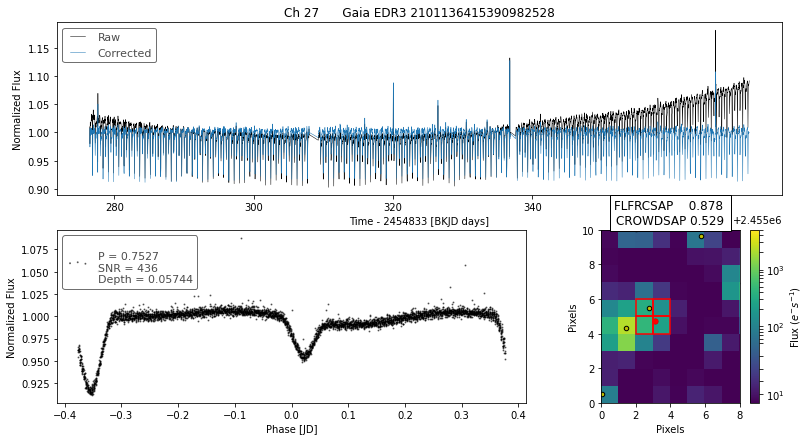

___________________________________________________
designation                Gaia EDR3 2126835511126495360
ra                                            290.361082
ra_error                                        0.010216
dec                                            43.742636
dec_error                                       0.010169
pmra                                           -1.943102
pmdec                                           -4.03239
parallax                                        0.286732
parallax_error                                  0.011323
phot_g_n_obs                                         371
phot_g_mean_flux                           450540.424384
phot_g_mean_flux_error                         137.48225
phot_g_mean_mag                                11.553033
phot_bp_n_obs                                         42
phot_bp_mean_flux                          134526.595622
phot_bp_mean_flux_error                        168.68417
phot_bp_mean_mag                    

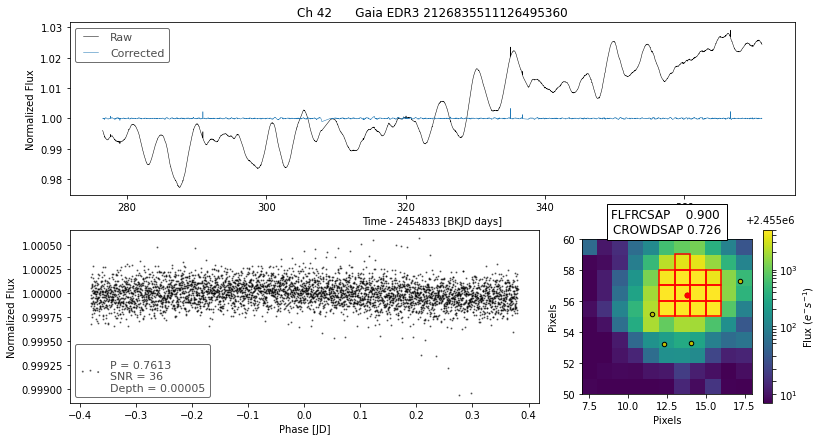

___________________________________________________
designation                Gaia EDR3 2077709056713367040
ra                                            293.821897
ra_error                                        0.202079
dec                                            41.915894
dec_error                                       0.215645
pmra                                           -3.134347
pmdec                                          -5.444482
parallax                                        1.188456
parallax_error                                  0.251093
phot_g_n_obs                                         225
phot_g_mean_flux                              773.806219
phot_g_mean_flux_error                           3.19371
phot_g_mean_mag                                18.465786
phot_bp_n_obs                                         10
phot_bp_mean_flux                             995.812068
phot_bp_mean_flux_error                         79.68739
phot_bp_mean_mag                    

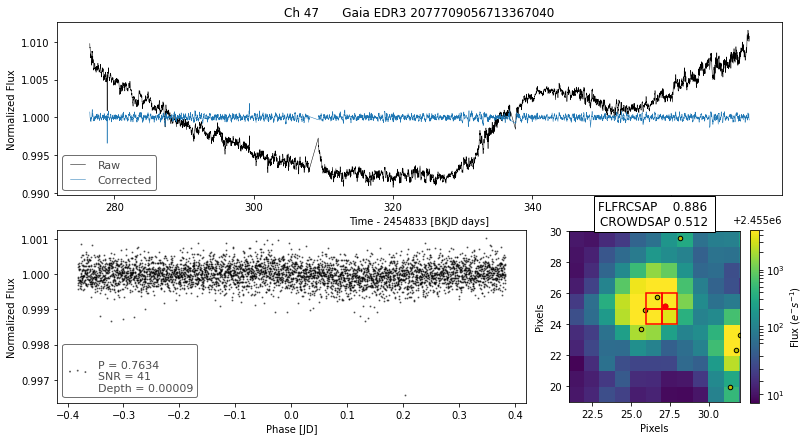

___________________________________________________
designation                Gaia EDR3 2077240935349174784
ra                                            295.867983
ra_error                                        0.168499
dec                                            42.750655
dec_error                                       0.182355
pmra                                            4.448709
pmdec                                           3.747565
parallax                                        1.601779
parallax_error                                  0.200661
phot_g_n_obs                                         350
phot_g_mean_flux                              474.919755
phot_g_mean_flux_error                          1.190845
phot_g_mean_mag                                18.995817
phot_bp_n_obs                                         40
phot_bp_mean_flux                              97.198095
phot_bp_mean_flux_error                         5.555657
phot_bp_mean_mag                    

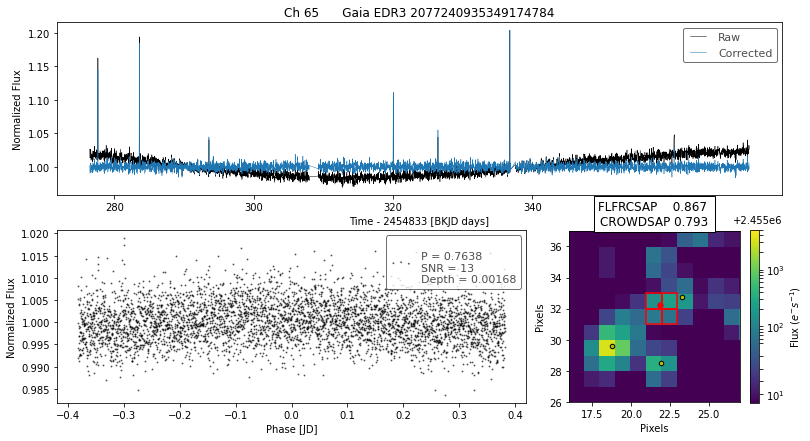

___________________________________________________
designation                Gaia EDR3 2052524364932148096
ra                                            291.287606
ra_error                                        0.012207
dec                                            37.382275
dec_error                                       0.013919
pmra                                            0.529787
pmdec                                          -6.269075
parallax                                        0.384613
parallax_error                                  0.015141
phot_g_n_obs                                         384
phot_g_mean_flux                           116473.250439
phot_g_mean_flux_error                         19.232346
phot_g_mean_mag                                13.021801
phot_bp_n_obs                                         45
phot_bp_mean_flux                           46438.442209
phot_bp_mean_flux_error                        25.805685
phot_bp_mean_mag                    

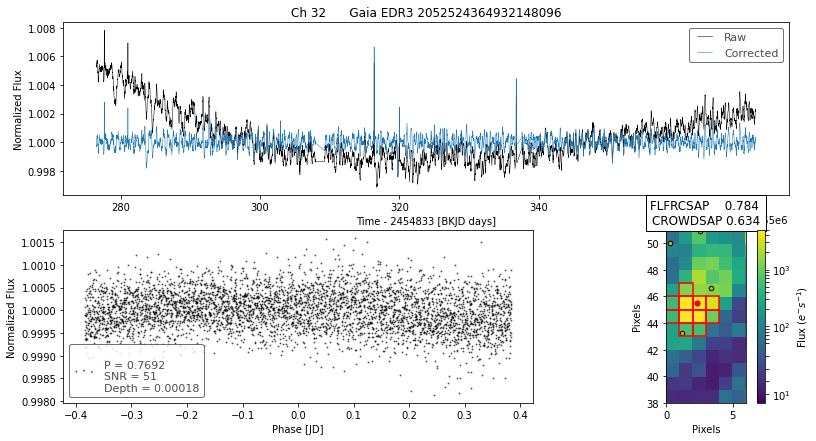

___________________________________________________
designation                Gaia EDR3 2077240218095539840
ra                                            295.884765
ra_error                                        0.018181
dec                                            42.741072
dec_error                                       0.017819
pmra                                           -0.322359
pmdec                                          -8.466712
parallax                                        0.606035
parallax_error                                  0.020188
phot_g_n_obs                                         362
phot_g_mean_flux                           228500.164338
phot_g_mean_flux_error                         30.650284
phot_g_mean_mag                                12.290151
phot_bp_n_obs                                         43
phot_bp_mean_flux                           92554.000273
phot_bp_mean_flux_error                        62.122032
phot_bp_mean_mag                    

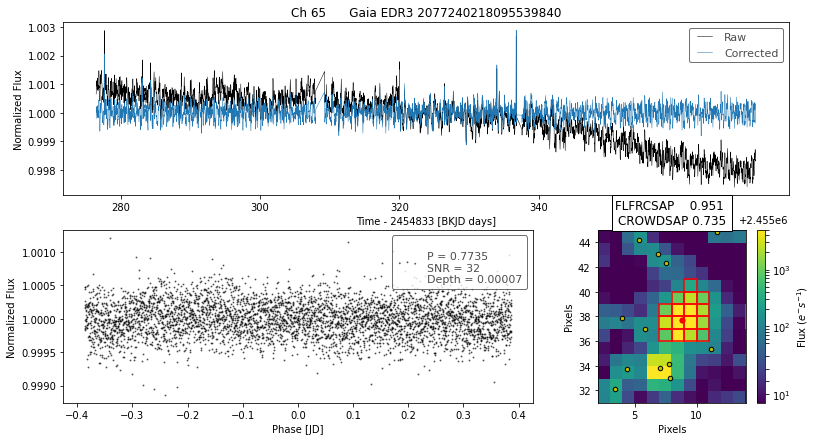

___________________________________________________
designation                Gaia EDR3 2105552608144587008
ra                                            286.304505
ra_error                                        0.009308
dec                                            43.036673
dec_error                                       0.010325
pmra                                           -7.815675
pmdec                                           9.117754
parallax                                        1.122798
parallax_error                                  0.010738
phot_g_n_obs                                         381
phot_g_mean_flux                           629549.131782
phot_g_mean_flux_error                          93.91126
phot_g_mean_mag                                11.189793
phot_bp_n_obs                                         44
phot_bp_mean_flux                          265488.876881
phot_bp_mean_flux_error                        134.49841
phot_bp_mean_mag                    

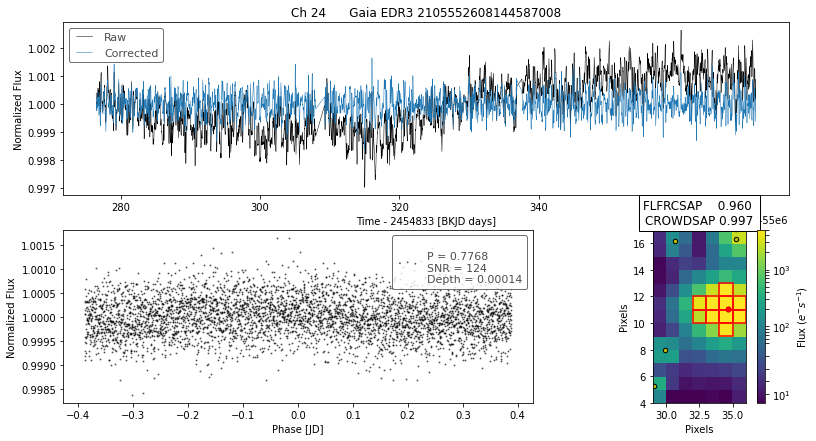

___________________________________________________
designation                Gaia EDR3 2079018987390162688
ra                                            299.379882
ra_error                                        0.016531
dec                                            44.093093
dec_error                                       0.017288
pmra                                           -1.543957
pmdec                                          -3.951352
parallax                                         0.17311
parallax_error                                  0.018578
phot_g_n_obs                                         368
phot_g_mean_flux                             23268.56433
phot_g_mean_flux_error                           7.34864
phot_g_mean_mag                                14.770443
phot_bp_n_obs                                         40
phot_bp_mean_flux                            6354.485206
phot_bp_mean_flux_error                        10.564076
phot_bp_mean_mag                    

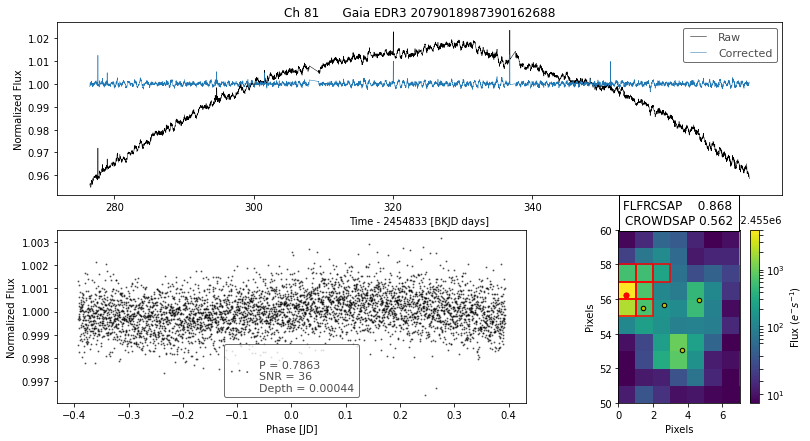

___________________________________________________
designation                Gaia EDR3 2079018987381462784
ra                                            299.378059
ra_error                                        0.103856
dec                                             44.09371
dec_error                                       0.114817
pmra                                           -3.145082
pmdec                                          -6.006518
parallax                                        0.070146
parallax_error                                  0.122889
phot_g_n_obs                                         348
phot_g_mean_flux                              846.880517
phot_g_mean_flux_error                          1.253539
phot_g_mean_mag                                18.367811
phot_bp_n_obs                                         37
phot_bp_mean_flux                             345.482382
phot_bp_mean_flux_error                         7.482508
phot_bp_mean_mag                    

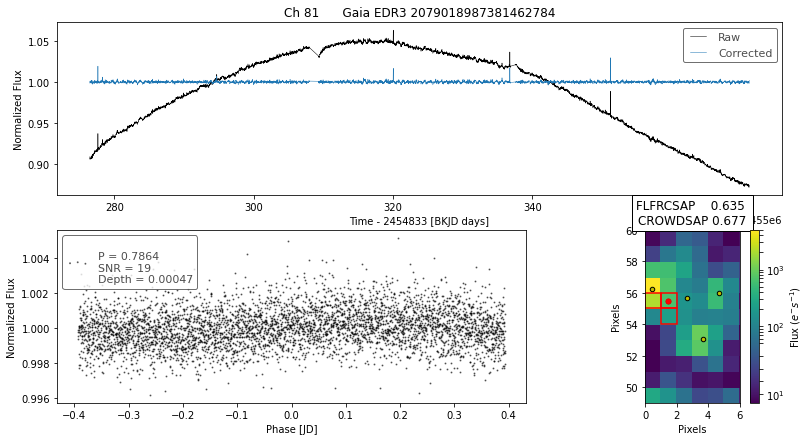

___________________________________________________
designation                Gaia EDR3 2073682572123087744
ra                                            297.606864
ra_error                                        0.133006
dec                                            40.233154
dec_error                                       0.148268
pmra                                           -3.082405
pmdec                                          -5.302599
parallax                                        0.042601
parallax_error                                  0.168017
phot_g_n_obs                                         400
phot_g_mean_flux                              486.518882
phot_g_mean_flux_error                          0.978407
phot_g_mean_mag                                18.969618
phot_bp_n_obs                                         43
phot_bp_mean_flux                             190.901102
phot_bp_mean_flux_error                         5.630286
phot_bp_mean_mag                    

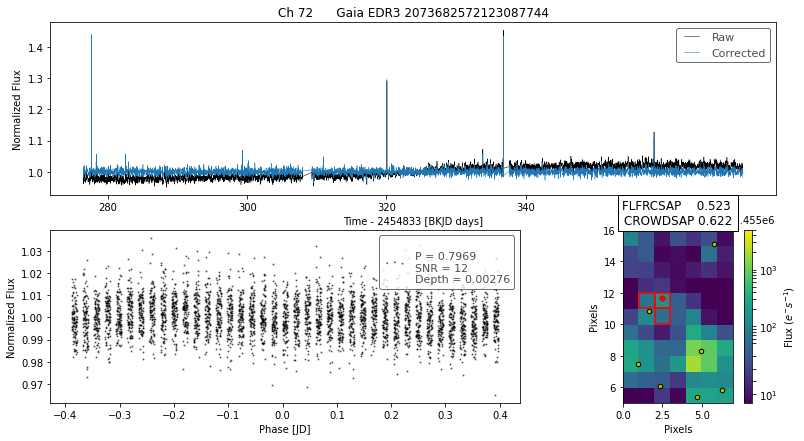

___________________________________________________
designation                Gaia EDR3 2052809378952173696
ra                                            290.587904
ra_error                                        0.107771
dec                                            38.300358
dec_error                                        0.12509
pmra                                             5.89611
pmdec                                           5.027176
parallax                                        1.230026
parallax_error                                  0.137362
phot_g_n_obs                                         369
phot_g_mean_flux                              720.781014
phot_g_mean_flux_error                          1.424255
phot_g_mean_mag                                18.542858
phot_bp_n_obs                                         46
phot_bp_mean_flux                             124.550414
phot_bp_mean_flux_error                         7.492254
phot_bp_mean_mag                    

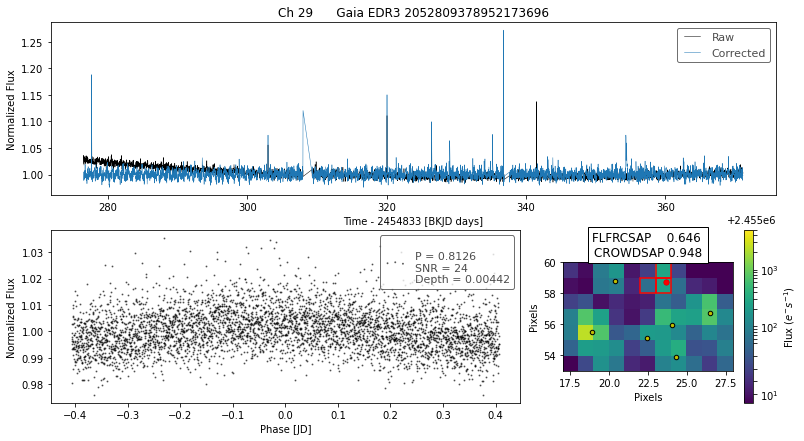

___________________________________________________
designation                Gaia EDR3 2126834789571998976
ra                                            290.382892
ra_error                                        0.015082
dec                                            43.743705
dec_error                                       0.015469
pmra                                           -2.246002
pmdec                                          -0.735077
parallax                                        1.967479
parallax_error                                  0.016731
phot_g_n_obs                                         341
phot_g_mean_flux                            28941.577697
phot_g_mean_flux_error                          6.619769
phot_g_mean_mag                                14.533562
phot_bp_n_obs                                         38
phot_bp_mean_flux                           13573.229362
phot_bp_mean_flux_error                        26.712053
phot_bp_mean_mag                    

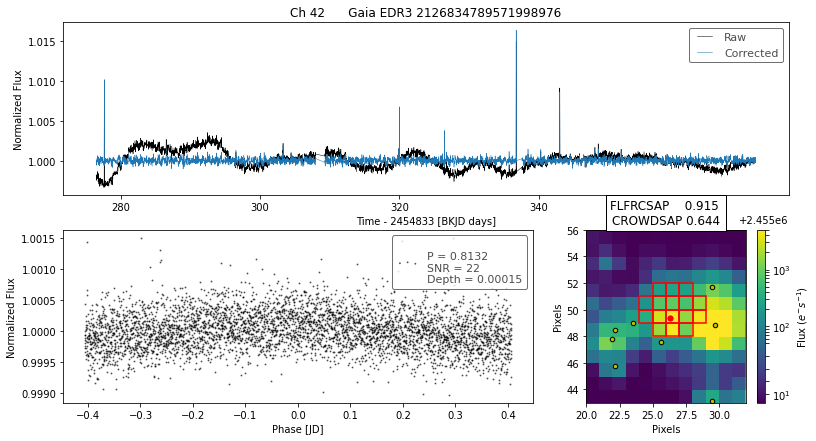

___________________________________________________
designation                Gaia EDR3 2052810920846403200
ra                                            290.550505
ra_error                                        0.048929
dec                                            38.295029
dec_error                                       0.054298
pmra                                           -1.893326
pmdec                                          -6.353014
parallax                                         0.20713
parallax_error                                  0.059753
phot_g_n_obs                                         386
phot_g_mean_flux                             2254.273156
phot_g_mean_flux_error                           1.73338
phot_g_mean_mag                                 17.30485
phot_bp_n_obs                                         44
phot_bp_mean_flux                            1110.901802
phot_bp_mean_flux_error                        10.239972
phot_bp_mean_mag                    

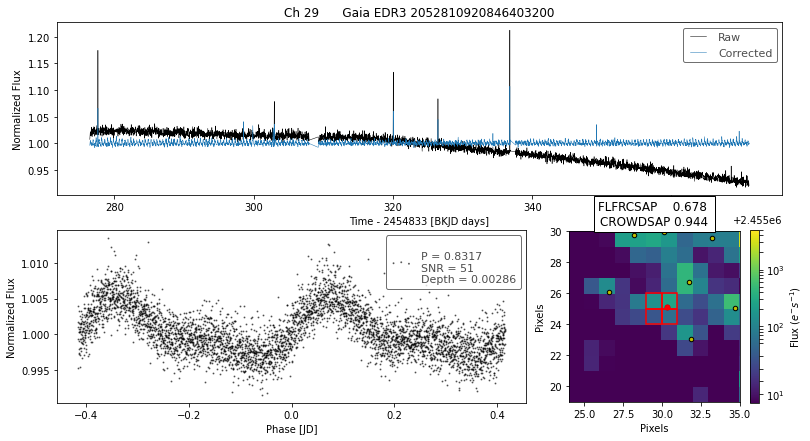

___________________________________________________
designation                Gaia EDR3 2052810925146533888
ra                                            290.551249
ra_error                                        0.094664
dec                                            38.296946
dec_error                                       0.105008
pmra                                           -3.245896
pmdec                                          -8.554492
parallax                                        0.562416
parallax_error                                   0.11599
phot_g_n_obs                                         369
phot_g_mean_flux                              933.450101
phot_g_mean_flux_error                          1.558715
phot_g_mean_mag                                18.262138
phot_bp_n_obs                                         43
phot_bp_mean_flux                             332.435352
phot_bp_mean_flux_error                          7.95527
phot_bp_mean_mag                    

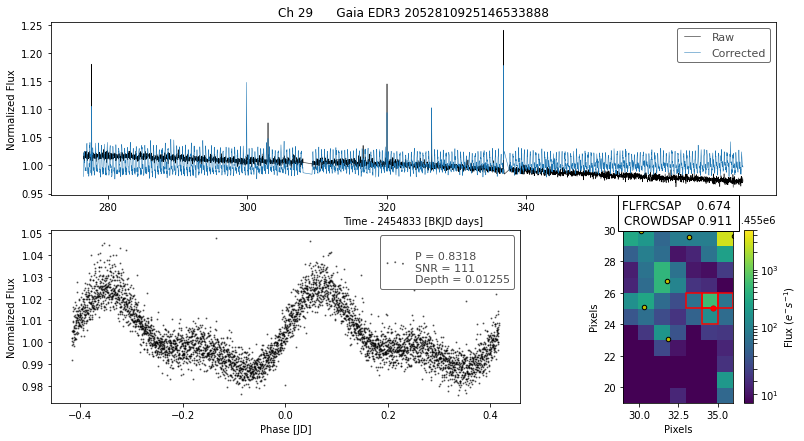

___________________________________________________
designation                Gaia EDR3 2077811276944142720
ra                                            293.069938
ra_error                                        0.055628
dec                                            42.874214
dec_error                                       0.063071
pmra                                           -1.134953
pmdec                                          -5.996195
parallax                                        0.087811
parallax_error                                  0.068712
phot_g_n_obs                                         284
phot_g_mean_flux                             3629.195387
phot_g_mean_flux_error                          3.641893
phot_g_mean_mag                                16.787842
phot_bp_n_obs                                          8
phot_bp_mean_flux                            3210.313739
phot_bp_mean_flux_error                       115.840675
phot_bp_mean_mag                    

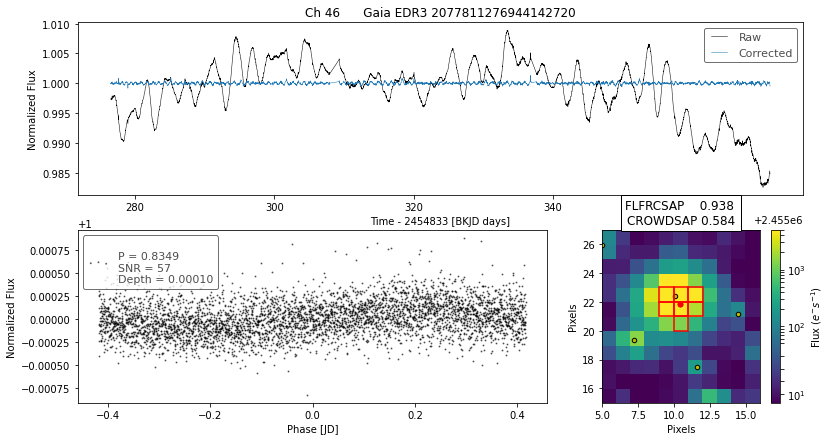

___________________________________________________
designation                Gaia EDR3 2077811272642203648
ra                                            293.070786
ra_error                                        0.008075
dec                                            42.873866
dec_error                                       0.008967
pmra                                           -4.763761
pmdec                                          -7.945556
parallax                                        0.261908
parallax_error                                  0.009748
phot_g_n_obs                                         358
phot_g_mean_flux                           286838.715721
phot_g_mean_flux_error                          70.14641
phot_g_mean_mag                                12.043272
phot_bp_n_obs                                         43
phot_bp_mean_flux                           91580.265962
phot_bp_mean_flux_error                         120.4405
phot_bp_mean_mag                    

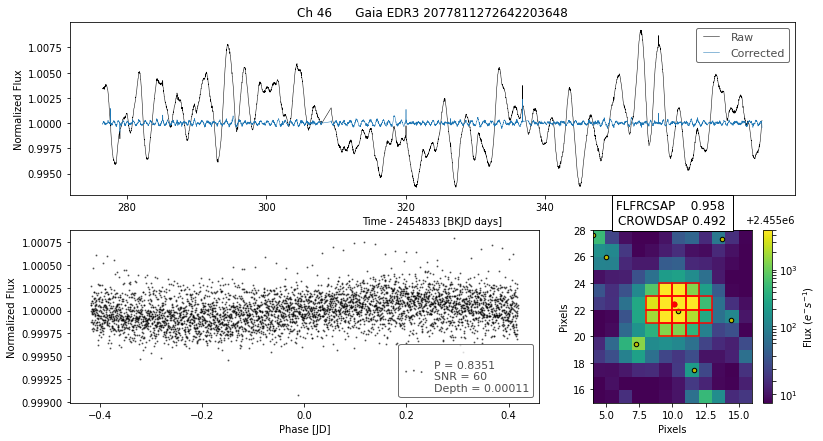

___________________________________________________
designation                Gaia EDR3 2077246849525050624
ra                                            295.879257
ra_error                                        0.011172
dec                                            42.767975
dec_error                                       0.012313
pmra                                           -0.947744
pmdec                                          -3.936772
parallax                                        0.232757
parallax_error                                  0.013406
phot_g_n_obs                                         376
phot_g_mean_flux                           138297.793411
phot_g_mean_flux_error                         27.910452
phot_g_mean_mag                                12.835329
phot_bp_n_obs                                         41
phot_bp_mean_flux                           39793.560038
phot_bp_mean_flux_error                         35.93907
phot_bp_mean_mag                    

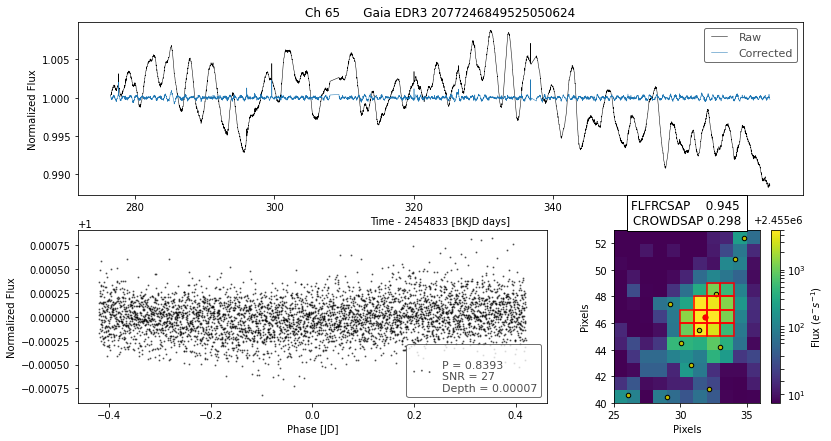

___________________________________________________
designation                Gaia EDR3 2073685836299371776
ra                                            297.581091
ra_error                                        0.011013
dec                                            40.276161
dec_error                                       0.011867
pmra                                           -2.044194
pmdec                                           -5.61653
parallax                                        0.359222
parallax_error                                  0.013418
phot_g_n_obs                                         405
phot_g_mean_flux                           289891.479884
phot_g_mean_flux_error                         51.179546
phot_g_mean_mag                                12.031778
phot_bp_n_obs                                         47
phot_bp_mean_flux                           83109.171645
phot_bp_mean_flux_error                         71.73932
phot_bp_mean_mag                    

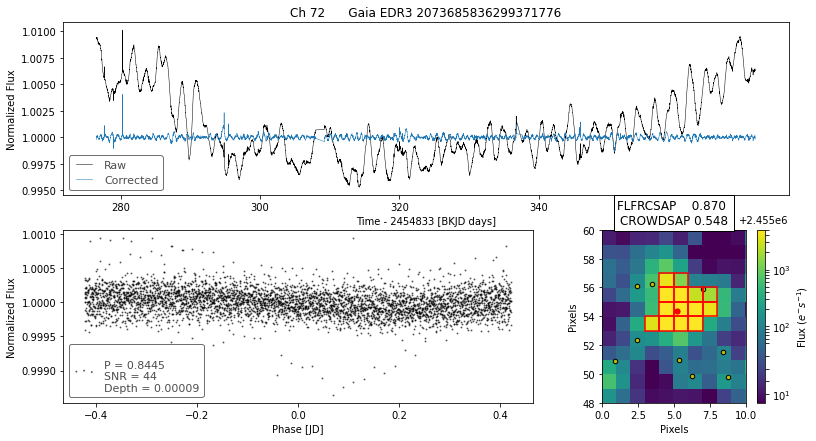

___________________________________________________
designation                Gaia EDR3 2076789899365242368
ra                                            296.940436
ra_error                                        0.037556
dec                                            41.235833
dec_error                                       0.044517
pmra                                           -0.222958
pmdec                                          -1.331279
parallax                                        0.288749
parallax_error                                  0.047029
phot_g_n_obs                                         372
phot_g_mean_flux                             3649.473017
phot_g_mean_flux_error                          2.069626
phot_g_mean_mag                                16.781792
phot_bp_n_obs                                         47
phot_bp_mean_flux                            1390.443879
phot_bp_mean_flux_error                         7.580499
phot_bp_mean_mag                    

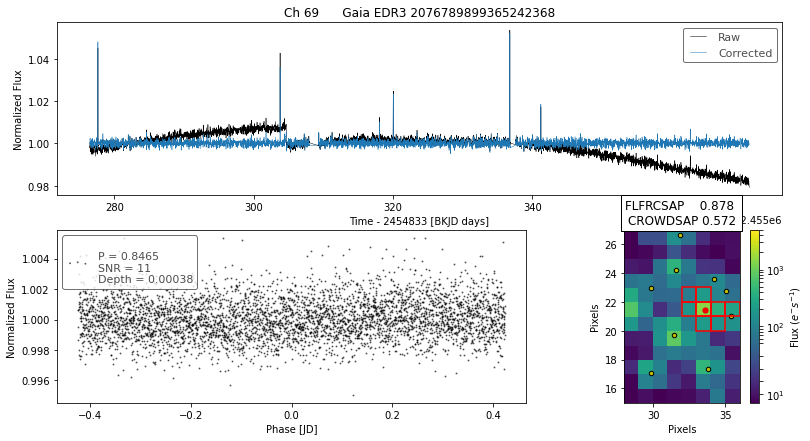

___________________________________________________
designation                Gaia EDR3 2075109738217443584
ra                                             299.01887
ra_error                                        0.062865
dec                                             40.82237
dec_error                                       0.070124
pmra                                           -3.626501
pmdec                                           -5.54796
parallax                                        0.036347
parallax_error                                  0.078223
phot_g_n_obs                                         338
phot_g_mean_flux                             1683.188115
phot_g_mean_flux_error                          1.964233
phot_g_mean_mag                                17.622036
phot_bp_n_obs                                         33
phot_bp_mean_flux                             806.026831
phot_bp_mean_flux_error                         7.945832
phot_bp_mean_mag                    

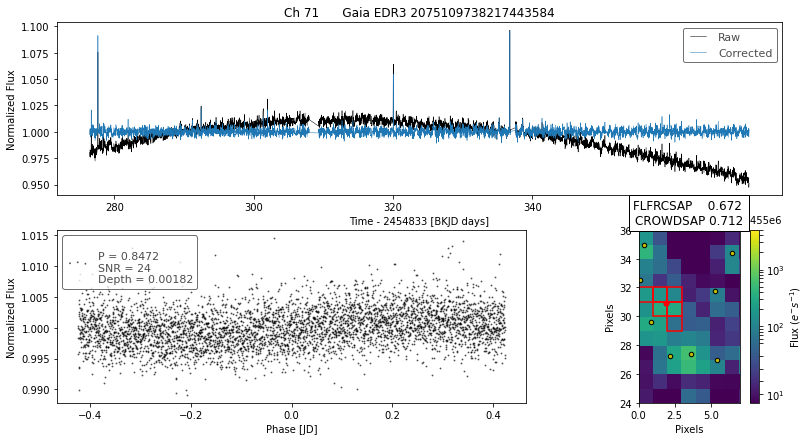

___________________________________________________
designation                Gaia EDR3 2051773845167236352
ra                                            291.309928
ra_error                                        0.009969
dec                                            37.381359
dec_error                                       0.011725
pmra                                             1.24108
pmdec                                          -7.847007
parallax                                        1.057866
parallax_error                                  0.012738
phot_g_n_obs                                         413
phot_g_mean_flux                            176492.94484
phot_g_mean_flux_error                         29.499056
phot_g_mean_mag                                12.570548
phot_bp_n_obs                                         51
phot_bp_mean_flux                           97278.833009
phot_bp_mean_flux_error                         49.99146
phot_bp_mean_mag                    

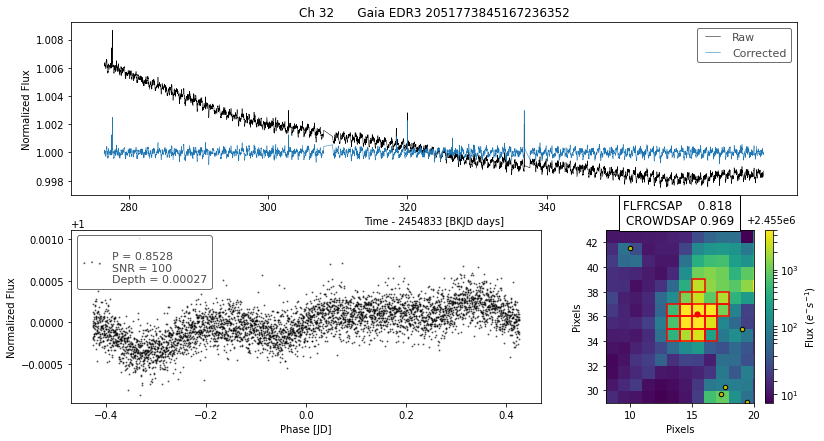

___________________________________________________
designation                Gaia EDR3 2128159804164528256
ra                                            294.334853
ra_error                                        0.009017
dec                                            46.790999
dec_error                                       0.010423
pmra                                           -3.346996
pmdec                                          -8.863014
parallax                                        0.877741
parallax_error                                  0.010403
phot_g_n_obs                                         366
phot_g_mean_flux                            85761.753661
phot_g_mean_flux_error                         17.499525
phot_g_mean_mag                                13.354133
phot_bp_n_obs                                         39
phot_bp_mean_flux                           48479.797723
phot_bp_mean_flux_error                        26.470387
phot_bp_mean_mag                    

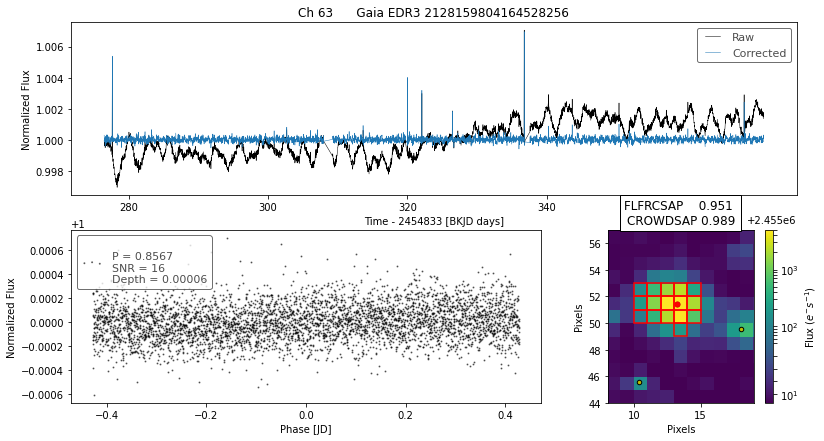

___________________________________________________
designation                Gaia EDR3 2085661343290509056
ra                                            298.875661
ra_error                                        0.009895
dec                                            47.143581
dec_error                                       0.010807
pmra                                           -0.469737
pmdec                                          -7.123973
parallax                                        0.723649
parallax_error                                  0.011441
phot_g_n_obs                                         374
phot_g_mean_flux                           139876.449534
phot_g_mean_flux_error                         27.109953
phot_g_mean_mag                                12.823006
phot_bp_n_obs                                         41
phot_bp_mean_flux                           76361.848429
phot_bp_mean_flux_error                         50.27006
phot_bp_mean_mag                    

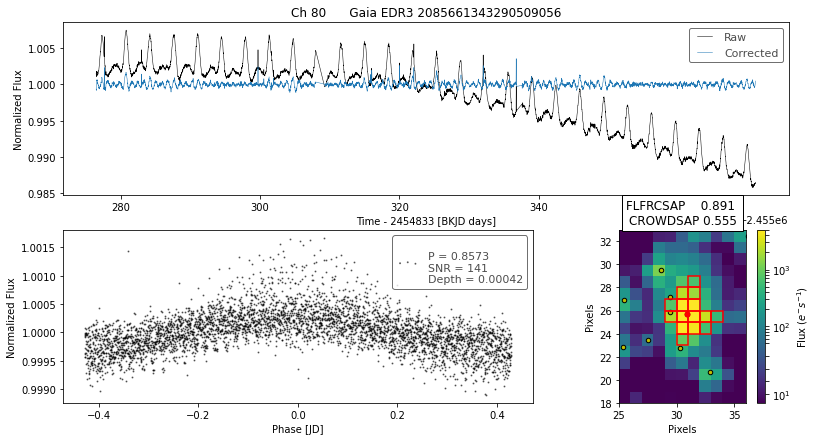

___________________________________________________
designation                Gaia EDR3 2085661343283179520
ra                                            298.876526
ra_error                                        0.104453
dec                                            47.142032
dec_error                                       0.117193
pmra                                           -0.750193
pmdec                                          -3.923691
parallax                                        0.090888
parallax_error                                  0.125919
phot_g_n_obs                                         347
phot_g_mean_flux                              737.179675
phot_g_mean_flux_error                          1.203062
phot_g_mean_mag                                18.518433
phot_bp_n_obs                                         39
phot_bp_mean_flux                             393.410013
phot_bp_mean_flux_error                         11.13802
phot_bp_mean_mag                    

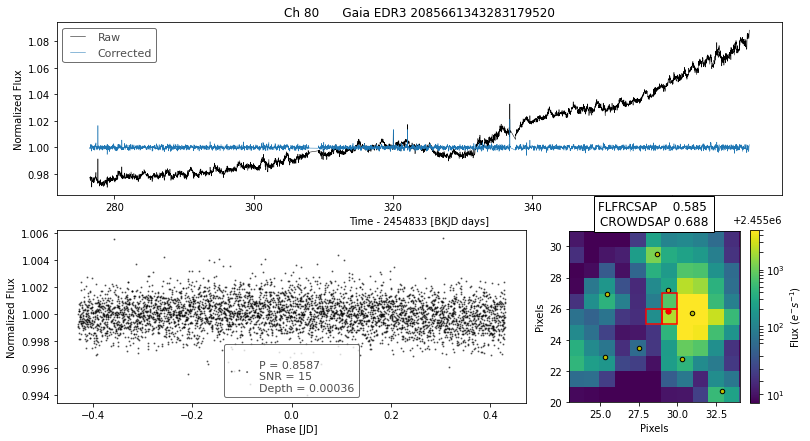

___________________________________________________
designation                Gaia EDR3 2052524468001498368
ra                                            291.287957
ra_error                                        0.263659
dec                                            37.383947
dec_error                                       0.309291
pmra                                           -3.241648
pmdec                                           -2.23473
parallax                                       -0.034957
parallax_error                                  0.348021
phot_g_n_obs                                         342
phot_g_mean_flux                              232.960167
phot_g_mean_flux_error                          0.898638
phot_g_mean_mag                                19.769163
phot_bp_n_obs                                         41
phot_bp_mean_flux                             109.267703
phot_bp_mean_flux_error                         7.475005
phot_bp_mean_mag                    

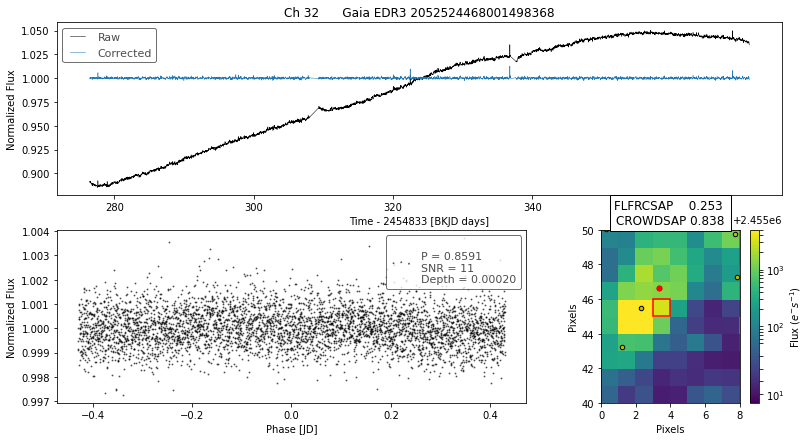

___________________________________________________
designation                Gaia EDR3 2052193137059176832
ra                                            294.386454
ra_error                                        0.008927
dec                                            38.873254
dec_error                                       0.010296
pmra                                           -2.560707
pmdec                                          -4.162411
parallax                                        0.127606
parallax_error                                  0.011128
phot_g_n_obs                                         388
phot_g_mean_flux                            84632.569456
phot_g_mean_flux_error                          27.26697
phot_g_mean_mag                                13.368523
phot_bp_n_obs                                         43
phot_bp_mean_flux                           25858.456692
phot_bp_mean_flux_error                          33.1185
phot_bp_mean_mag                    

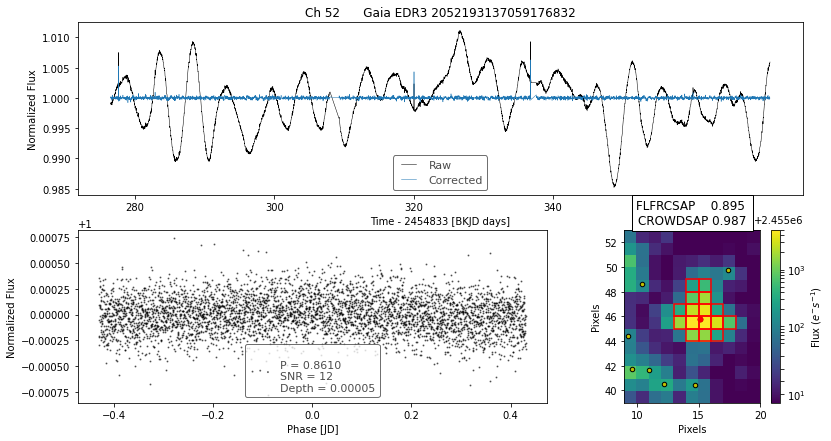

___________________________________________________
designation                Gaia EDR3 2082091366475040640
ra                                             300.72572
ra_error                                        0.010681
dec                                             44.57441
dec_error                                       0.010639
pmra                                           -4.213425
pmdec                                          -4.330169
parallax                                        0.300699
parallax_error                                  0.012205
phot_g_n_obs                                         360
phot_g_mean_flux                           162375.386263
phot_g_mean_flux_error                         57.643654
phot_g_mean_mag                                12.661066
phot_bp_n_obs                                         41
phot_bp_mean_flux                           36546.608911
phot_bp_mean_flux_error                        50.194496
phot_bp_mean_mag                    

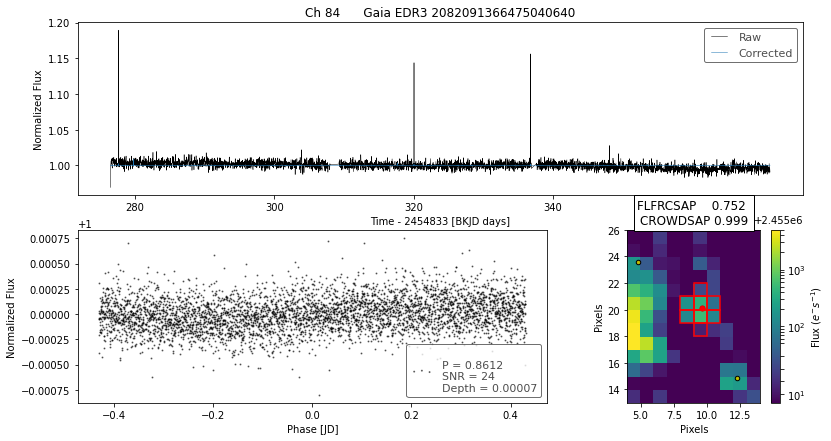

___________________________________________________
designation                Gaia EDR3 2086516454096774656
ra                                            298.046144
ra_error                                        0.300182
dec                                            48.195093
dec_error                                       0.374136
pmra                                           -2.524984
pmdec                                          -3.584467
parallax                                        0.507586
parallax_error                                  0.379152
phot_g_n_obs                                         303
phot_g_mean_flux                              222.900287
phot_g_mean_flux_error                          0.921336
phot_g_mean_mag                                19.817091
phot_bp_n_obs                                         33
phot_bp_mean_flux                             198.419674
phot_bp_mean_flux_error                        16.109274
phot_bp_mean_mag                    

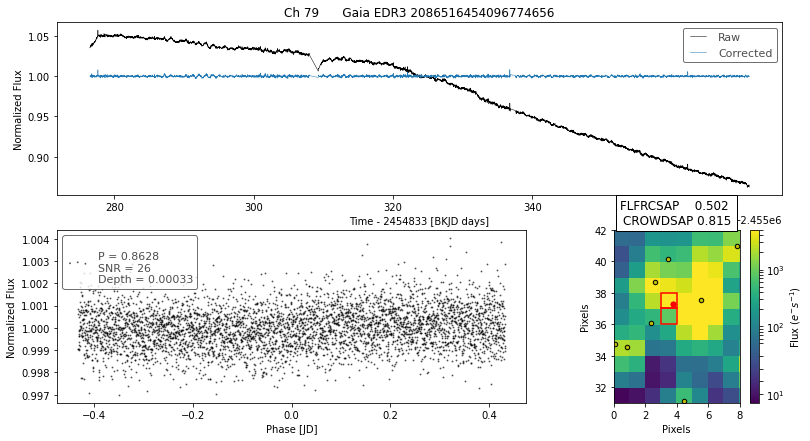

___________________________________________________
designation                Gaia EDR3 2086516454099072128
ra                                             298.04322
ra_error                                        0.012914
dec                                            48.195477
dec_error                                       0.014276
pmra                                            0.016746
pmdec                                          -6.454183
parallax                                        0.617139
parallax_error                                   0.01553
phot_g_n_obs                                         374
phot_g_mean_flux                            32895.363999
phot_g_mean_flux_error                          7.728816
phot_g_mean_mag                                 14.39453
phot_bp_n_obs                                         44
phot_bp_mean_flux                           18471.653745
phot_bp_mean_flux_error                        19.789774
phot_bp_mean_mag                    

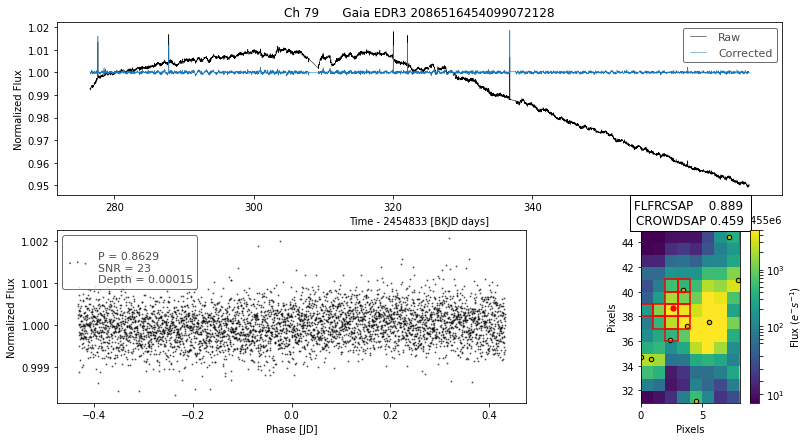

___________________________________________________
designation                Gaia EDR3 2078114329833055872
ra                                            295.061573
ra_error                                        0.103405
dec                                            43.795992
dec_error                                       0.106825
pmra                                           -1.084139
pmdec                                          -4.304962
parallax                                        0.488296
parallax_error                                   0.12277
phot_g_n_obs                                         314
phot_g_mean_flux                             1232.099553
phot_g_mean_flux_error                          1.902817
phot_g_mean_mag                                17.960752
phot_bp_n_obs                                         21
phot_bp_mean_flux                              798.56118
phot_bp_mean_flux_error                        34.664204
phot_bp_mean_mag                    

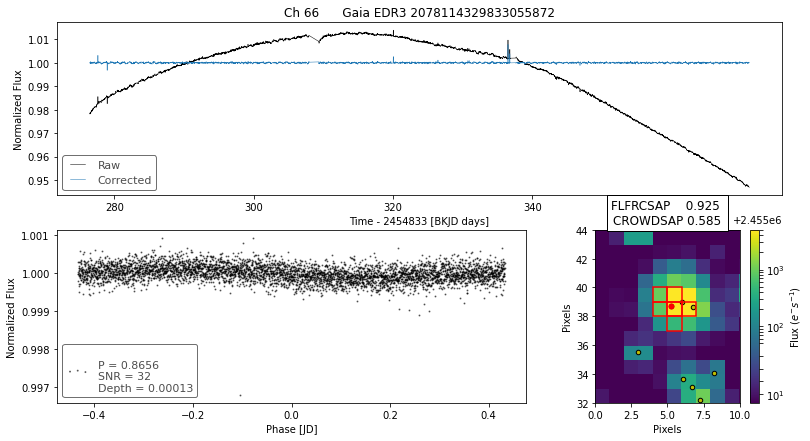

___________________________________________________
designation                Gaia EDR3 2078114329833055488
ra                                            295.062734
ra_error                                        0.042101
dec                                            43.794479
dec_error                                       0.041415
pmra                                           -1.626537
pmdec                                          -6.314201
parallax                                        0.214351
parallax_error                                  0.046893
phot_g_n_obs                                         344
phot_g_mean_flux                             4066.396951
phot_g_mean_flux_error                          2.687356
phot_g_mean_mag                                16.664343
phot_bp_n_obs                                         22
phot_bp_mean_flux                            2302.631135
phot_bp_mean_flux_error                        43.118793
phot_bp_mean_mag                    

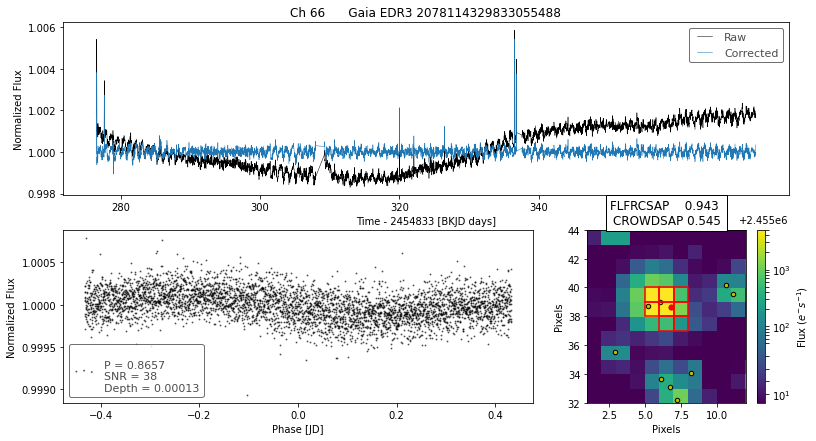

___________________________________________________
designation                Gaia EDR3 2078114329837758464
ra                                            295.062595
ra_error                                        0.009672
dec                                            43.795367
dec_error                                       0.010129
pmra                                           -1.039904
pmdec                                          -2.778226
parallax                                        0.792977
parallax_error                                  0.011101
phot_g_n_obs                                         359
phot_g_mean_flux                            81306.601993
phot_g_mean_flux_error                         17.053905
phot_g_mean_mag                                13.412052
phot_bp_n_obs                                         44
phot_bp_mean_flux                           47325.513601
phot_bp_mean_flux_error                        30.793339
phot_bp_mean_mag                    

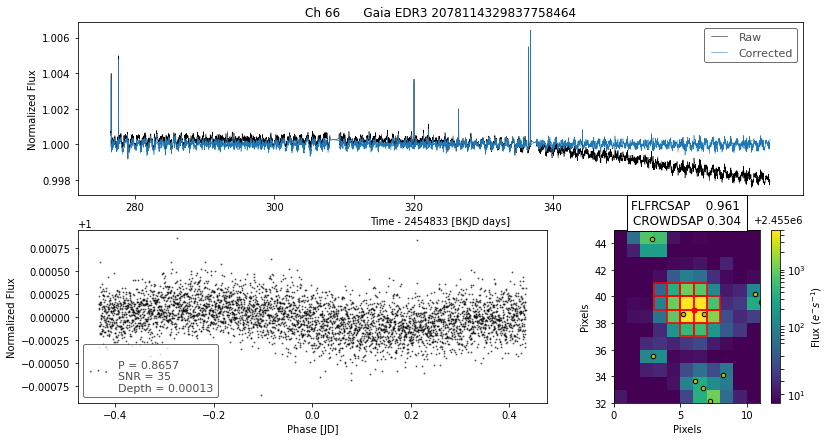

___________________________________________________
designation                Gaia EDR3 2080297440229703168
ra                                            297.439971
ra_error                                        0.145702
dec                                            46.592648
dec_error                                       0.136214
pmra                                            1.294657
pmdec                                           -7.99103
parallax                                        1.159722
parallax_error                                  0.155946
phot_g_n_obs                                         350
phot_g_mean_flux                              477.199778
phot_g_mean_flux_error                          0.993389
phot_g_mean_mag                                18.990616
phot_bp_n_obs                                         37
phot_bp_mean_flux                             100.603914
phot_bp_mean_flux_error                         6.106992
phot_bp_mean_mag                    

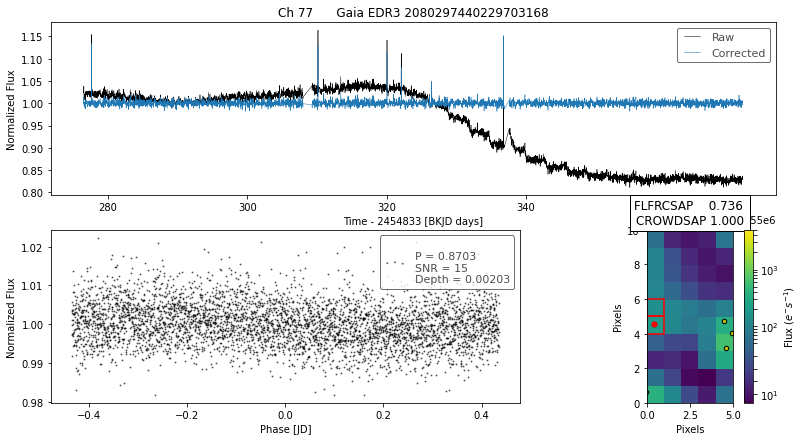

___________________________________________________
designation                Gaia EDR3 2079994215538033280
ra                                            295.214724
ra_error                                        0.201356
dec                                            45.747985
dec_error                                        0.21956
pmra                                            -0.42487
pmdec                                          -4.322945
parallax                                        0.523937
parallax_error                                  0.246463
phot_g_n_obs                                         292
phot_g_mean_flux                              371.294028
phot_g_mean_flux_error                          1.161609
phot_g_mean_mag                                19.263071
phot_bp_n_obs                                         31
phot_bp_mean_flux                             156.763302
phot_bp_mean_flux_error                         7.747234
phot_bp_mean_mag                    

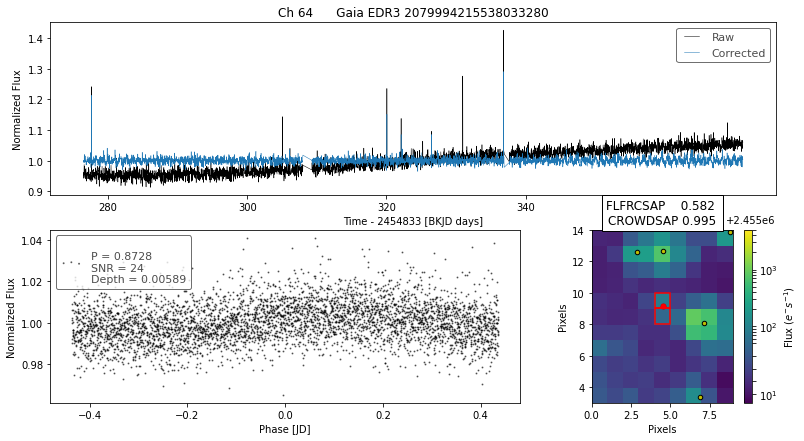

___________________________________________________
designation                Gaia EDR3 2073685771875992832
ra                                            297.623752
ra_error                                        0.309201
dec                                            40.288106
dec_error                                       0.305844
pmra                                           -2.958331
pmdec                                          -3.121342
parallax                                        0.900951
parallax_error                                   0.39244
phot_g_n_obs                                         285
phot_g_mean_flux                              216.836187
phot_g_mean_flux_error                          0.938309
phot_g_mean_mag                                19.847038
phot_bp_n_obs                                         31
phot_bp_mean_flux                             116.362682
phot_bp_mean_flux_error                        12.941755
phot_bp_mean_mag                    

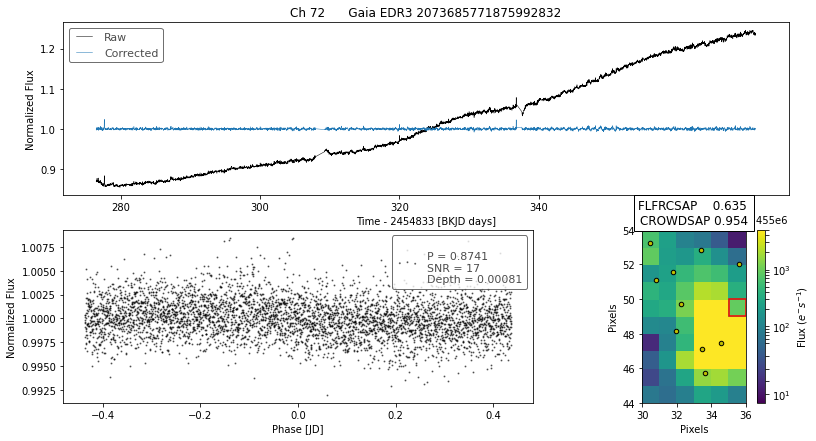

___________________________________________________
designation                Gaia EDR3 2076505778687823360
ra                                             294.99941
ra_error                                        0.013349
dec                                            40.392223
dec_error                                       0.015004
pmra                                            1.443993
pmdec                                           3.106141
parallax                                        1.570653
parallax_error                                  0.016249
phot_g_n_obs                                         372
phot_g_mean_flux                           151336.233648
phot_g_mean_flux_error                         23.707968
phot_g_mean_mag                                 12.73751
phot_bp_n_obs                                         46
phot_bp_mean_flux                           85616.636643
phot_bp_mean_flux_error                        56.997997
phot_bp_mean_mag                    

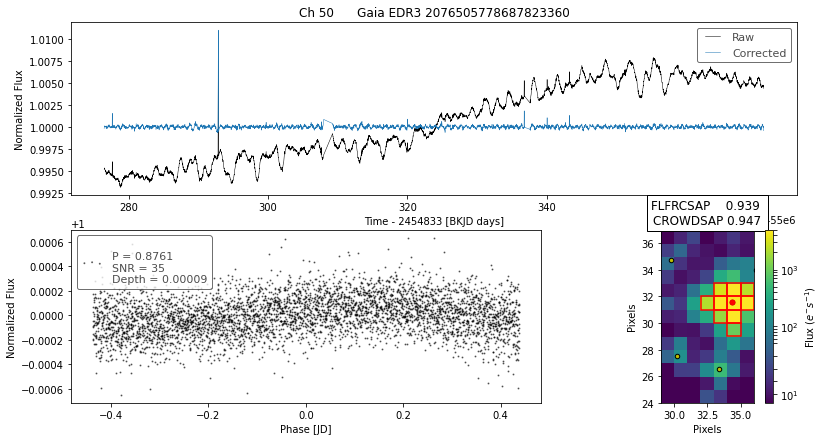

___________________________________________________
designation                Gaia EDR3 2129514093249096832
ra                                            290.737037
ra_error                                        0.031519
dec                                            48.583173
dec_error                                       0.030275
pmra                                           -1.169422
pmdec                                           -6.21898
parallax                                         0.19728
parallax_error                                  0.031227
phot_g_n_obs                                         336
phot_g_mean_flux                             6684.887459
phot_g_mean_flux_error                         20.480555
phot_g_mean_mag                                16.124632
phot_bp_n_obs                                         37
phot_bp_mean_flux                            2906.418295
phot_bp_mean_flux_error                         31.31036
phot_bp_mean_mag                    

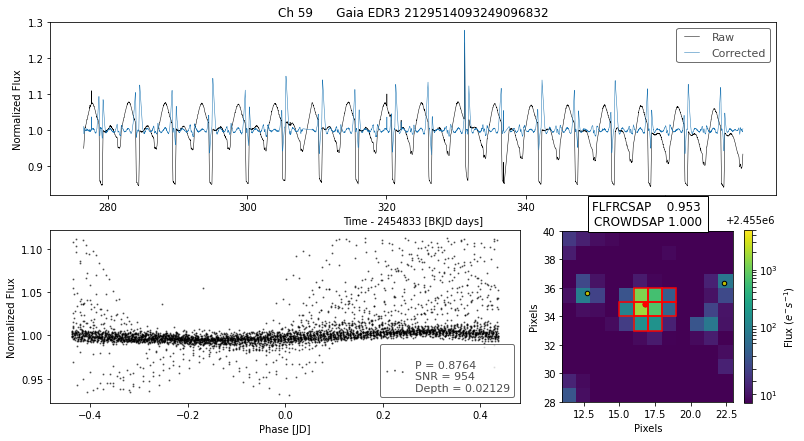

___________________________________________________
designation                Gaia EDR3 2076209460306594560
ra                                            295.756762
ra_error                                        0.014194
dec                                            39.456741
dec_error                                       0.014499
pmra                                           -2.914572
pmdec                                          -6.441806
parallax                                        0.119915
parallax_error                                  0.017112
phot_g_n_obs                                         377
phot_g_mean_flux                            27666.586976
phot_g_mean_flux_error                          6.365452
phot_g_mean_mag                                14.582478
phot_bp_n_obs                                         41
phot_bp_mean_flux                            9655.329728
phot_bp_mean_flux_error                        12.424451
phot_bp_mean_mag                    

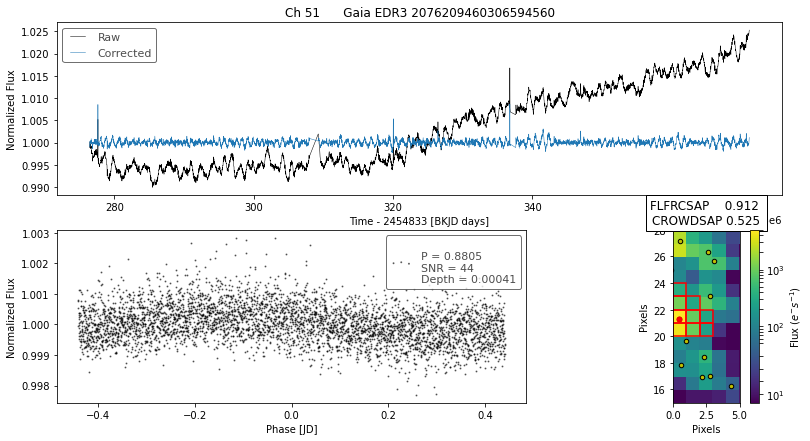

___________________________________________________
designation                Gaia EDR3 2101753619371695872
ra                                            291.667992
ra_error                                        0.086283
dec                                            42.259972
dec_error                                       0.102757
pmra                                           -1.761399
pmdec                                          -1.941937
parallax                                        0.194339
parallax_error                                  0.107516
phot_g_n_obs                                         337
phot_g_mean_flux                             1045.530194
phot_g_mean_flux_error                           2.17983
phot_g_mean_mag                                18.139025
phot_bp_n_obs                                         41
phot_bp_mean_flux                             582.994633
phot_bp_mean_flux_error                         6.215534
phot_bp_mean_mag                    

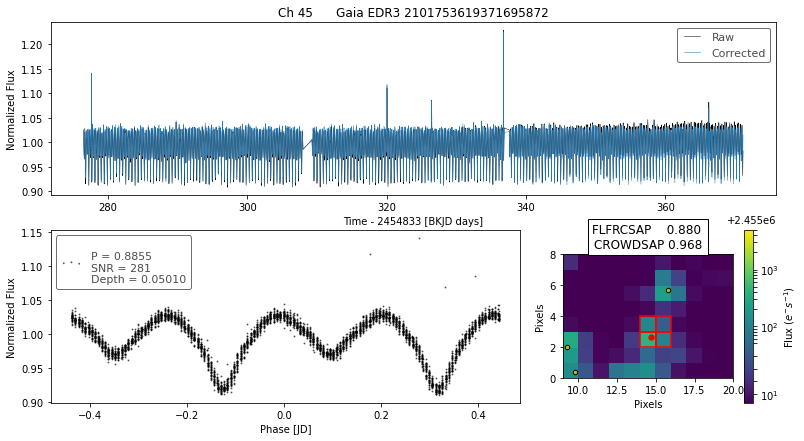

___________________________________________________
designation                Gaia EDR3 2101467303974110848
ra                                             289.81914
ra_error                                        0.011025
dec                                            41.317499
dec_error                                        0.01265
pmra                                            1.680886
pmdec                                           1.702992
parallax                                        1.242924
parallax_error                                  0.013322
phot_g_n_obs                                         394
phot_g_mean_flux                            41369.618589
phot_g_mean_flux_error                         19.310043
phot_g_mean_mag                                14.145663
phot_bp_n_obs                                         45
phot_bp_mean_flux                            21723.67854
phot_bp_mean_flux_error                        37.774673
phot_bp_mean_mag                    

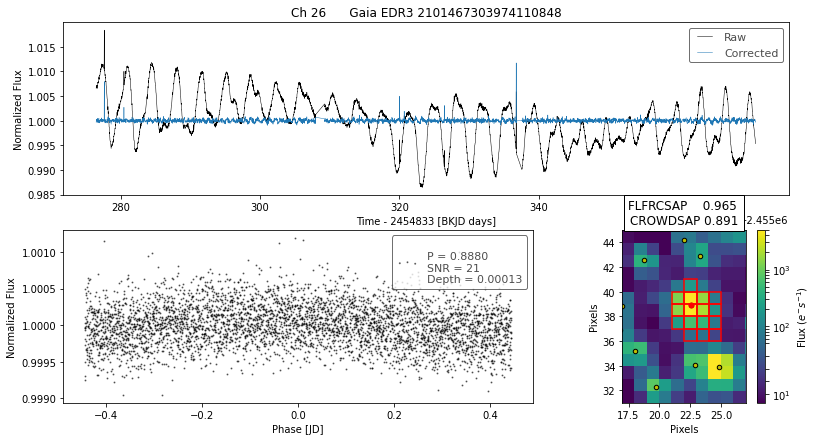

___________________________________________________
designation                Gaia EDR3 2052181214229976832
ra                                            294.425566
ra_error                                        0.012735
dec                                            38.855656
dec_error                                       0.014471
pmra                                            1.697925
pmdec                                          -2.853756
parallax                                        2.430908
parallax_error                                  0.015875
phot_g_n_obs                                         344
phot_g_mean_flux                           506973.302071
phot_g_mean_flux_error                         127.04853
phot_g_mean_mag                                11.424904
phot_bp_n_obs                                         44
phot_bp_mean_flux                           300566.56027
phot_bp_mean_flux_error                        175.76852
phot_bp_mean_mag                    

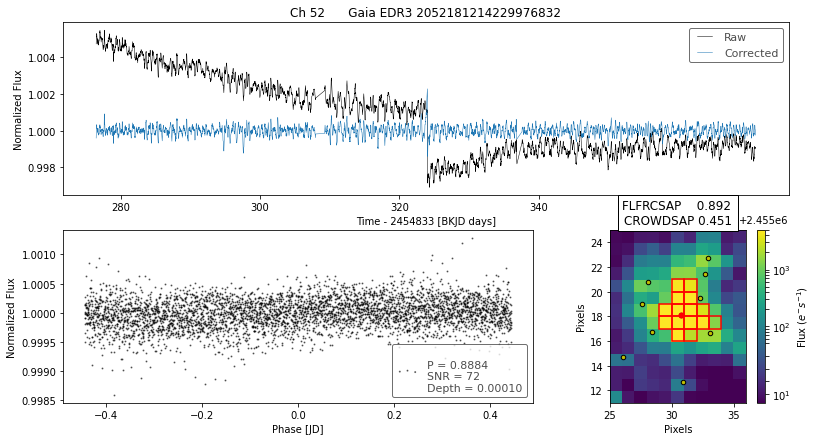

___________________________________________________
designation                Gaia EDR3 2073685771884129024
ra                                            297.623325
ra_error                                        0.043985
dec                                             40.28254
dec_error                                       0.042917
pmra                                            -2.09213
pmdec                                          -3.066723
parallax                                       -0.070013
parallax_error                                  0.050672
phot_g_n_obs                                         332
phot_g_mean_flux                             3748.177833
phot_g_mean_flux_error                          2.417173
phot_g_mean_mag                                16.752817
phot_bp_n_obs                                         41
phot_bp_mean_flux                            1457.269558
phot_bp_mean_flux_error                        21.087753
phot_bp_mean_mag                    

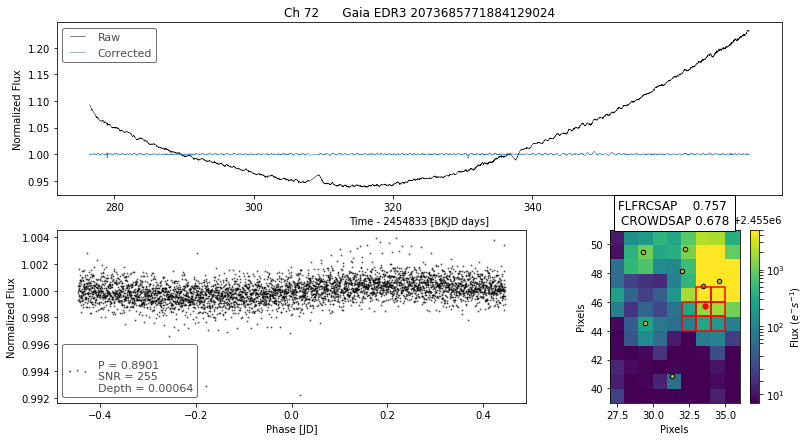

___________________________________________________
designation                Gaia EDR3 2073685771876090112
ra                                            297.622168
ra_error                                          0.0942
dec                                            40.283799
dec_error                                       0.099575
pmra                                           -2.551078
pmdec                                          -7.324605
parallax                                        0.426873
parallax_error                                  0.118366
phot_g_n_obs                                         312
phot_g_mean_flux                              999.891278
phot_g_mean_flux_error                          2.787323
phot_g_mean_mag                                18.187485
phot_bp_n_obs                                         34
phot_bp_mean_flux                             889.439526
phot_bp_mean_flux_error                         73.05421
phot_bp_mean_mag                    

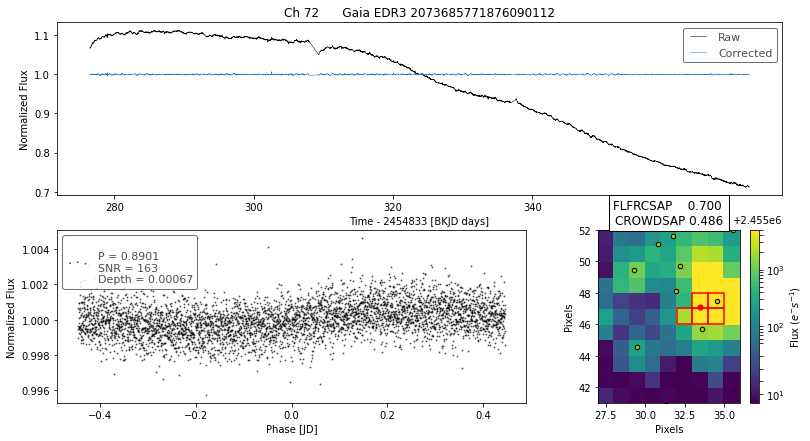

___________________________________________________
designation                Gaia EDR3 2073685771884589440
ra                                            297.623363
ra_error                                        0.019131
dec                                            40.284735
dec_error                                        0.02104
pmra                                            1.645476
pmdec                                          -0.423788
parallax                                        2.966581
parallax_error                                   0.02339
phot_g_n_obs                                         385
phot_g_mean_flux                           570809.482257
phot_g_mean_flux_error                         223.48813
phot_g_mean_mag                                11.296139
phot_bp_n_obs                                         42
phot_bp_mean_flux                          323058.315182
phot_bp_mean_flux_error                        158.32285
phot_bp_mean_mag                    

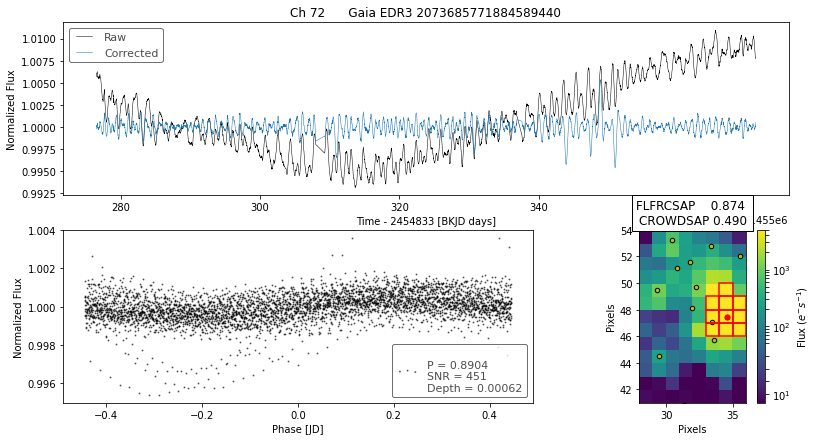

___________________________________________________
designation                Gaia EDR3 2073685771884589568
ra                                            297.618805
ra_error                                        0.071788
dec                                            40.285701
dec_error                                       0.076585
pmra                                              -2.541
pmdec                                          -3.817279
parallax                                       -0.035079
parallax_error                                  0.088852
phot_g_n_obs                                         359
phot_g_mean_flux                             1456.217427
phot_g_mean_flux_error                          1.602053
phot_g_mean_mag                                  17.7793
phot_bp_n_obs                                         39
phot_bp_mean_flux                             549.045351
phot_bp_mean_flux_error                        11.872484
phot_bp_mean_mag                    

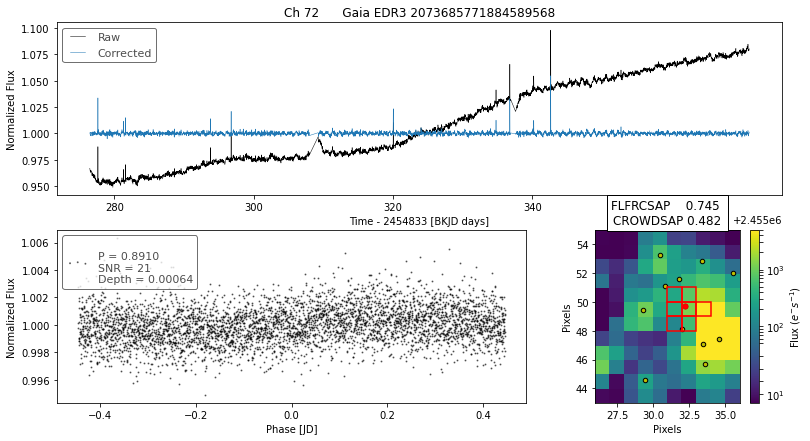

___________________________________________________
designation                Gaia EDR3 2077708816203015680
ra                                            293.854343
ra_error                                        0.023566
dec                                            41.913085
dec_error                                       0.026006
pmra                                           -0.914639
pmdec                                          -2.108241
parallax                                        0.121468
parallax_error                                  0.028787
phot_g_n_obs                                         360
phot_g_mean_flux                             9557.727711
phot_g_mean_flux_error                          3.066249
phot_g_mean_mag                                 15.73648
phot_bp_n_obs                                         40
phot_bp_mean_flux                            4143.676373
phot_bp_mean_flux_error                        13.165494
phot_bp_mean_mag                    

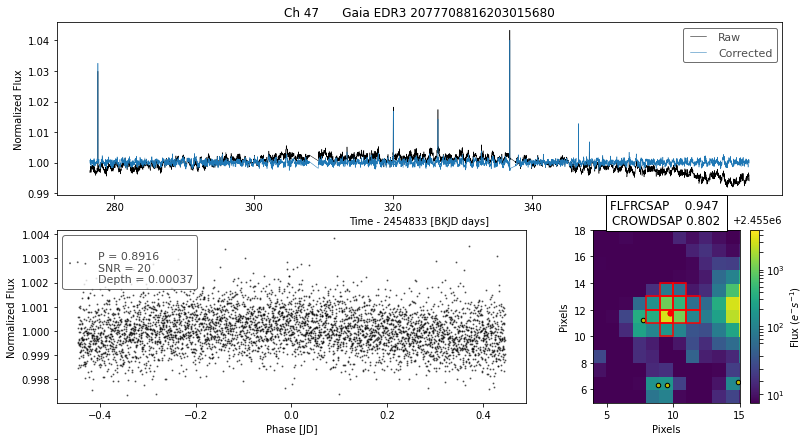

___________________________________________________
designation                Gaia EDR3 2132183707479643264
ra                                             284.68503
ra_error                                        0.009134
dec                                            49.259624
dec_error                                       0.011528
pmra                                            1.889104
pmdec                                          -3.308813
parallax                                        0.284761
parallax_error                                  0.011207
phot_g_n_obs                                         317
phot_g_mean_flux                            87535.865787
phot_g_mean_flux_error                         11.866728
phot_g_mean_mag                                13.331902
phot_bp_n_obs                                         38
phot_bp_mean_flux                           38149.604936
phot_bp_mean_flux_error                         29.82457
phot_bp_mean_mag                    

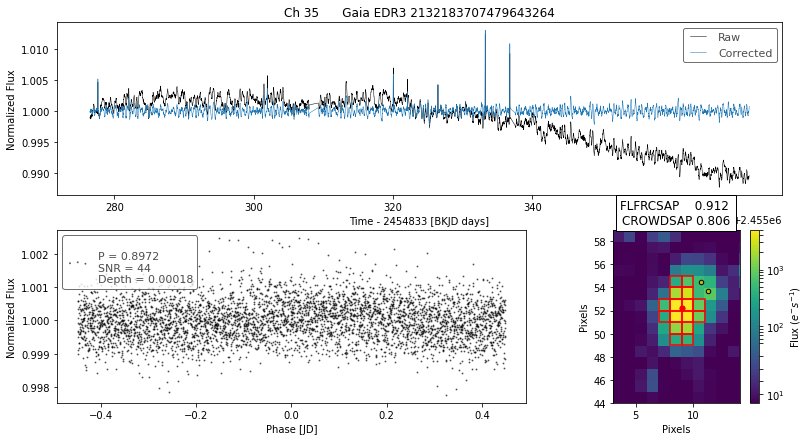

___________________________________________________
designation                Gaia EDR3 2080017653182617600
ra                                            295.232416
ra_error                                        0.273136
dec                                            45.765395
dec_error                                       0.269824
pmra                                            -4.26396
pmdec                                          -4.786696
parallax                                        0.210701
parallax_error                                  0.313227
phot_g_n_obs                                         232
phot_g_mean_flux                              312.184055
phot_g_mean_flux_error                          1.232285
phot_g_mean_mag                                 19.45134
phot_bp_n_obs                                         24
phot_bp_mean_flux                              88.731471
phot_bp_mean_flux_error                         7.038208
phot_bp_mean_mag                    

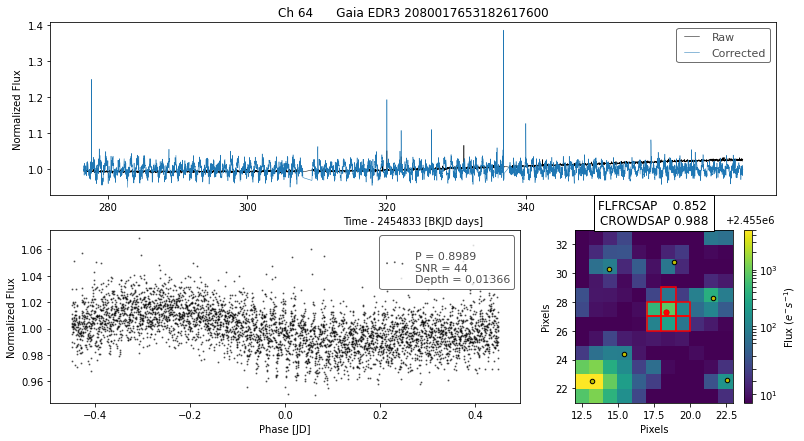

___________________________________________________
designation                Gaia EDR3 2131296848274153600
ra                                            287.115481
ra_error                                        0.007789
dec                                             49.12401
dec_error                                       0.007975
pmra                                           -5.970135
pmdec                                          -6.995733
parallax                                        0.922842
parallax_error                                  0.008356
phot_g_n_obs                                         405
phot_g_mean_flux                           942532.292924
phot_g_mean_flux_error                        117.793434
phot_g_mean_mag                                10.751626
phot_bp_n_obs                                         42
phot_bp_mean_flux                          427113.253278
phot_bp_mean_flux_error                        267.92752
phot_bp_mean_mag                    

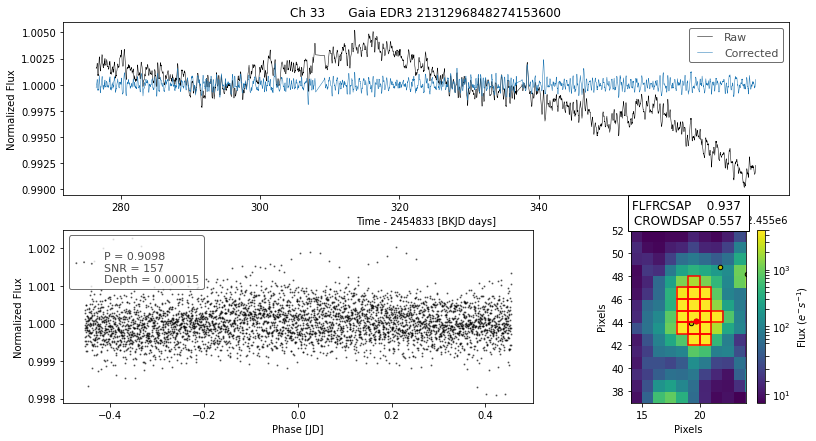

___________________________________________________
designation                Gaia EDR3 2131296848274153984
ra                                            287.116336
ra_error                                        0.042088
dec                                             49.12421
dec_error                                       0.054419
pmra                                            3.405982
pmdec                                          -3.286782
parallax                                        0.345573
parallax_error                                  0.042169
phot_g_n_obs                                         275
phot_g_mean_flux                             8733.237406
phot_g_mean_flux_error                          7.419083
phot_g_mean_mag                                15.834429
phot_bp_n_obs                                          2
phot_bp_mean_flux                            10737.71527
phot_bp_mean_flux_error                         119.3608
phot_bp_mean_mag                    

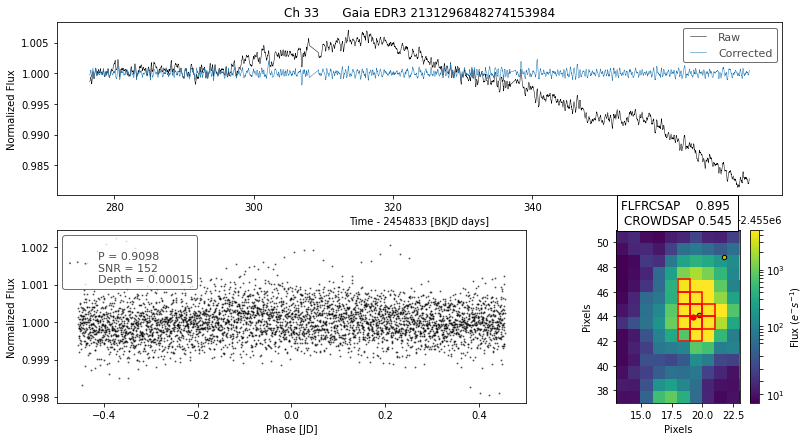

___________________________________________________
designation                Gaia EDR3 2076209425946827904
ra                                            295.708623
ra_error                                         0.06362
dec                                            39.478408
dec_error                                       0.065279
pmra                                           -3.700439
pmdec                                         -12.296354
parallax                                        0.441194
parallax_error                                   0.07723
phot_g_n_obs                                         346
phot_g_mean_flux                             1611.222304
phot_g_mean_flux_error                           2.34813
phot_g_mean_mag                                17.669477
phot_bp_n_obs                                         45
phot_bp_mean_flux                             750.172421
phot_bp_mean_flux_error                         8.181078
phot_bp_mean_mag                    

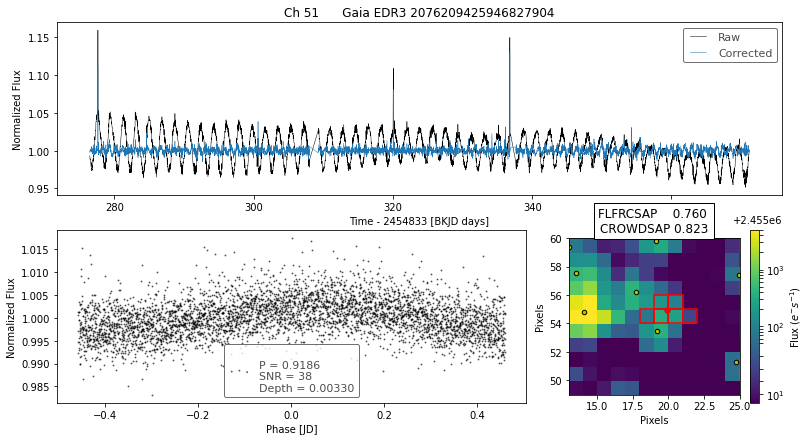

___________________________________________________
designation                Gaia EDR3 2076209352922634752
ra                                            295.710576
ra_error                                        0.063589
dec                                            39.477396
dec_error                                       0.065756
pmra                                           -4.757228
pmdec                                          -6.877993
parallax                                        0.292486
parallax_error                                   0.07602
phot_g_n_obs                                         354
phot_g_mean_flux                              1596.56664
phot_g_mean_flux_error                          1.457593
phot_g_mean_mag                                  17.6794
phot_bp_n_obs                                         43
phot_bp_mean_flux                               798.8712
phot_bp_mean_flux_error                          8.43301
phot_bp_mean_mag                    

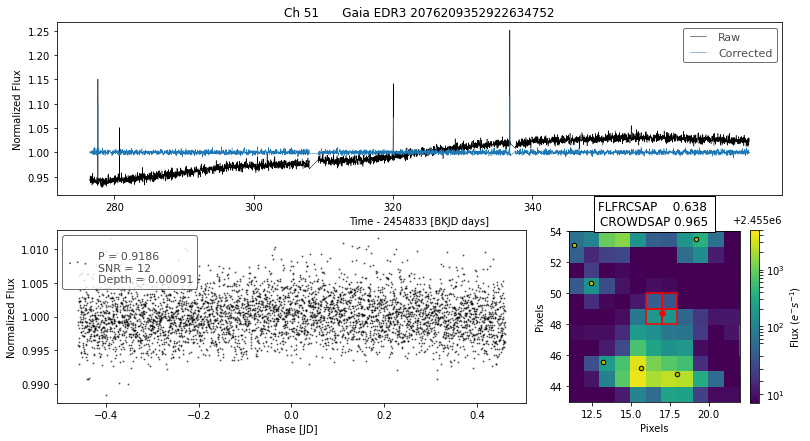

___________________________________________________
designation                Gaia EDR3 2053614187112978176
ra                                            292.473426
ra_error                                         0.04126
dec                                             41.32006
dec_error                                       0.049583
pmra                                            1.407214
pmdec                                         -11.008769
parallax                                        0.579579
parallax_error                                  0.049601
phot_g_n_obs                                         373
phot_g_mean_flux                             2990.986537
phot_g_mean_flux_error                          1.933297
phot_g_mean_mag                                16.997831
phot_bp_n_obs                                         43
phot_bp_mean_flux                            1318.417662
phot_bp_mean_flux_error                         7.332355
phot_bp_mean_mag                    

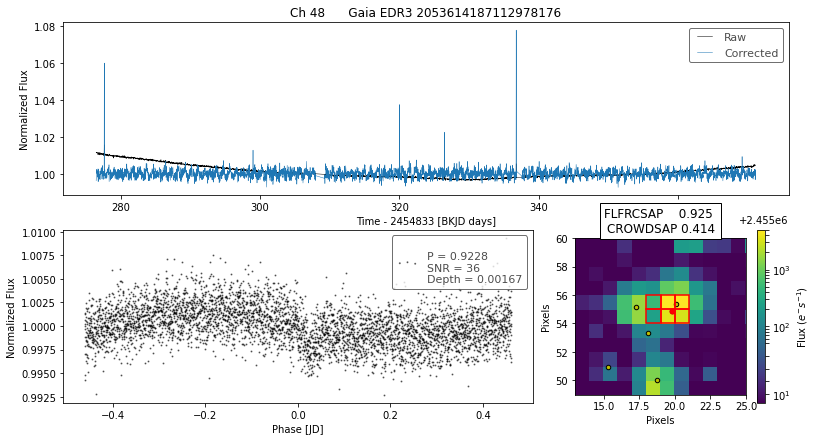

___________________________________________________
designation                Gaia EDR3 2086516454092861184
ra                                            298.047091
ra_error                                        0.010872
dec                                            48.193165
dec_error                                       0.011475
pmra                                           -0.390569
pmdec                                          -6.527844
parallax                                        0.520581
parallax_error                                  0.012227
phot_g_n_obs                                         379
phot_g_mean_flux                           553191.588957
phot_g_mean_flux_error                         123.57871
phot_g_mean_mag                                11.330178
phot_bp_n_obs                                         44
phot_bp_mean_flux                          230037.376434
phot_bp_mean_flux_error                        174.81029
phot_bp_mean_mag                    

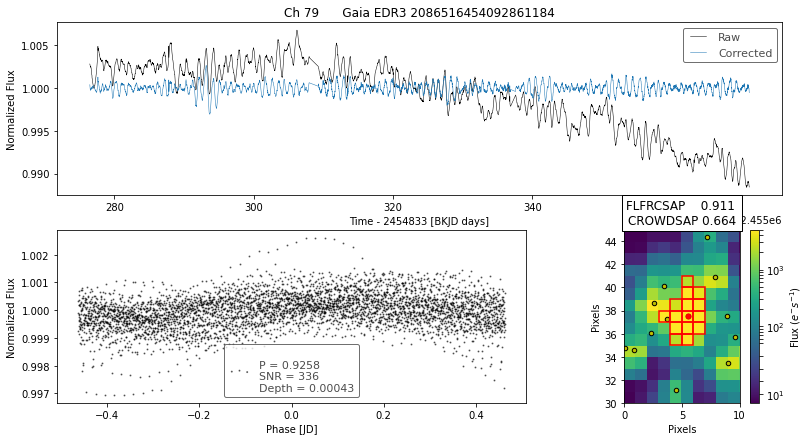

___________________________________________________
designation                Gaia EDR3 2107605804371181824
ra                                            283.749077
ra_error                                        0.012347
dec                                            47.401414
dec_error                                       0.013921
pmra                                           -1.407482
pmdec                                          -6.088671
parallax                                        0.501133
parallax_error                                  0.013599
phot_g_n_obs                                         367
phot_g_mean_flux                          1224846.121292
phot_g_mean_flux_error                         481.24045
phot_g_mean_mag                                10.467163
phot_bp_n_obs                                         41
phot_bp_mean_flux                          347259.592655
phot_bp_mean_flux_error                         486.9438
phot_bp_mean_mag                    

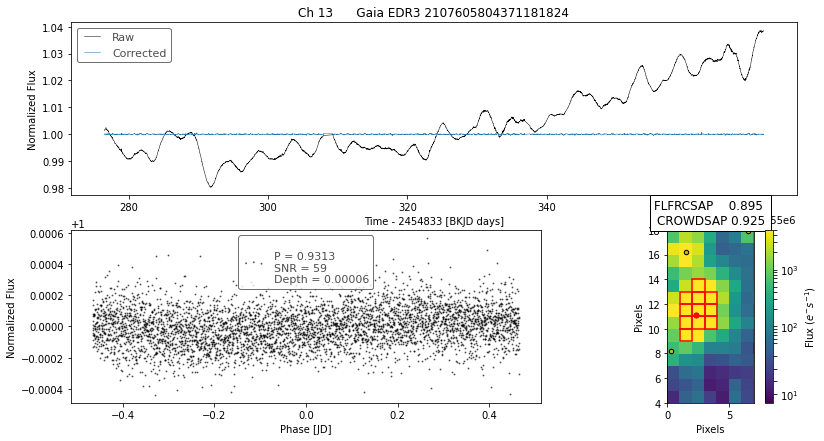

___________________________________________________
designation                Gaia EDR3 2079019056109973504
ra                                            299.363001
ra_error                                        0.133585
dec                                            44.107218
dec_error                                       0.142467
pmra                                            2.837865
pmdec                                          -2.638204
parallax                                        1.511373
parallax_error                                  0.153025
phot_g_n_obs                                         390
phot_g_mean_flux                           207115.575152
phot_g_mean_flux_error                         92.303795
phot_g_mean_mag                                12.396835
phot_bp_n_obs                                         41
phot_bp_mean_flux                          113236.128512
phot_bp_mean_flux_error                         60.00047
phot_bp_mean_mag                    

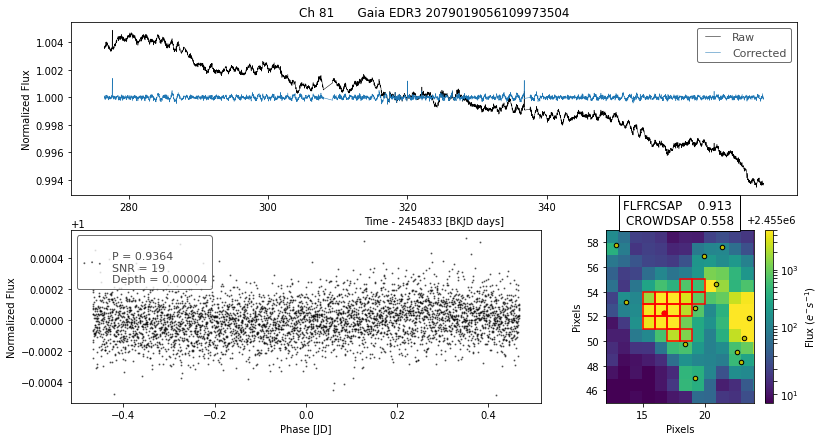

___________________________________________________
designation                Gaia EDR3 2078114158039040768
ra                                            295.043412
ra_error                                        0.011264
dec                                            43.760875
dec_error                                       0.011398
pmra                                           -1.277612
pmdec                                          -3.061851
parallax                                        0.382564
parallax_error                                  0.012455
phot_g_n_obs                                         330
phot_g_mean_flux                          1022081.694888
phot_g_mean_flux_error                           411.181
phot_g_mean_mag                                10.663652
phot_bp_n_obs                                         39
phot_bp_mean_flux                          268834.199381
phot_bp_mean_flux_error                         504.5106
phot_bp_mean_mag                    

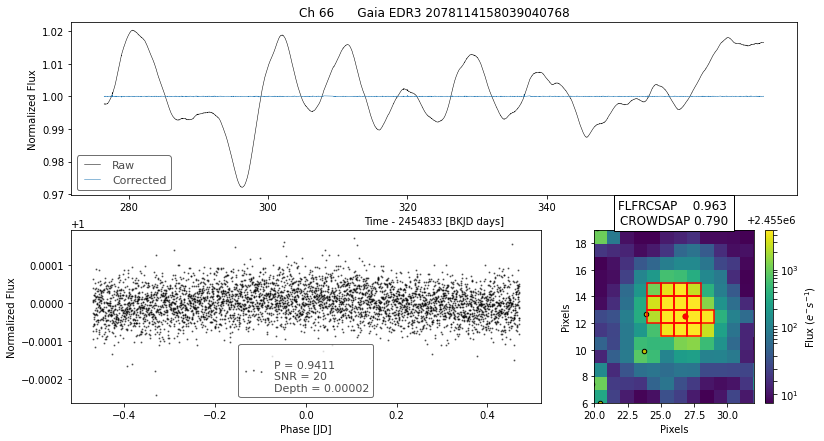

___________________________________________________
designation                Gaia EDR3 2073620350953105152
ra                                            298.977103
ra_error                                        0.014016
dec                                            40.828413
dec_error                                       0.014965
pmra                                           -1.008453
pmdec                                          -6.137906
parallax                                        0.158292
parallax_error                                  0.017065
phot_g_n_obs                                         337
phot_g_mean_flux                            33038.482542
phot_g_mean_flux_error                          8.146993
phot_g_mean_mag                                14.389816
phot_bp_n_obs                                         37
phot_bp_mean_flux                           11372.749678
phot_bp_mean_flux_error                        17.149721
phot_bp_mean_mag                    

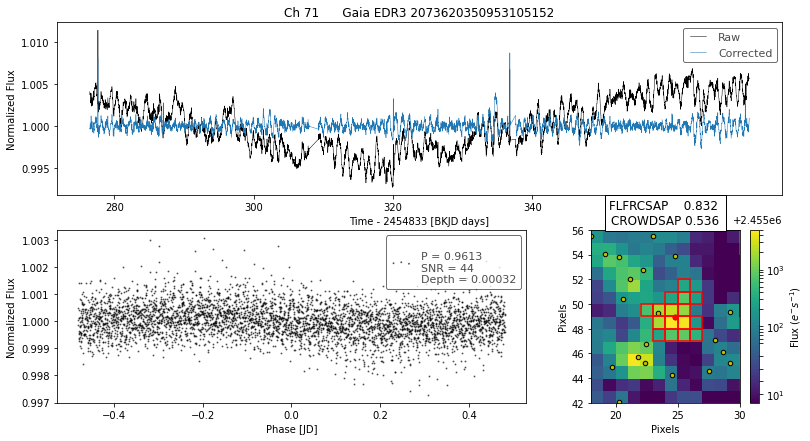

___________________________________________________
designation                Gaia EDR3 2073620346640709504
ra                                            298.978679
ra_error                                        0.043831
dec                                            40.829486
dec_error                                       0.050659
pmra                                           -1.140186
pmdec                                          -5.905956
parallax                                        0.715291
parallax_error                                  0.056172
phot_g_n_obs                                         311
phot_g_mean_flux                             3117.836333
phot_g_mean_flux_error                          2.209705
phot_g_mean_mag                                16.952734
phot_bp_n_obs                                         34
phot_bp_mean_flux                            1413.128681
phot_bp_mean_flux_error                         7.512827
phot_bp_mean_mag                    

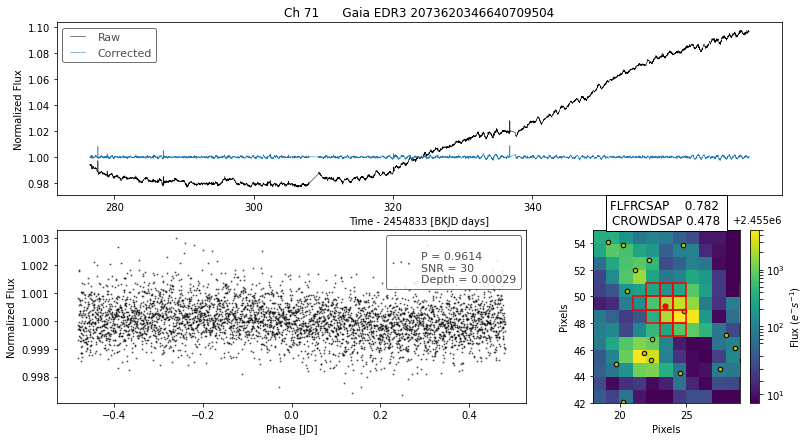

___________________________________________________
designation                Gaia EDR3 2053613362474891264
ra                                            292.500352
ra_error                                         0.22254
dec                                            41.297499
dec_error                                        0.28982
pmra                                            -1.19782
pmdec                                          -6.250528
parallax                                        0.172517
parallax_error                                  0.300339
phot_g_n_obs                                         320
phot_g_mean_flux                              276.831625
phot_g_mean_flux_error                          0.942904
phot_g_mean_mag                                19.581827
phot_bp_n_obs                                         32
phot_bp_mean_flux                             101.488513
phot_bp_mean_flux_error                         7.185029
phot_bp_mean_mag                    

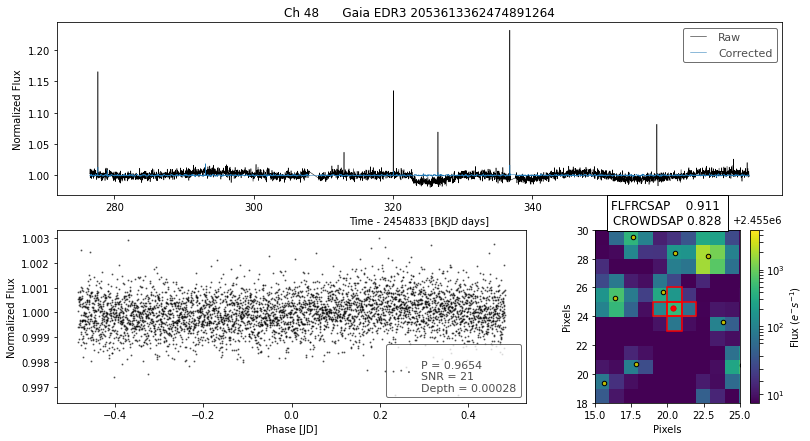

___________________________________________________
designation                Gaia EDR3 2053613362480702208
ra                                             292.49954
ra_error                                        0.014536
dec                                            41.296085
dec_error                                       0.017358
pmra                                           -3.910952
pmdec                                          -3.831383
parallax                                        0.092696
parallax_error                                  0.017898
phot_g_n_obs                                         350
phot_g_mean_flux                            40067.873159
phot_g_mean_flux_error                          9.547964
phot_g_mean_mag                                14.180376
phot_bp_n_obs                                         39
phot_bp_mean_flux                           14409.140762
phot_bp_mean_flux_error                        18.730804
phot_bp_mean_mag                    

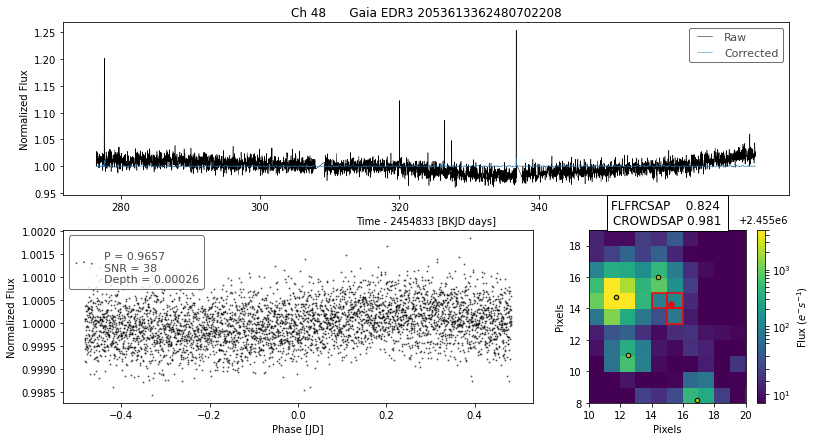

___________________________________________________
designation                Gaia EDR3 2053613362479258368
ra                                             292.49946
ra_error                                        0.059929
dec                                            41.294779
dec_error                                       0.074561
pmra                                            -1.18815
pmdec                                          -1.449834
parallax                                        0.166648
parallax_error                                  0.076714
phot_g_n_obs                                         350
phot_g_mean_flux                             1873.789252
phot_g_mean_flux_error                          2.218212
phot_g_mean_mag                                17.505566
phot_bp_n_obs                                         39
phot_bp_mean_flux                             942.887053
phot_bp_mean_flux_error                         8.870034
phot_bp_mean_mag                    

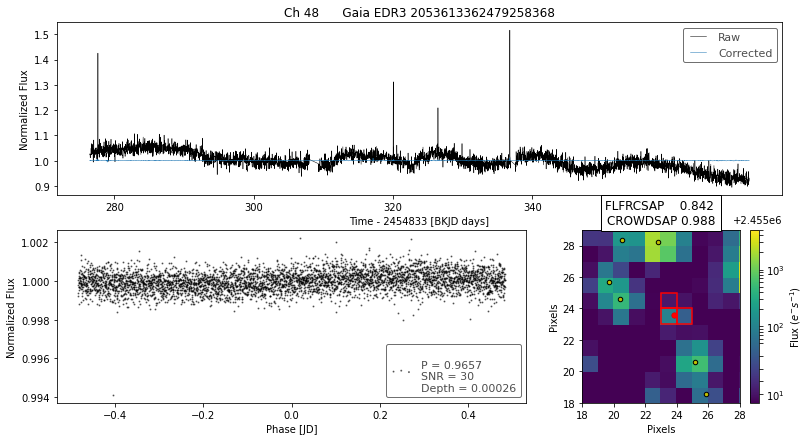

___________________________________________________
designation                Gaia EDR3 2079019571505694464
ra                                            299.292047
ra_error                                        0.013162
dec                                             44.10303
dec_error                                        0.01455
pmra                                           -1.621478
pmdec                                          -3.380777
parallax                                        0.168442
parallax_error                                  0.015065
phot_g_n_obs                                         358
phot_g_mean_flux                            35074.224832
phot_g_mean_flux_error                          9.548452
phot_g_mean_mag                                14.324897
phot_bp_n_obs                                         42
phot_bp_mean_flux                           10212.303911
phot_bp_mean_flux_error                        14.777727
phot_bp_mean_mag                    

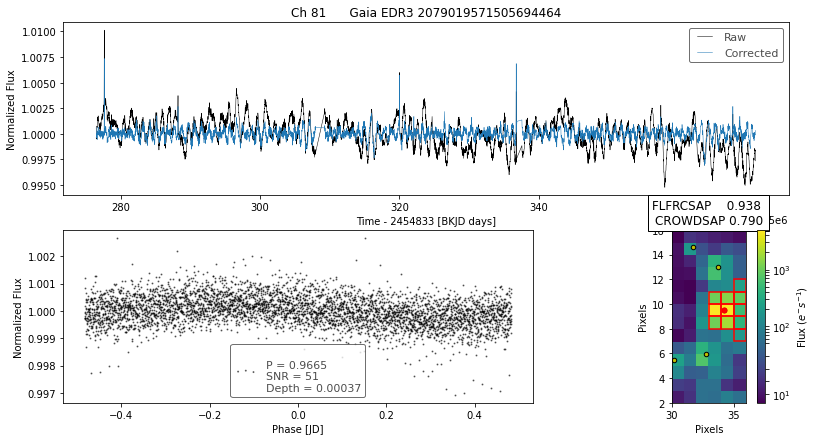

___________________________________________________
designation                Gaia EDR3 2053613362474886272
ra                                            292.500693
ra_error                                        0.141482
dec                                            41.294898
dec_error                                        0.18766
pmra                                           -2.415118
pmdec                                          -2.455978
parallax                                        0.285628
parallax_error                                  0.191786
phot_g_n_obs                                         351
phot_g_mean_flux                              451.347388
phot_g_mean_flux_error                          1.094546
phot_g_mean_mag                                 19.05109
phot_bp_n_obs                                         20
phot_bp_mean_flux                             240.355793
phot_bp_mean_flux_error                         6.652896
phot_bp_mean_mag                    

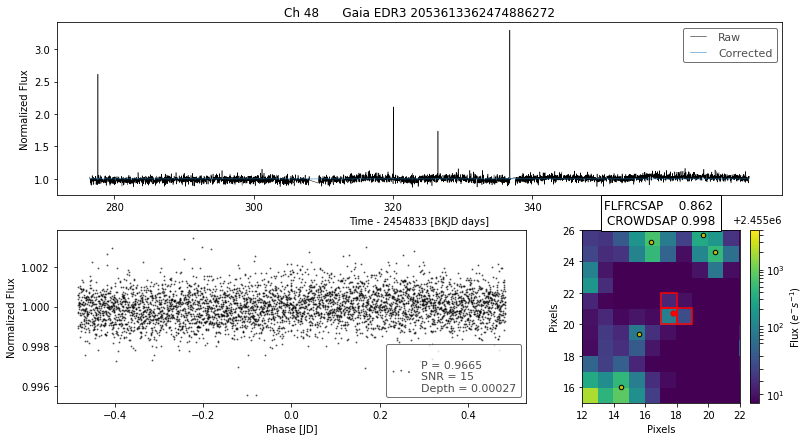

___________________________________________________
designation                Gaia EDR3 2116940658091559424
ra                                            280.835519
ra_error                                        0.079273
dec                                            43.563987
dec_error                                       0.101792
pmra                                           -3.267945
pmdec                                          -8.793503
parallax                                        0.595934
parallax_error                                  0.096567
phot_g_n_obs                                         359
phot_g_mean_flux                               989.18773
phot_g_mean_flux_error                          1.661145
phot_g_mean_mag                                 18.19917
phot_bp_n_obs                                         39
phot_bp_mean_flux                             354.343484
phot_bp_mean_flux_error                          8.56036
phot_bp_mean_mag                    

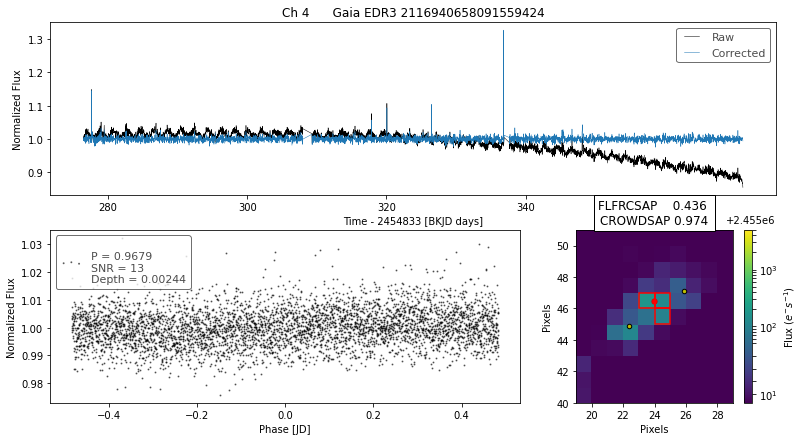

___________________________________________________
designation                Gaia EDR3 2128905410485521024
ra                                            293.135599
ra_error                                        0.010143
dec                                            48.290109
dec_error                                        0.01023
pmra                                           -1.287051
pmdec                                          -7.676213
parallax                                        0.280674
parallax_error                                  0.011041
phot_g_n_obs                                         386
phot_g_mean_flux                           610239.021608
phot_g_mean_flux_error                         262.21237
phot_g_mean_mag                                11.223617
phot_bp_n_obs                                         42
phot_bp_mean_flux                          188079.929706
phot_bp_mean_flux_error                         362.5332
phot_bp_mean_mag                    

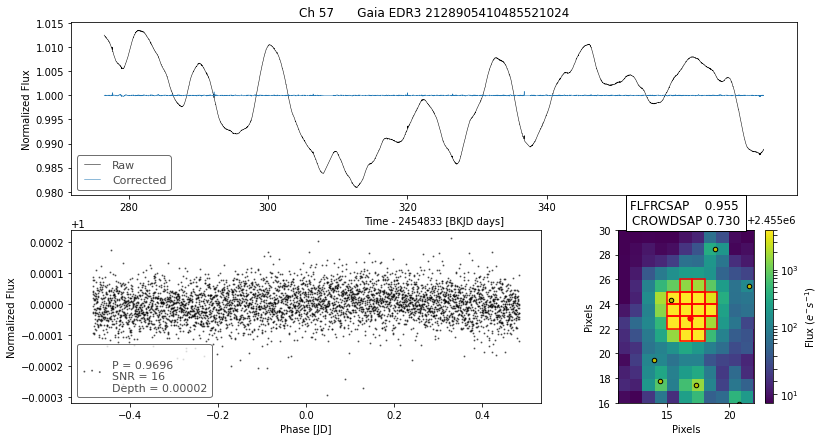

___________________________________________________
designation                Gaia EDR3 2079019812023882880
ra                                            299.357652
ra_error                                        0.010402
dec                                            44.113763
dec_error                                       0.010408
pmra                                            4.714835
pmdec                                          -5.016083
parallax                                        1.233789
parallax_error                                  0.011344
phot_g_n_obs                                         373
phot_g_mean_flux                           476441.720923
phot_g_mean_flux_error                          89.28009
phot_g_mean_mag                                11.492342
phot_bp_n_obs                                         42
phot_bp_mean_flux                          268440.382598
phot_bp_mean_flux_error                        150.75006
phot_bp_mean_mag                    

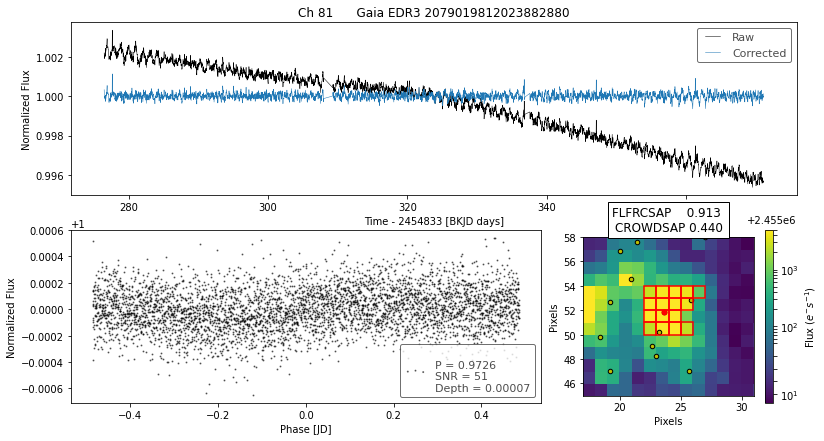

___________________________________________________
designation                Gaia EDR3 2077240900988331264
ra                                            295.844172
ra_error                                        0.013739
dec                                            42.742808
dec_error                                       0.013255
pmra                                           -3.348117
pmdec                                          -3.926361
parallax                                         0.43287
parallax_error                                  0.015141
phot_g_n_obs                                         373
phot_g_mean_flux                           557402.443733
phot_g_mean_flux_error                         196.34358
phot_g_mean_mag                                11.321944
phot_bp_n_obs                                         45
phot_bp_mean_flux                          144093.494619
phot_bp_mean_flux_error                        169.48352
phot_bp_mean_mag                    

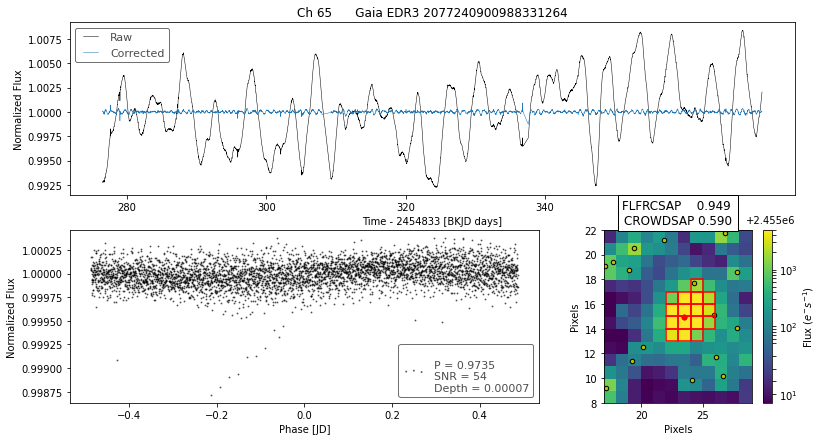

___________________________________________________
designation                Gaia EDR3 2133602451140200192
ra                                            286.142877
ra_error                                        0.170537
dec                                             50.03165
dec_error                                       0.175052
pmra                                           -1.750962
pmdec                                          -2.023801
parallax                                        0.642324
parallax_error                                  0.181976
phot_g_n_obs                                         370
phot_g_mean_flux                              359.590753
phot_g_mean_flux_error                          1.004638
phot_g_mean_mag                                19.297846
phot_bp_n_obs                                         41
phot_bp_mean_flux                              131.57681
phot_bp_mean_flux_error                         6.259241
phot_bp_mean_mag                    

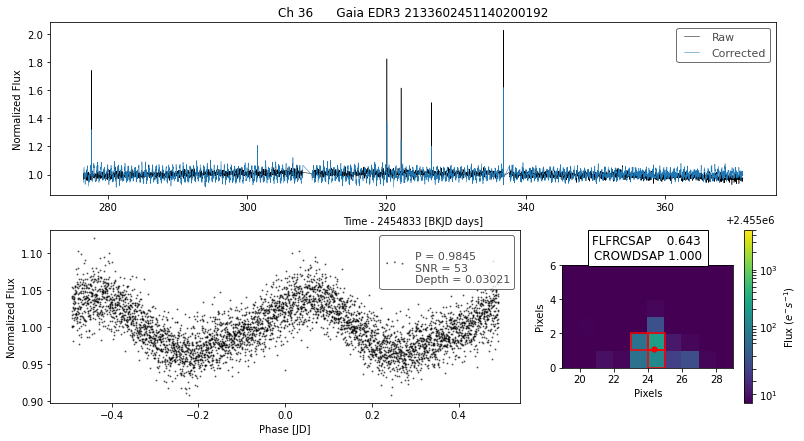

___________________________________________________
designation                Gaia EDR3 2052502988875097472
ra                                            293.679801
ra_error                                        0.007858
dec                                             39.82984
dec_error                                       0.008244
pmra                                           -4.340595
pmdec                                          -8.603644
parallax                                        0.255655
parallax_error                                  0.009523
phot_g_n_obs                                         362
phot_g_mean_flux                           214101.793681
phot_g_mean_flux_error                          54.36253
phot_g_mean_mag                                12.360816
phot_bp_n_obs                                         44
phot_bp_mean_flux                           62664.966095
phot_bp_mean_flux_error                         68.45693
phot_bp_mean_mag                    

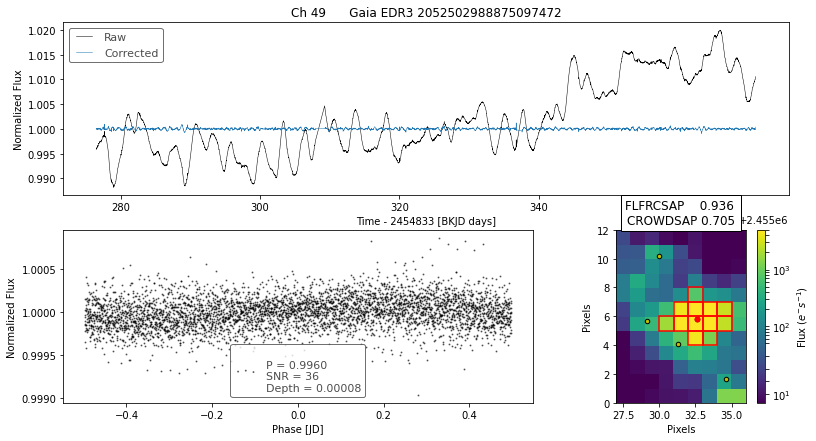

___________________________________________________
designation                Gaia EDR3 2077246849519249152
ra                                            295.878263
ra_error                                        0.150864
dec                                            42.767001
dec_error                                       0.167196
pmra                                           -4.568577
pmdec                                          -5.892252
parallax                                        0.358551
parallax_error                                  0.184962
phot_g_n_obs                                         331
phot_g_mean_flux                              549.842263
phot_g_mean_flux_error                          1.182811
phot_g_mean_mag                                18.836771
phot_bp_n_obs                                         33
phot_bp_mean_flux                             328.318276
phot_bp_mean_flux_error                        13.925326
phot_bp_mean_mag                    

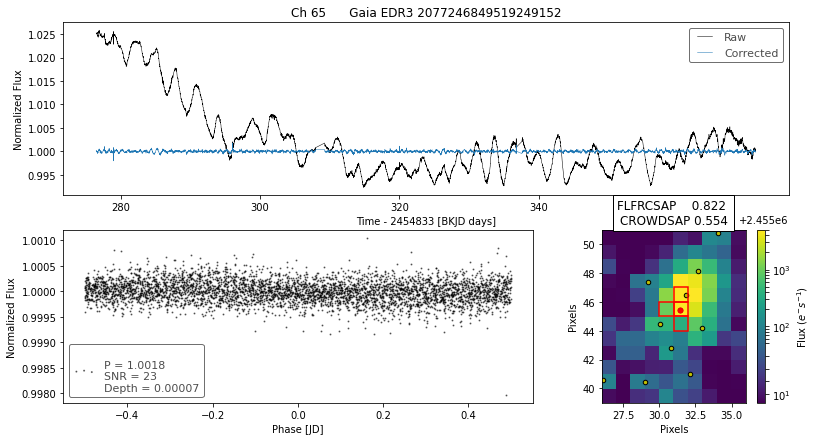

___________________________________________________
designation                Gaia EDR3 2085664190847347072
ra                                             298.86366
ra_error                                        0.171979
dec                                            47.132361
dec_error                                       0.214014
pmra                                           -5.513353
pmdec                                          -3.217033
parallax                                        0.739738
parallax_error                                  0.215955
phot_g_n_obs                                         317
phot_g_mean_flux                              389.839379
phot_g_mean_flux_error                          1.173157
phot_g_mean_mag                                19.210152
phot_bp_n_obs                                         32
phot_bp_mean_flux                             119.447231
phot_bp_mean_flux_error                         4.683827
phot_bp_mean_mag                    

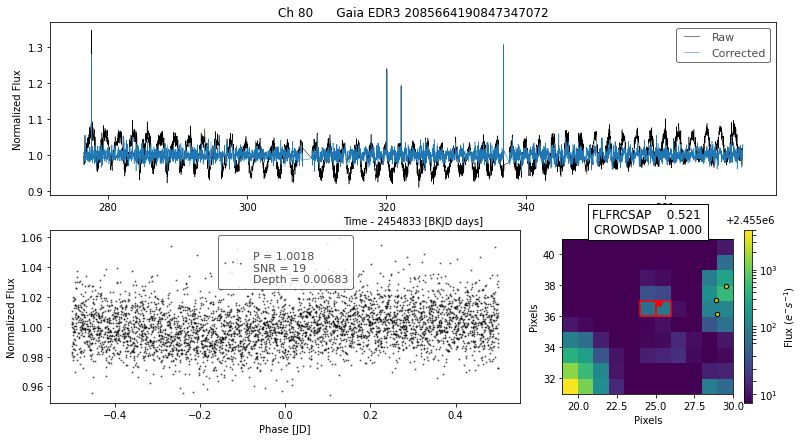

___________________________________________________
designation                Gaia EDR3 2105957090984070912
ra                                            284.923519
ra_error                                        0.008712
dec                                            44.403665
dec_error                                       0.009845
pmra                                           -3.682658
pmdec                                          -4.663238
parallax                                        0.616308
parallax_error                                  0.010238
phot_g_n_obs                                         327
phot_g_mean_flux                          1096770.196778
phot_g_mean_flux_error                         182.70116
phot_g_mean_mag                                10.587078
phot_bp_n_obs                                         36
phot_bp_mean_flux                          447498.856799
phot_bp_mean_flux_error                        259.51074
phot_bp_mean_mag                    

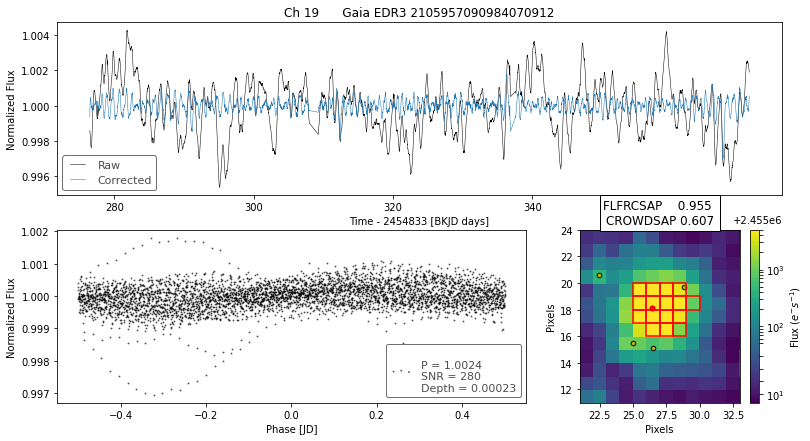

___________________________________________________
designation                Gaia EDR3 2105957125342159232
ra                                            284.923227
ra_error                                        0.127287
dec                                            44.406899
dec_error                                       0.123592
pmra                                             -1.5654
pmdec                                           -1.78873
parallax                                        0.081428
parallax_error                                    0.1358
phot_g_n_obs                                         322
phot_g_mean_flux                               634.65289
phot_g_mean_flux_error                          1.137053
phot_g_mean_mag                                18.681026
phot_bp_n_obs                                         28
phot_bp_mean_flux                             262.816353
phot_bp_mean_flux_error                        17.798285
phot_bp_mean_mag                    

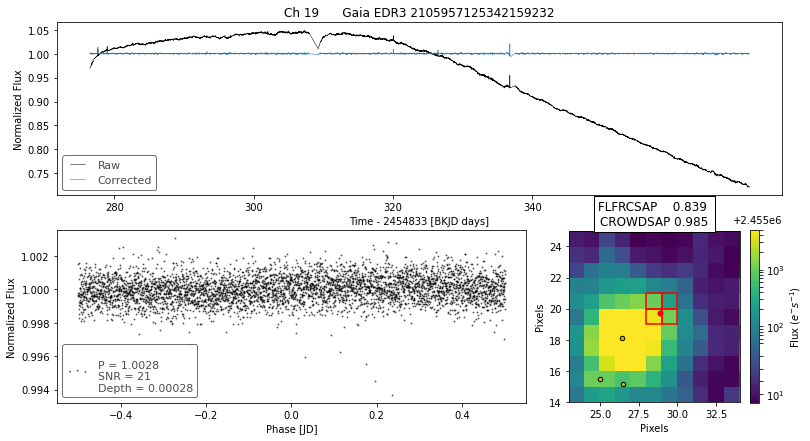

___________________________________________________
designation                Gaia EDR3 2102900959754861440
ra                                            288.472397
ra_error                                        0.081316
dec                                             42.70924
dec_error                                       0.093494
pmra                                            0.998662
pmdec                                             2.7309
parallax                                        0.229695
parallax_error                                  0.094761
phot_g_n_obs                                         378
phot_g_mean_flux                              979.705539
phot_g_mean_flux_error                          2.116154
phot_g_mean_mag                                18.209627
phot_bp_n_obs                                         45
phot_bp_mean_flux                             459.439064
phot_bp_mean_flux_error                         8.833208
phot_bp_mean_mag                    

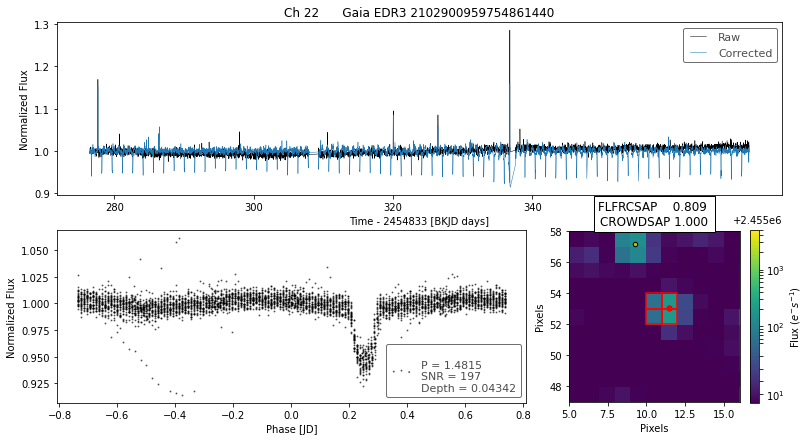

___________________________________________________
designation                Gaia EDR3 2073608462478158848
ra                                             299.01752
ra_error                                        0.017211
dec                                            40.786567
dec_error                                       0.019354
pmra                                           -3.630422
pmdec                                         -12.371369
parallax                                        0.623285
parallax_error                                  0.020522
phot_g_n_obs                                         374
phot_g_mean_flux                            22615.297291
phot_g_mean_flux_error                          6.869354
phot_g_mean_mag                                14.801361
phot_bp_n_obs                                         29
phot_bp_mean_flux                           11029.019917
phot_bp_mean_flux_error                         91.05976
phot_bp_mean_mag                    

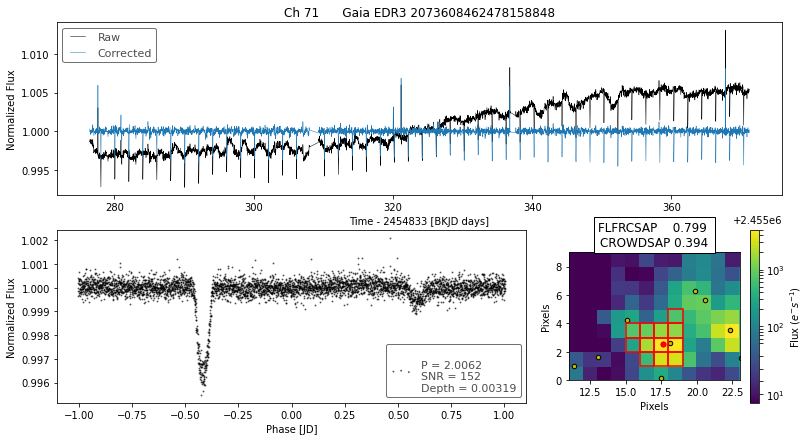

___________________________________________________
designation                Gaia EDR3 2073608462483635968
ra                                            299.016788
ra_error                                        0.067609
dec                                            40.786358
dec_error                                       0.074286
pmra                                           -3.385169
pmdec                                         -12.739628
parallax                                        0.873213
parallax_error                                  0.080893
phot_g_n_obs                                         370
phot_g_mean_flux                            18128.995673
phot_g_mean_flux_error                         15.205032
phot_g_mean_mag                                15.041432
phot_bp_n_obs                                         10
phot_bp_mean_flux                             9473.69542
phot_bp_mean_flux_error                         59.71048
phot_bp_mean_mag                    

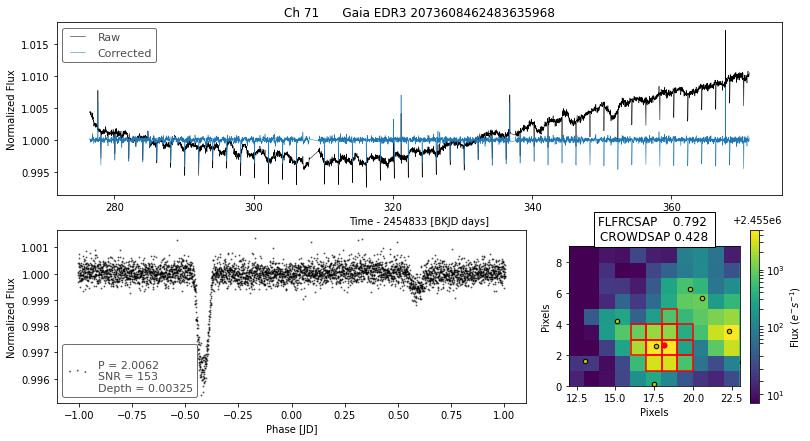

___________________________________________________
designation                Gaia EDR3 2080297753770786944
ra                                            297.416178
ra_error                                        0.065119
dec                                            46.622853
dec_error                                       0.061993
pmra                                           -4.625668
pmdec                                          -5.366603
parallax                                        0.257714
parallax_error                                  0.073858
phot_g_n_obs                                         337
phot_g_mean_flux                             1637.696521
phot_g_mean_flux_error                          1.603411
phot_g_mean_mag                                17.651783
phot_bp_n_obs                                         38
phot_bp_mean_flux                             777.812483
phot_bp_mean_flux_error                         9.080527
phot_bp_mean_mag                    

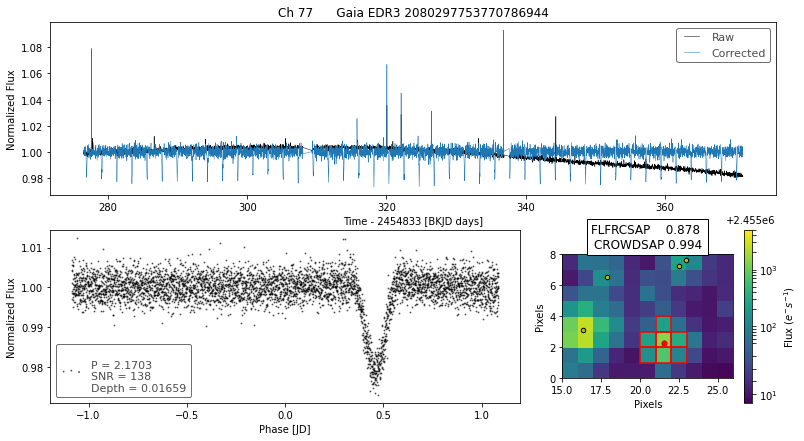

___________________________________________________
designation                Gaia EDR3 2080297753765423744
ra                                            297.416069
ra_error                                        0.291124
dec                                            46.622287
dec_error                                       0.273578
pmra                                            -1.92573
pmdec                                          -1.622342
parallax                                       -0.070851
parallax_error                                  0.318923
phot_g_n_obs                                         333
phot_g_mean_flux                              196.818873
phot_g_mean_flux_error                          0.978384
phot_g_mean_mag                                  19.9522
phot_bp_n_obs                                          2
phot_bp_mean_flux                             127.673163
phot_bp_mean_flux_error                          3.32756
phot_bp_mean_mag                    

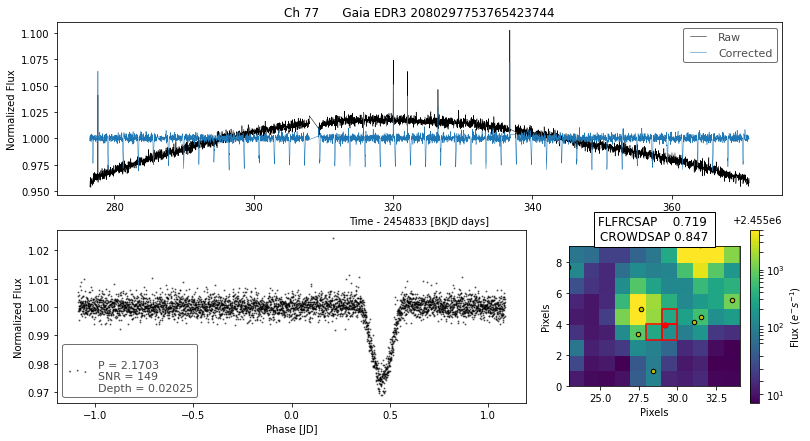

___________________________________________________
designation                Gaia EDR3 2076789723264288512
ra                                            296.916803
ra_error                                        0.096922
dec                                            41.208266
dec_error                                       0.116404
pmra                                           -0.694636
pmdec                                           0.422271
parallax                                        0.373302
parallax_error                                  0.122338
phot_g_n_obs                                         409
phot_g_mean_flux                              727.546609
phot_g_mean_flux_error                          1.028774
phot_g_mean_mag                                18.532715
phot_bp_n_obs                                         50
phot_bp_mean_flux                             309.378534
phot_bp_mean_flux_error                         5.296431
phot_bp_mean_mag                    

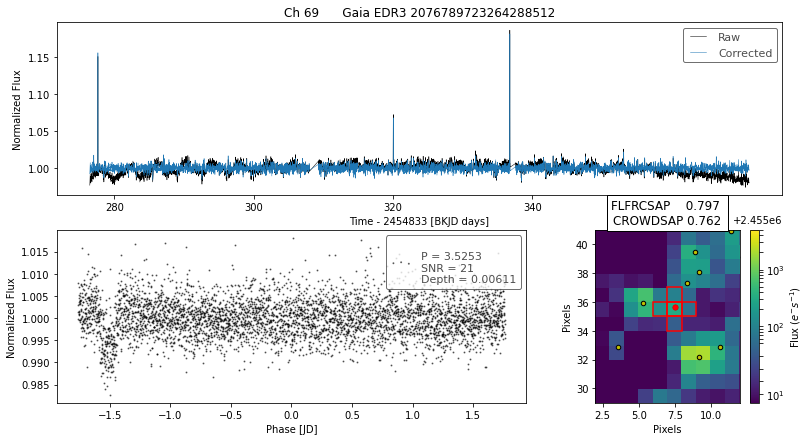

___________________________________________________
designation                Gaia EDR3 2076789727566520192
ra                                             296.91419
ra_error                                        0.042113
dec                                            41.206797
dec_error                                        0.04951
pmra                                           -2.146678
pmdec                                          -5.677354
parallax                                        0.262355
parallax_error                                  0.052285
phot_g_n_obs                                         410
phot_g_mean_flux                             2629.039538
phot_g_mean_flux_error                          4.639497
phot_g_mean_mag                                17.137875
phot_bp_n_obs                                         51
phot_bp_mean_flux                            1175.317974
phot_bp_mean_flux_error                        13.248578
phot_bp_mean_mag                    

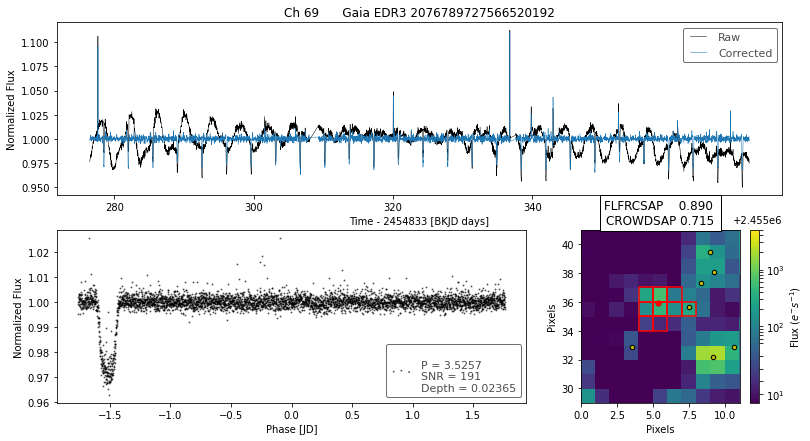

___________________________________________________
designation                Gaia EDR3 2078735858841858944
ra                                            297.193149
ra_error                                        0.158078
dec                                            43.291355
dec_error                                       0.199179
pmra                                           -1.393323
pmdec                                          -3.375459
parallax                                        0.154385
parallax_error                                  0.199826
phot_g_n_obs                                         358
phot_g_mean_flux                              391.662971
phot_g_mean_flux_error                          0.865765
phot_g_mean_mag                                19.205086
phot_bp_n_obs                                         38
phot_bp_mean_flux                             198.750301
phot_bp_mean_flux_error                         5.843695
phot_bp_mean_mag                    

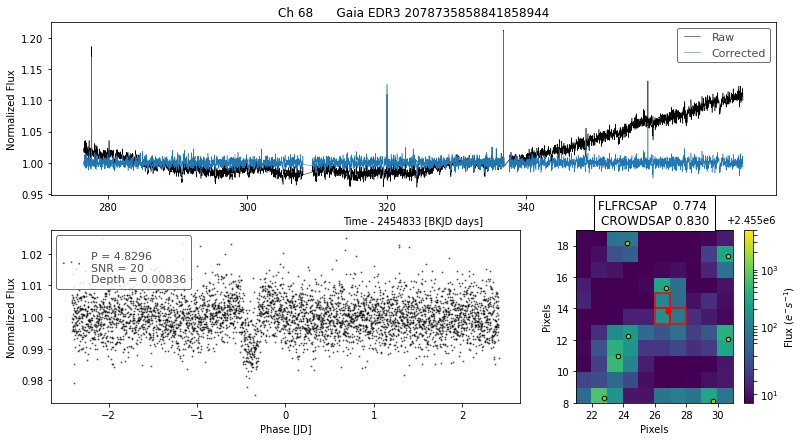

___________________________________________________
designation                Gaia EDR3 2078735858841858816
ra                                            297.191294
ra_error                                        0.099944
dec                                            43.290412
dec_error                                       0.121274
pmra                                           -2.620205
pmdec                                          -3.518845
parallax                                        0.147843
parallax_error                                  0.121798
phot_g_n_obs                                         375
phot_g_mean_flux                              757.332829
phot_g_mean_flux_error                          1.113284
phot_g_mean_mag                                 18.48915
phot_bp_n_obs                                         43
phot_bp_mean_flux                             341.200359
phot_bp_mean_flux_error                         8.549059
phot_bp_mean_mag                    

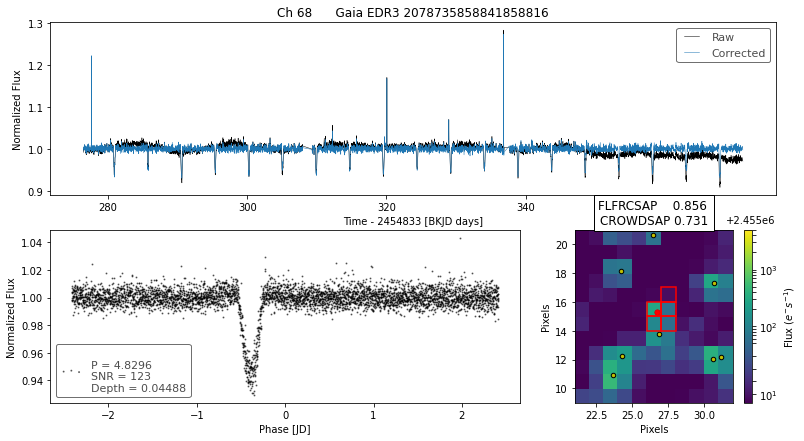

___________________________________________________
designation                Gaia EDR3 2075404785289028992
ra                                            298.337454
ra_error                                        0.098587
dec                                            41.760876
dec_error                                       0.109919
pmra                                            3.748415
pmdec                                           4.071209
parallax                                        1.251449
parallax_error                                   0.11802
phot_g_n_obs                                         424
phot_g_mean_flux                               745.26424
phot_g_mean_flux_error                          1.029563
phot_g_mean_mag                                18.506592
phot_bp_n_obs                                         45
phot_bp_mean_flux                             182.193939
phot_bp_mean_flux_error                         9.040791
phot_bp_mean_mag                    

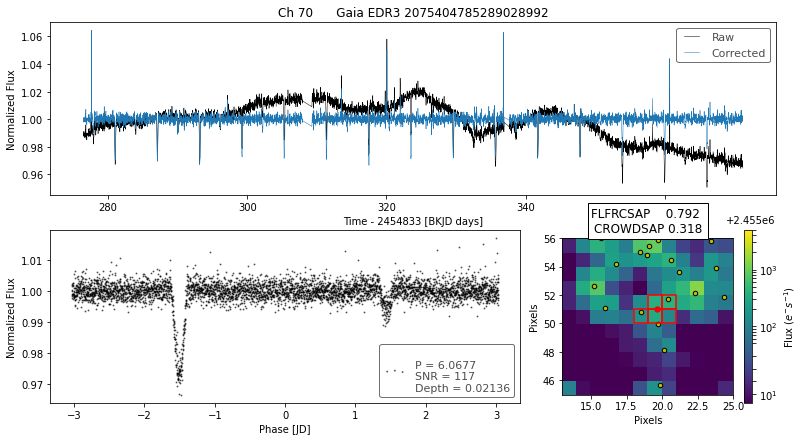

___________________________________________________
designation                Gaia EDR3 2075404789588537984
ra                                            298.336634
ra_error                                        0.112349
dec                                            41.761897
dec_error                                       0.124624
pmra                                           -2.368483
pmdec                                          -3.785788
parallax                                        0.189888
parallax_error                                   0.13351
phot_g_n_obs                                         423
phot_g_mean_flux                              593.011438
phot_g_mean_flux_error                          1.010938
phot_g_mean_mag                                 18.75471
phot_bp_n_obs                                         43
phot_bp_mean_flux                             273.858234
phot_bp_mean_flux_error                         6.354177
phot_bp_mean_mag                    

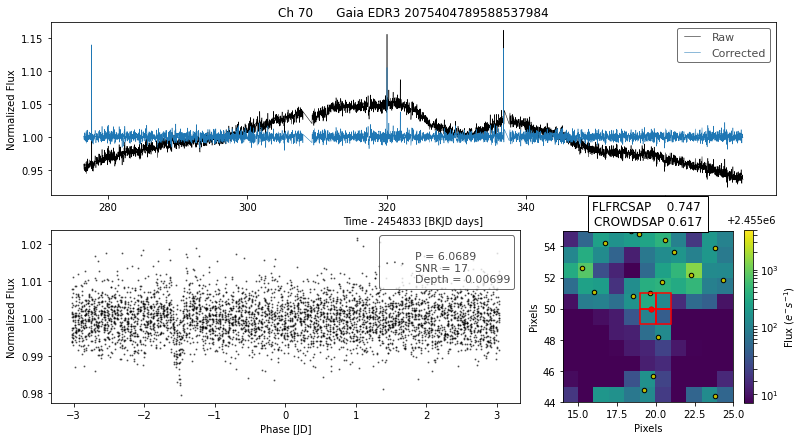

___________________________________________________
designation                Gaia EDR3 2079399006085883008
ra                                            298.533763
ra_error                                        0.396337
dec                                            45.149585
dec_error                                       0.278017
pmra                                           -9.836919
pmdec                                          -8.365289
parallax                                        1.200379
parallax_error                                  0.374478
phot_g_n_obs                                         293
phot_g_mean_flux                              448.536324
phot_g_mean_flux_error                           1.94805
phot_g_mean_mag                                19.057873
phot_bp_n_obs                                          0
phot_bp_mean_flux                100000000000000000000.0
phot_bp_mean_flux_error          100000000000000000000.0
phot_bp_mean_mag                 100

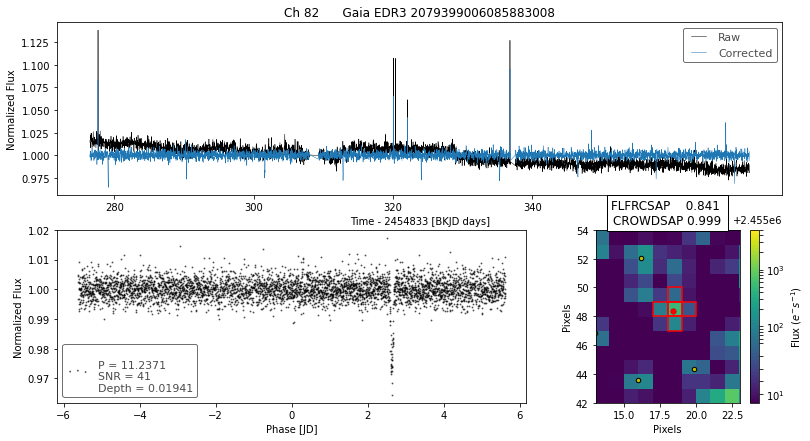

___________________________________________________
designation                Gaia EDR3 2079399006094147840
ra                                            298.533738
ra_error                                        0.231009
dec                                            45.149958
dec_error                                       0.233908
pmra                                           -2.382727
pmdec                                          -4.556883
parallax                                       -0.440488
parallax_error                                  0.258557
phot_g_n_obs                                         386
phot_g_mean_flux                              547.274802
phot_g_mean_flux_error                          1.916271
phot_g_mean_mag                                18.841854
phot_bp_n_obs                                         43
phot_bp_mean_flux                             325.167224
phot_bp_mean_flux_error                         8.570968
phot_bp_mean_mag                    

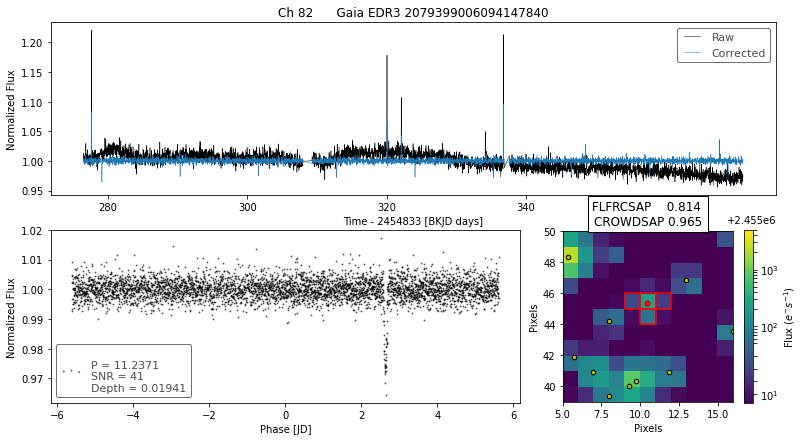

___________________________________________________
designation                Gaia EDR3 2077246024892437120
ra                                            295.904164
ra_error                                        4.970892
dec                                            42.746807
dec_error                                       5.207295
pmra                             100000000000000000000.0
pmdec                            100000000000000000000.0
parallax                         100000000000000000000.0
parallax_error                   100000000000000000000.0
phot_g_n_obs                                         370
phot_g_mean_flux                             2151.646932
phot_g_mean_flux_error                         31.372139
phot_g_mean_mag                                 17.35544
phot_bp_n_obs                                         41
phot_bp_mean_flux                            1550.371602
phot_bp_mean_flux_error                         9.604742
phot_bp_mean_mag                    

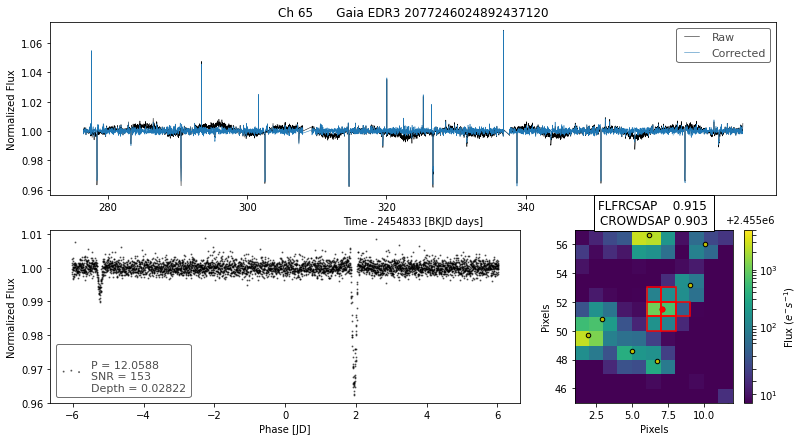

___________________________________________________
designation                Gaia EDR3 2086592354751514624
ra                                            296.591172
ra_error                                        0.230378
dec                                            47.648774
dec_error                                       0.236403
pmra                                           -1.183823
pmdec                                          -2.840791
parallax                                       -0.067606
parallax_error                                  0.248336
phot_g_n_obs                                         324
phot_g_mean_flux                              312.236955
phot_g_mean_flux_error                          0.947375
phot_g_mean_mag                                19.451157
phot_bp_n_obs                                         14
phot_bp_mean_flux                             173.749174
phot_bp_mean_flux_error                         9.450015
phot_bp_mean_mag                    

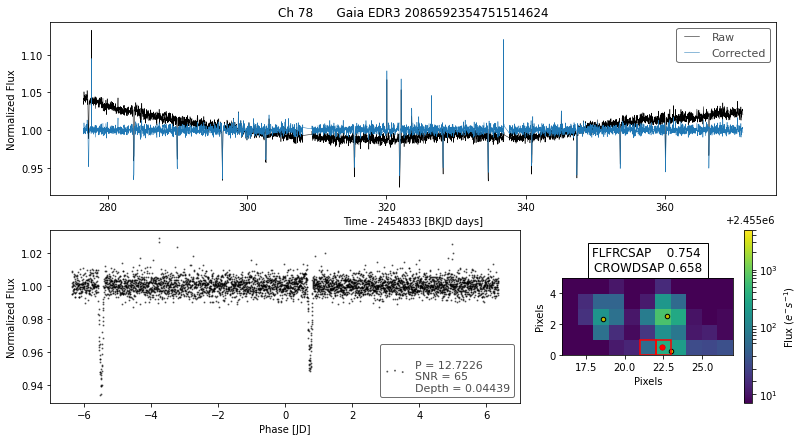

___________________________________________________
designation                Gaia EDR3 2086592354758573568
ra                                            296.590021
ra_error                                        0.106882
dec                                            47.648133
dec_error                                       0.105121
pmra                                           -3.105424
pmdec                                          -5.458909
parallax                                        0.164015
parallax_error                                  0.112873
phot_g_n_obs                                         343
phot_g_mean_flux                              855.000117
phot_g_mean_flux_error                          1.284049
phot_g_mean_mag                                 18.35745
phot_bp_n_obs                                         35
phot_bp_mean_flux                             429.902784
phot_bp_mean_flux_error                         6.076149
phot_bp_mean_mag                    

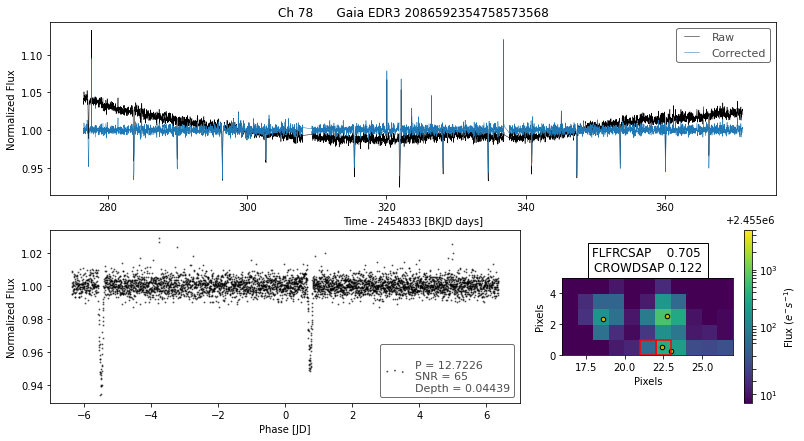

___________________________________________________
designation                Gaia EDR3 2086592350456692864
ra                                            296.591359
ra_error                                        0.112192
dec                                            47.648079
dec_error                                       0.110208
pmra                                           -3.217573
pmdec                                          -5.258531
parallax                                       -0.030694
parallax_error                                  0.118239
phot_g_n_obs                                         344
phot_g_mean_flux                              796.099351
phot_g_mean_flux_error                          1.250683
phot_g_mean_mag                                18.434948
phot_bp_n_obs                                         27
phot_bp_mean_flux                             402.002522
phot_bp_mean_flux_error                         8.883858
phot_bp_mean_mag                    

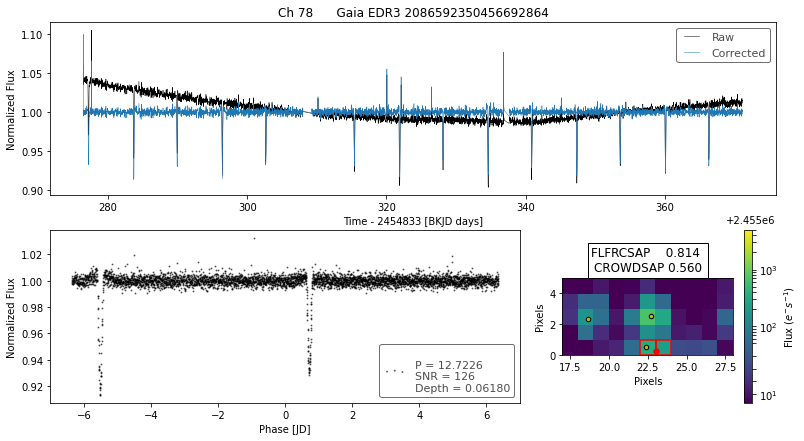

___________________________________________________
designation                Gaia EDR3 2076789727566523648
ra                                            296.920671
ra_error                                        0.092781
dec                                            41.206784
dec_error                                       0.106689
pmra                                           -2.071991
pmdec                                          -3.577216
parallax                                        0.152983
parallax_error                                  0.112583
phot_g_n_obs                                         408
phot_g_mean_flux                              796.393907
phot_g_mean_flux_error                          1.093759
phot_g_mean_mag                                18.434547
phot_bp_n_obs                                         48
phot_bp_mean_flux                             355.926086
phot_bp_mean_flux_error                         5.033815
phot_bp_mean_mag                    

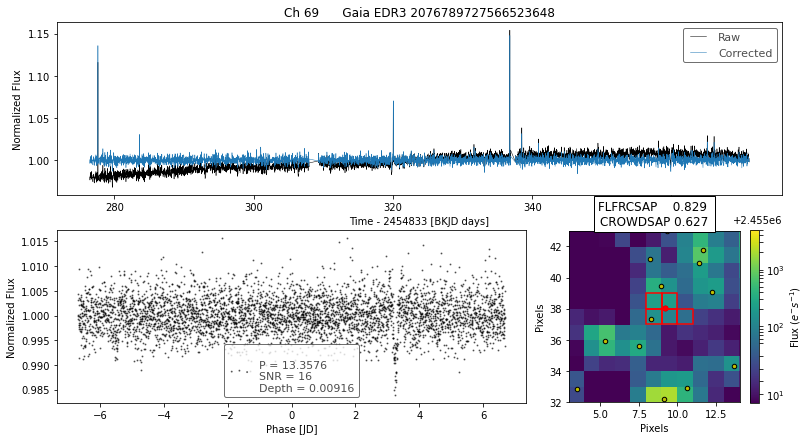

___________________________________________________
designation                Gaia EDR3 2076789723264283008
ra                                            296.921321
ra_error                                         0.08201
dec                                            41.205258
dec_error                                       0.094853
pmra                                           -3.602138
pmdec                                          -5.251992
parallax                                        0.203913
parallax_error                                  0.100966
phot_g_n_obs                                         415
phot_g_mean_flux                             1001.236382
phot_g_mean_flux_error                          1.133073
phot_g_mean_mag                                18.186026
phot_bp_n_obs                                         48
phot_bp_mean_flux                             443.898999
phot_bp_mean_flux_error                         5.683253
phot_bp_mean_mag                    

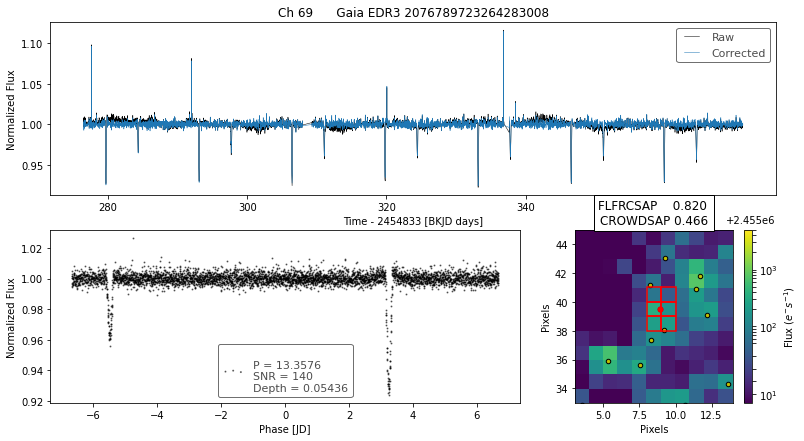

___________________________________________________
designation                Gaia EDR3 2076209460306595328
ra                                            295.752461
ra_error                                        0.019373
dec                                            39.462321
dec_error                                       0.019968
pmra                                           -3.720484
pmdec                                          -4.819555
parallax                                        0.095109
parallax_error                                  0.023232
phot_g_n_obs                                         373
phot_g_mean_flux                            13895.241146
phot_g_mean_flux_error                          3.971369
phot_g_mean_mag                                15.330202
phot_bp_n_obs                                         42
phot_bp_mean_flux                            5273.107734
phot_bp_mean_flux_error                        11.611184
phot_bp_mean_mag                    

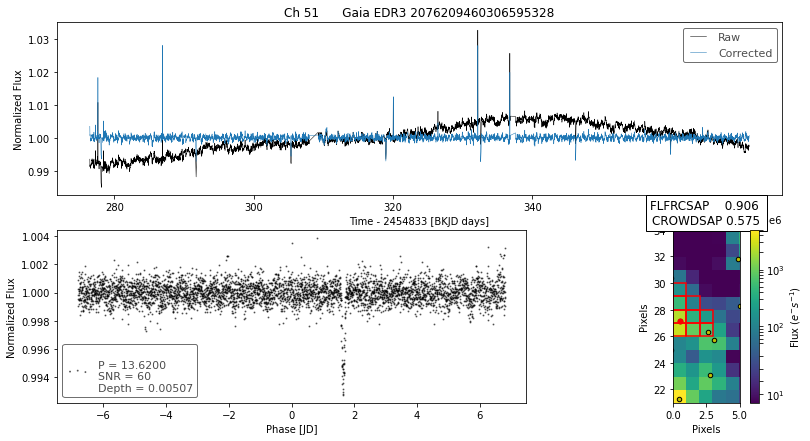

___________________________________________________
designation                Gaia EDR3 2076209460306591744
ra                                            295.750477
ra_error                                        0.067144
dec                                            39.460341
dec_error                                       0.072642
pmra                                           -1.197083
pmdec                                          -2.815009
parallax                                        0.066803
parallax_error                                  0.082797
phot_g_n_obs                                         355
phot_g_mean_flux                             2454.959996
phot_g_mean_flux_error                          3.321068
phot_g_mean_mag                                17.212255
phot_bp_n_obs                                         42
phot_bp_mean_flux                            1144.069703
phot_bp_mean_flux_error                          8.44169
phot_bp_mean_mag                    

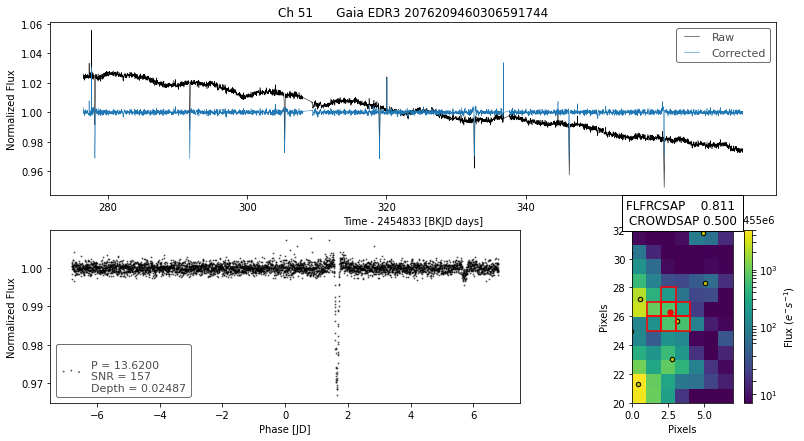

___________________________________________________
designation                Gaia EDR3 2076209456001789056
ra                                            295.750317
ra_error                                        0.058765
dec                                            39.459486
dec_error                                       0.064583
pmra                                           -3.491848
pmdec                                          -4.958719
parallax                                        0.331256
parallax_error                                  0.072769
phot_g_n_obs                                         351
phot_g_mean_flux                             2041.252041
phot_g_mean_flux_error                          1.644656
phot_g_mean_mag                                17.412624
phot_bp_n_obs                                         23
phot_bp_mean_flux                             896.049305
phot_bp_mean_flux_error                        10.539346
phot_bp_mean_mag                    

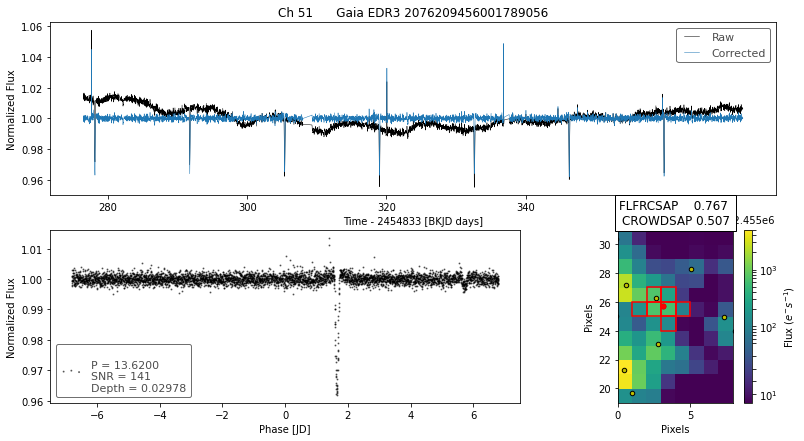

___________________________________________________
designation                Gaia EDR3 2105958396653920384
ra                                            284.997779
ra_error                                        0.131644
dec                                            44.409722
dec_error                                       0.137773
pmra                                            -2.79742
pmdec                                          -7.534314
parallax                                        0.505423
parallax_error                                  0.144331
phot_g_n_obs                                         366
phot_g_mean_flux                              506.058136
phot_g_mean_flux_error                          1.570462
phot_g_mean_mag                                18.926867
phot_bp_n_obs                                         11
phot_bp_mean_flux                             330.232526
phot_bp_mean_flux_error                        30.648544
phot_bp_mean_mag                    

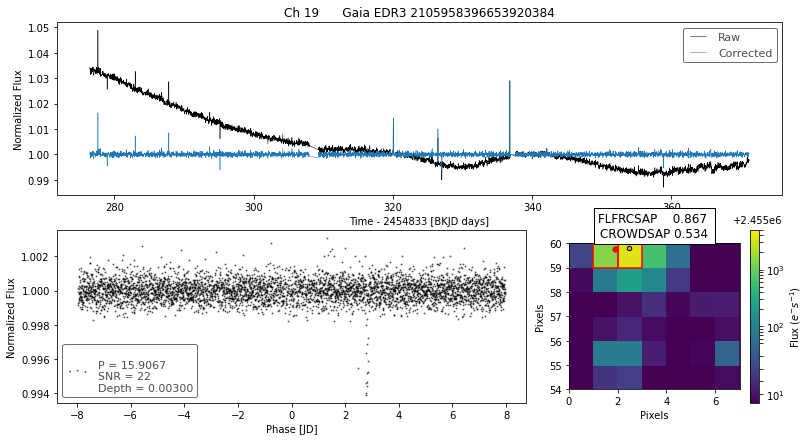

___________________________________________________
designation                Gaia EDR3 2085661373348818176
ra                                            298.898473
ra_error                                         0.12655
dec                                            47.152437
dec_error                                       0.138159
pmra                                           -2.820872
pmdec                                          -4.669196
parallax                                        0.058612
parallax_error                                  0.149333
phot_g_n_obs                                         360
phot_g_mean_flux                              604.933452
phot_g_mean_flux_error                          1.015409
phot_g_mean_mag                                18.733097
phot_bp_n_obs                                         41
phot_bp_mean_flux                             290.723142
phot_bp_mean_flux_error                         7.832464
phot_bp_mean_mag                    

/Users/jorgemarpa/.pyenv/versions/adap/lib/python3.8/site-packages/lightkurve/lightcurve.py:982: LightkurveWarning: The light curve has a negative median flux (-3.37e+02 electron / s); `normalize()` will therefore divide by a negative number and invert the light curve, which is probablynot what you want
  warnings.warn(
/Users/jorgemarpa/.pyenv/versions/adap/lib/python3.8/site-packages/lightkurve/lightcurve.py:982: LightkurveWarning: The light curve has a negative median flux (-3.37e+02 electron / s); `normalize()` will therefore divide by a negative number and invert the light curve, which is probablynot what you want
  warnings.warn(
/Users/jorgemarpa/.pyenv/versions/adap/lib/python3.8/site-packages/lightkurve/lightcurve.py:982: LightkurveWarning: The light curve has a negative median flux (-3.37e+02 electron / s); `normalize()` will therefore divide by a negative number and invert the light curve, which is probablynot what you want
  warnings.warn(


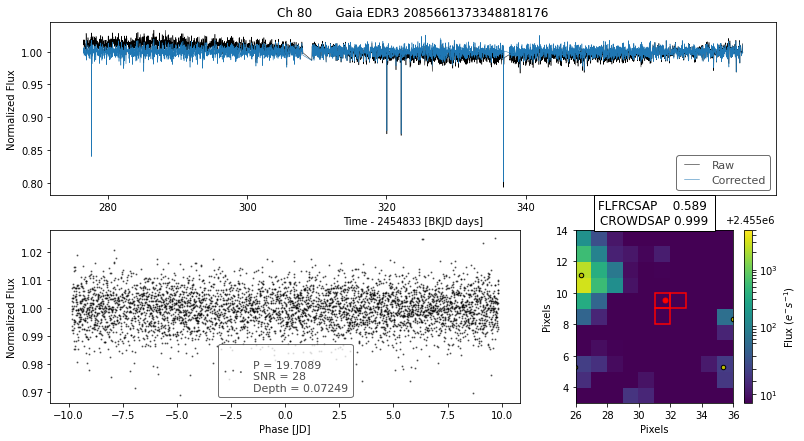

___________________________________________________
designation                Gaia EDR3 2106327626401850880
ra                                            286.152336
ra_error                                        0.321177
dec                                            45.047535
dec_error                                       0.330142
pmra                                           -4.759576
pmdec                                          -6.254452
parallax                                       -0.331044
parallax_error                                  0.353882
phot_g_n_obs                                         340
phot_g_mean_flux                              192.671547
phot_g_mean_flux_error                          0.718506
phot_g_mean_mag                                19.975323
phot_bp_n_obs                                         35
phot_bp_mean_flux                               77.90195
phot_bp_mean_flux_error                         5.398607
phot_bp_mean_mag                    

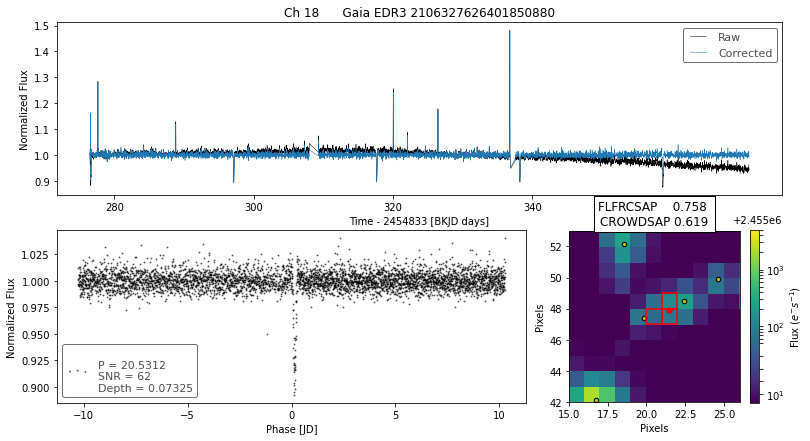

___________________________________________________
designation                Gaia EDR3 2075121557967458560
ra                                            298.998725
ra_error                                        0.137376
dec                                            40.839129
dec_error                                       0.151077
pmra                                           -5.000441
pmdec                                          -8.934792
parallax                                        0.139393
parallax_error                                  0.172518
phot_g_n_obs                                         331
phot_g_mean_flux                              488.998017
phot_g_mean_flux_error                           1.06287
phot_g_mean_mag                                  18.9641
phot_bp_n_obs                                         33
phot_bp_mean_flux                             215.270007
phot_bp_mean_flux_error                         4.861874
phot_bp_mean_mag                    

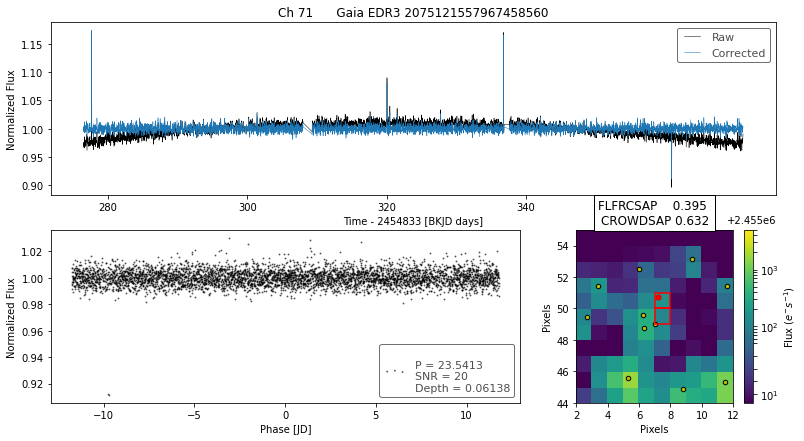

___________________________________________________
designation                Gaia EDR3 2130912843837194624
ra                                            288.672169
ra_error                                        0.110265
dec                                            47.636358
dec_error                                       0.112138
pmra                                           -1.262303
pmdec                                           0.033584
parallax                                        0.378002
parallax_error                                  0.116096
phot_g_n_obs                                         310
phot_g_mean_flux                              894.055519
phot_g_mean_flux_error                          1.423857
phot_g_mean_mag                                18.308956
phot_bp_n_obs                                         32
phot_bp_mean_flux                             428.612062
phot_bp_mean_flux_error                        10.401048
phot_bp_mean_mag                    

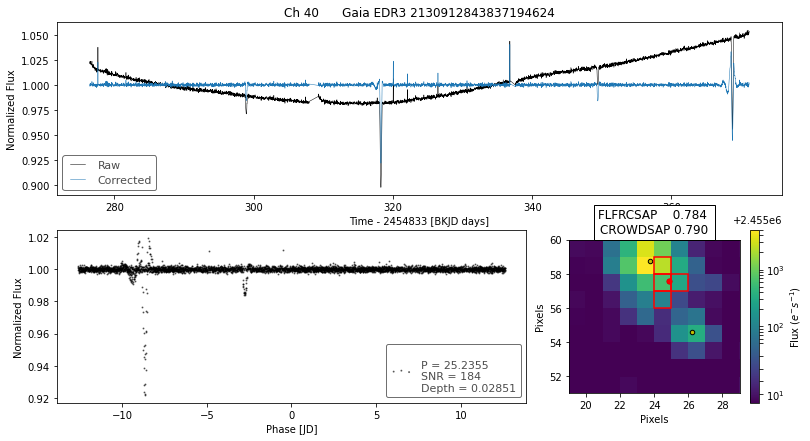

___________________________________________________
designation                Gaia EDR3 2130912843839236224
ra                                            288.674766
ra_error                                        0.019987
dec                                             47.63598
dec_error                                       0.019822
pmra                                           -1.045451
pmdec                                          -4.399511
parallax                                        0.501445
parallax_error                                  0.020195
phot_g_n_obs                                         298
phot_g_mean_flux                            22267.215371
phot_g_mean_flux_error                          6.282117
phot_g_mean_mag                                14.818202
phot_bp_n_obs                                         33
phot_bp_mean_flux                           11638.424549
phot_bp_mean_flux_error                        18.528519
phot_bp_mean_mag                    

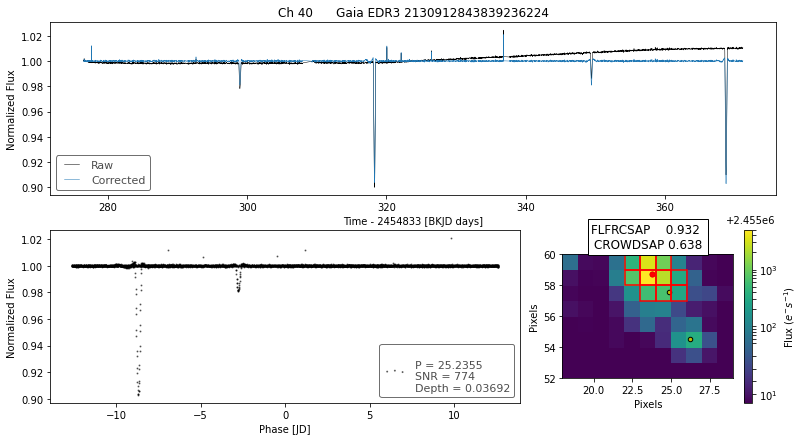

___________________________________________________
designation                Gaia EDR3 2129145894293973888
ra                                            291.612266
ra_error                                        0.011315
dec                                            47.678709
dec_error                                        0.01239
pmra                                            1.438604
pmdec                                          -5.292902
parallax                                        1.013614
parallax_error                                  0.012549
phot_g_n_obs                                         317
phot_g_mean_flux                            59114.615735
phot_g_mean_flux_error                         13.978579
phot_g_mean_mag                                 13.75813
phot_bp_n_obs                                         35
phot_bp_mean_flux                           34067.904701
phot_bp_mean_flux_error                         30.34173
phot_bp_mean_mag                    

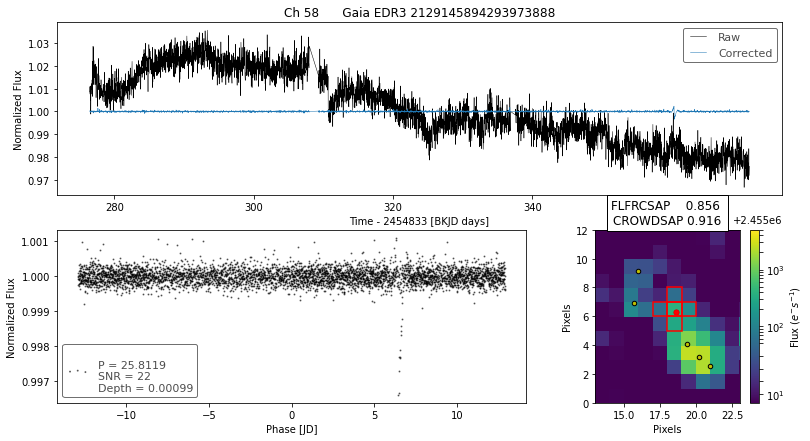

___________________________________________________
designation                Gaia EDR3 2135369061388281216
ra                                            295.931646
ra_error                                        0.013205
dec                                            50.689994
dec_error                                       0.014624
pmra                                           -3.090355
pmdec                                          -6.673468
parallax                                        0.920523
parallax_error                                  0.014628
phot_g_n_obs                                         347
phot_g_mean_flux                            32246.787389
phot_g_mean_flux_error                          8.211797
phot_g_mean_mag                                14.416151
phot_bp_n_obs                                         38
phot_bp_mean_flux                           17773.528028
phot_bp_mean_flux_error                         20.31522
phot_bp_mean_mag                    

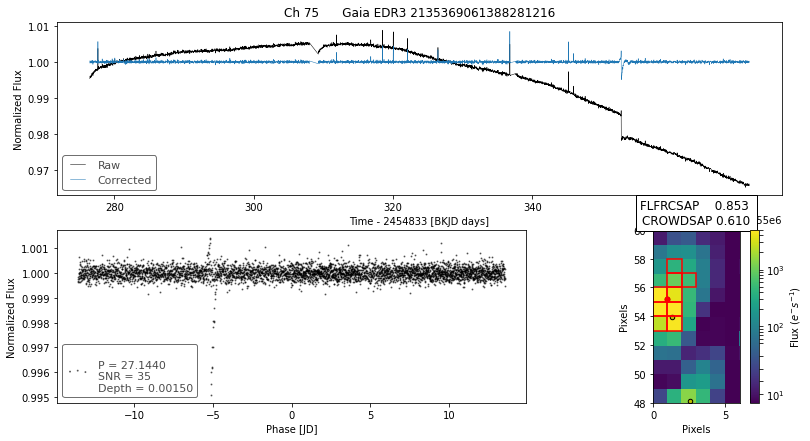

___________________________________________________
designation                Gaia EDR3 2101034130752358912
ra                                            289.302961
ra_error                                        0.094406
dec                                            39.764836
dec_error                                       0.104547
pmra                                           -1.183424
pmdec                                          -6.419827
parallax                                        0.347187
parallax_error                                  0.108241
phot_g_n_obs                                         370
phot_g_mean_flux                             1034.716618
phot_g_mean_flux_error                          1.251075
phot_g_mean_mag                                18.150312
phot_bp_n_obs                                         40
phot_bp_mean_flux                             458.977955
phot_bp_mean_flux_error                         7.214319
phot_bp_mean_mag                    

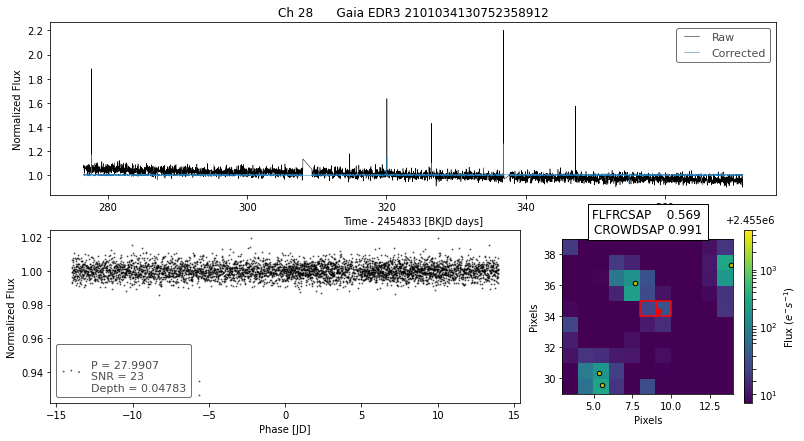

___________________________________________________
designation                Gaia EDR3 2076505052828671488
ra                                            295.016545
ra_error                                        0.133699
dec                                            40.387808
dec_error                                       0.166671
pmra                                           -4.812044
pmdec                                          -2.446572
parallax                                        0.288449
parallax_error                                  0.173894
phot_g_n_obs                                         363
phot_g_mean_flux                              436.177644
phot_g_mean_flux_error                          0.910868
phot_g_mean_mag                                 19.08821
phot_bp_n_obs                                         43
phot_bp_mean_flux                             167.791981
phot_bp_mean_flux_error                         4.779528
phot_bp_mean_mag                    

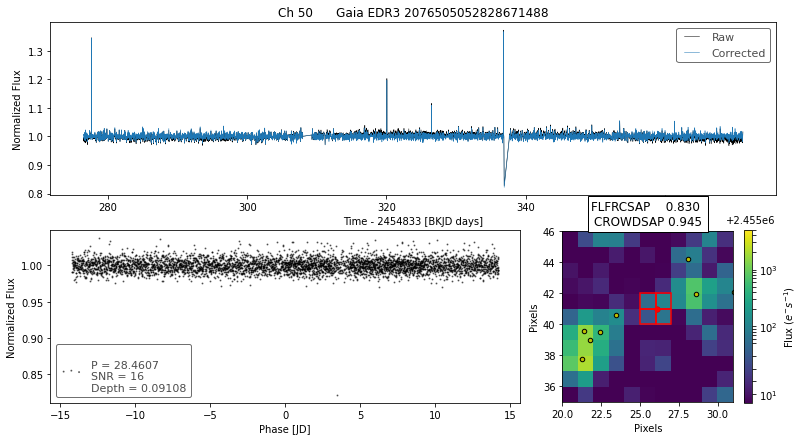

___________________________________________________
designation                Gaia EDR3 2076209322867601280
ra                                            295.711323
ra_error                                        0.049002
dec                                             39.46373
dec_error                                       0.052738
pmra                                           -2.893804
pmdec                                          -4.574982
parallax                                        0.512281
parallax_error                                  0.060199
phot_g_n_obs                                         356
phot_g_mean_flux                             2387.650062
phot_g_mean_flux_error                          1.645408
phot_g_mean_mag                                 17.24244
phot_bp_n_obs                                         41
phot_bp_mean_flux                            1086.512208
phot_bp_mean_flux_error                         7.402676
phot_bp_mean_mag                    

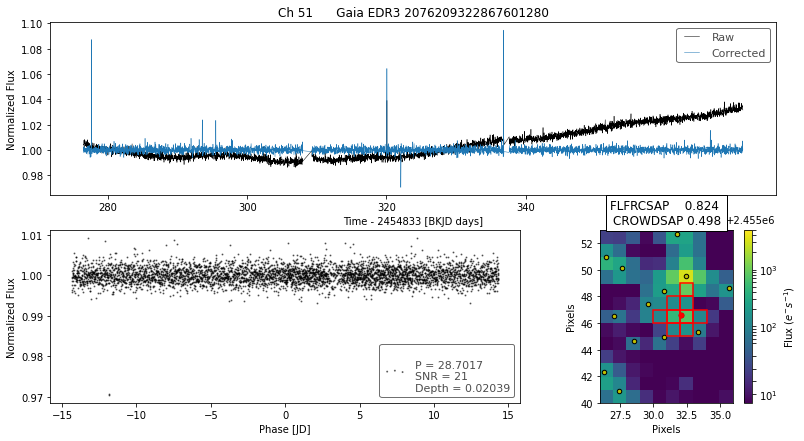

___________________________________________________
designation                Gaia EDR3 2076208287770560768
ra                                            295.739683
ra_error                                        0.104915
dec                                            39.426435
dec_error                                       0.127071
pmra                                           -2.552467
pmdec                                           -4.37732
parallax                                       -0.048425
parallax_error                                  0.135079
phot_g_n_obs                                         336
phot_g_mean_flux                              706.123947
phot_g_mean_flux_error                          1.110471
phot_g_mean_mag                                18.565165
phot_bp_n_obs                                         43
phot_bp_mean_flux                             337.269701
phot_bp_mean_flux_error                          5.18151
phot_bp_mean_mag                    

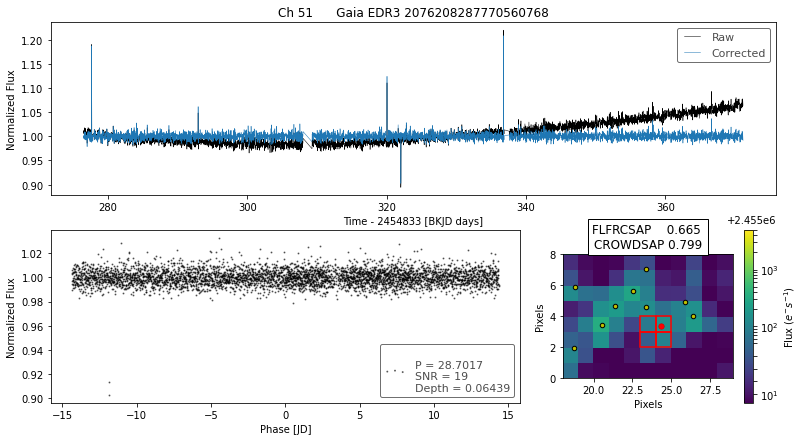

___________________________________________________
designation                Gaia EDR3 2076209043684835072
ra                                            295.732729
ra_error                                        0.217946
dec                                             39.43469
dec_error                                       0.238264
pmra                                           -1.331395
pmdec                                          -4.387116
parallax                                         0.30609
parallax_error                                  0.266139
phot_g_n_obs                                         349
phot_g_mean_flux                              262.448295
phot_g_mean_flux_error                          0.775744
phot_g_mean_mag                                19.639757
phot_bp_n_obs                                         41
phot_bp_mean_flux                             117.156545
phot_bp_mean_flux_error                         8.089807
phot_bp_mean_mag                    

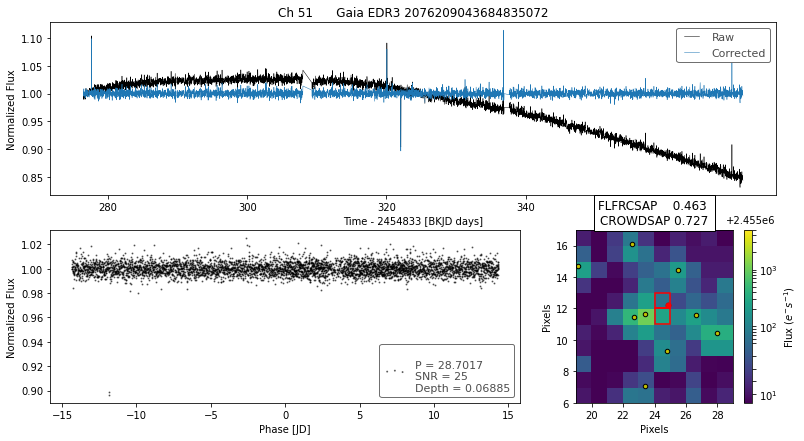

___________________________________________________
designation                Gaia EDR3 2101033924593926016
ra                                             289.31293
ra_error                                        0.269234
dec                                             39.75244
dec_error                                       0.279199
pmra                                           -1.752091
pmdec                                          -6.738801
parallax                                       -0.157144
parallax_error                                   0.29821
phot_g_n_obs                                         323
phot_g_mean_flux                              280.291978
phot_g_mean_flux_error                          0.891848
phot_g_mean_mag                                 19.56834
phot_bp_n_obs                                         36
phot_bp_mean_flux                             126.483521
phot_bp_mean_flux_error                         5.707222
phot_bp_mean_mag                    

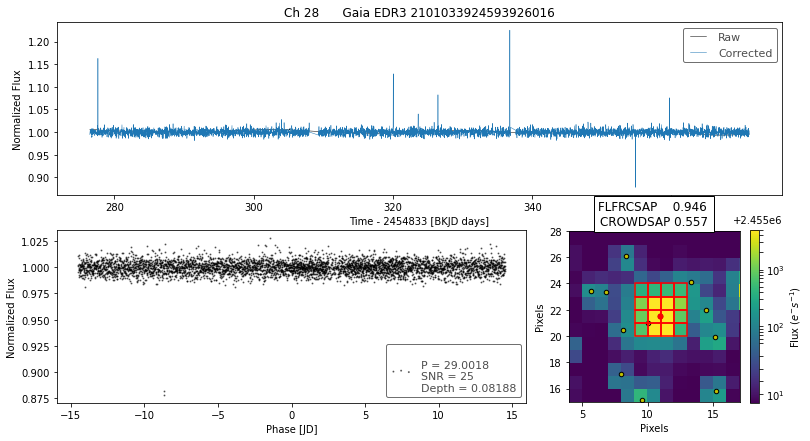

___________________________________________________
designation                Gaia EDR3 2099202718034832640
ra                                            286.409331
ra_error                                        0.013124
dec                                            38.150048
dec_error                                       0.016635
pmra                                           -0.676612
pmdec                                           0.706088
parallax                                         0.17563
parallax_error                                  0.016323
phot_g_n_obs                                         399
phot_g_mean_flux                           264050.064524
phot_g_mean_flux_error                          422.1332
phot_g_mean_mag                                12.133151
phot_bp_n_obs                                         42
phot_bp_mean_flux                           43978.494411
phot_bp_mean_flux_error                        365.75015
phot_bp_mean_mag                    

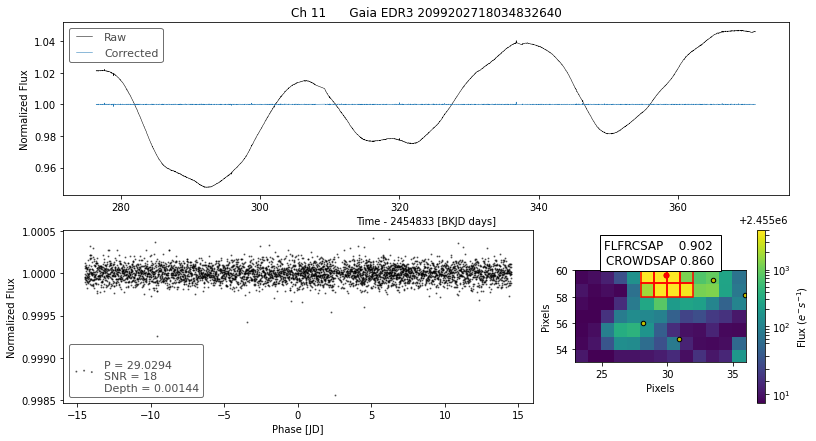

___________________________________________________
designation                Gaia EDR3 2078115807306524672
ra                                            295.083092
ra_error                                        0.068493
dec                                            43.803005
dec_error                                       0.071494
pmra                                           -9.819878
pmdec                                          -8.886761
parallax                                        0.426177
parallax_error                                  0.078861
phot_g_n_obs                                         333
phot_g_mean_flux                             1627.136954
phot_g_mean_flux_error                          1.595786
phot_g_mean_mag                                17.658806
phot_bp_n_obs                                         39
phot_bp_mean_flux                             771.776063
phot_bp_mean_flux_error                         8.388444
phot_bp_mean_mag                    

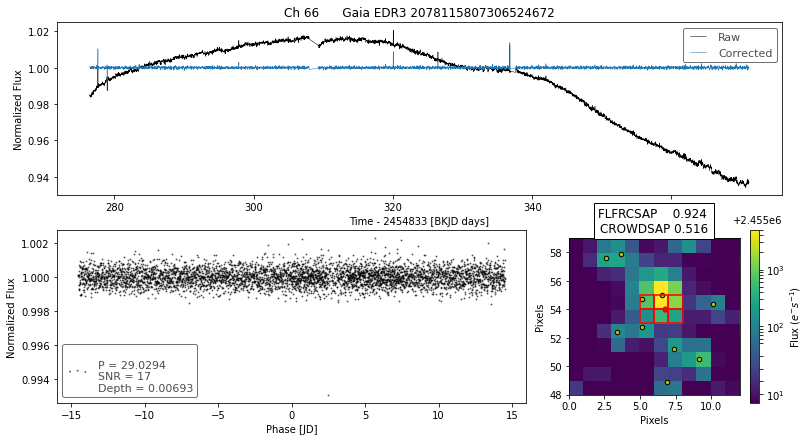

___________________________________________________
designation                Gaia EDR3 2079019807723929088
ra                                            299.355641
ra_error                                        0.039104
dec                                            44.112566
dec_error                                       0.041553
pmra                                            2.686325
pmdec                                          -3.121136
parallax                                        0.571506
parallax_error                                  0.044792
phot_g_n_obs                                         364
phot_g_mean_flux                             3835.002358
phot_g_mean_flux_error                          2.403667
phot_g_mean_mag                                16.727953
phot_bp_n_obs                                         41
phot_bp_mean_flux                            1942.715024
phot_bp_mean_flux_error                         34.43179
phot_bp_mean_mag                    

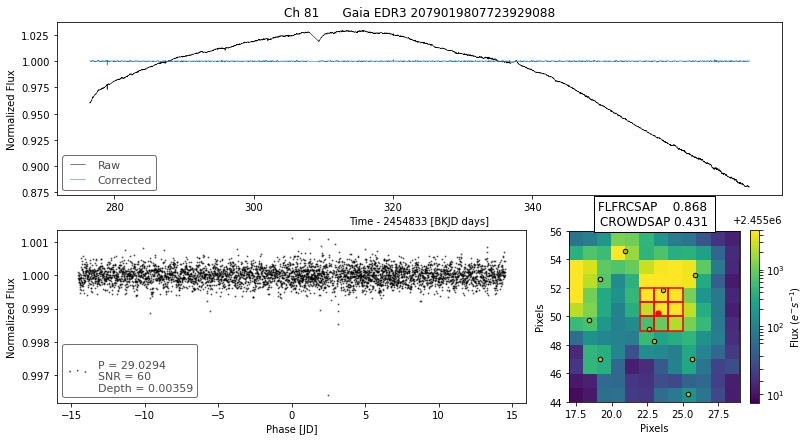

___________________________________________________
designation                Gaia EDR3 2052502752660278912
ra                                            293.643736
ra_error                                        0.043752
dec                                            39.806678
dec_error                                       0.047937
pmra                                           -2.380675
pmdec                                           -0.01375
parallax                                        0.111981
parallax_error                                  0.053879
phot_g_n_obs                                         374
phot_g_mean_flux                             2912.619007
phot_g_mean_flux_error                          1.991453
phot_g_mean_mag                                17.026657
phot_bp_n_obs                                         43
phot_bp_mean_flux                            1424.956281
phot_bp_mean_flux_error                         7.620065
phot_bp_mean_mag                    

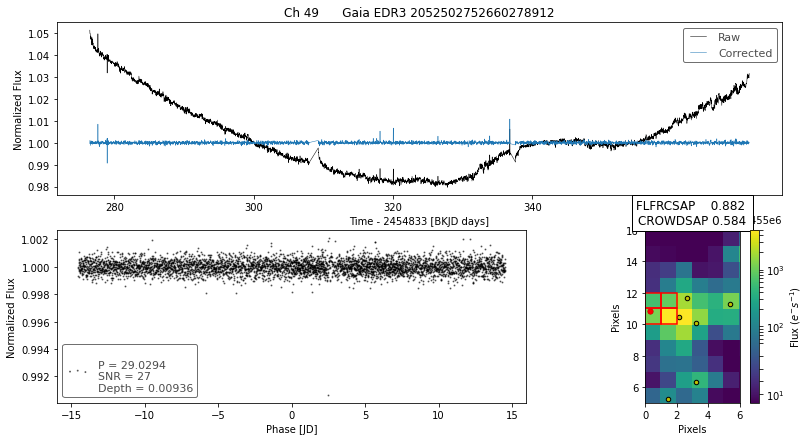

___________________________________________________
designation                Gaia EDR3 2101137038167330816
ra                                            290.605137
ra_error                                        0.114141
dec                                            40.387584
dec_error                                       0.111205
pmra                                           -4.943468
pmdec                                         -12.119791
parallax                                        0.389259
parallax_error                                  0.129708
phot_g_n_obs                                         385
phot_g_mean_flux                              651.720092
phot_g_mean_flux_error                          1.452183
phot_g_mean_mag                                18.652214
phot_bp_n_obs                                         29
phot_bp_mean_flux                             495.581011
phot_bp_mean_flux_error                         32.50388
phot_bp_mean_mag                    

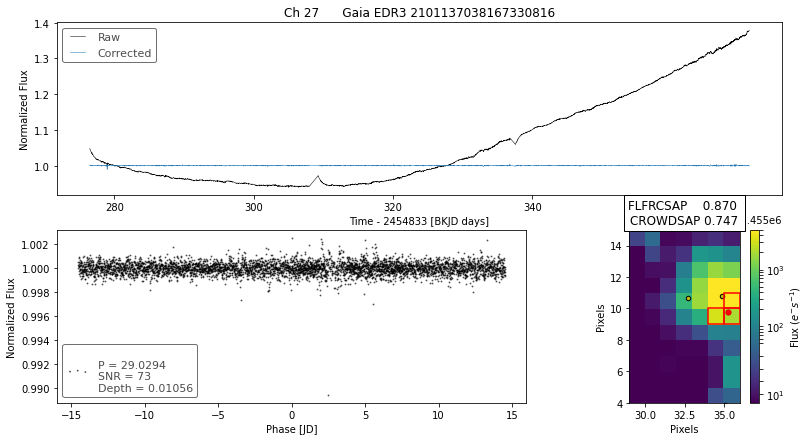

___________________________________________________
designation                Gaia EDR3 2143714973114706432
ra                                            282.735703
ra_error                                        0.009357
dec                                             48.26597
dec_error                                       0.010091
pmra                                           -5.477096
pmdec                                          11.785401
parallax                                         1.11525
parallax_error                                  0.010179
phot_g_n_obs                                         316
phot_g_mean_flux                           183884.645855
phot_g_mean_flux_error                         30.382107
phot_g_mean_mag                                12.526003
phot_bp_n_obs                                         38
phot_bp_mean_flux                           82165.897316
phot_bp_mean_flux_error                        48.383194
phot_bp_mean_mag                    

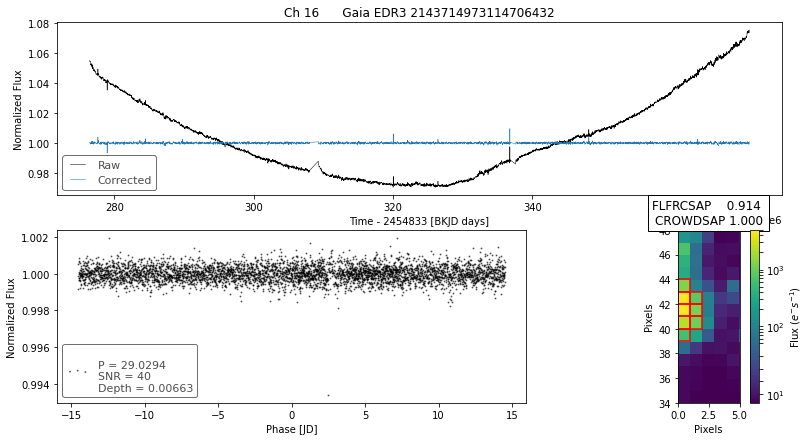

___________________________________________________
designation                Gaia EDR3 2126835511126494464
ra                                            290.359149
ra_error                                        0.027092
dec                                            43.740157
dec_error                                       0.026482
pmra                                           -2.018779
pmdec                                            -6.0683
parallax                                        0.165647
parallax_error                                  0.030049
phot_g_n_obs                                         379
phot_g_mean_flux                             7639.428727
phot_g_mean_flux_error                          3.000727
phot_g_mean_mag                                15.979714
phot_bp_n_obs                                         39
phot_bp_mean_flux                            3491.186008
phot_bp_mean_flux_error                        14.573751
phot_bp_mean_mag                    

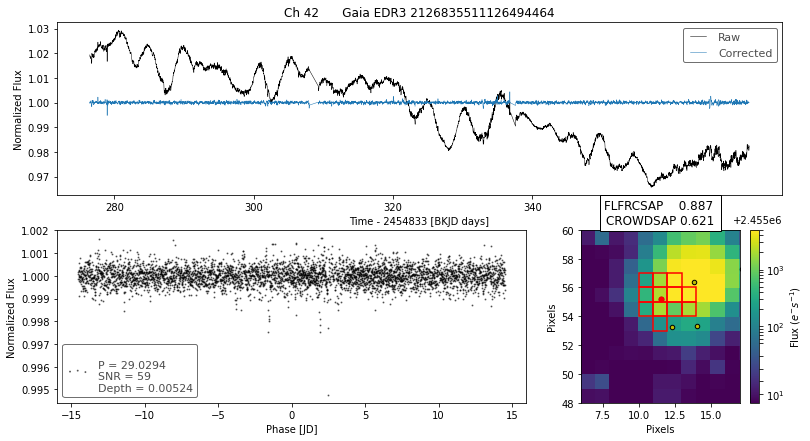

___________________________________________________
designation                Gaia EDR3 2052193137059167232
ra                                            294.372157
ra_error                                         0.14689
dec                                            38.872907
dec_error                                       0.283327
pmra                                            3.298985
pmdec                                          -8.430399
parallax                                        1.341224
parallax_error                                  0.207839
phot_g_n_obs                                         184
phot_g_mean_flux                             1057.511023
phot_g_mean_flux_error                          3.222634
phot_g_mean_mag                                18.126654
phot_bp_n_obs                                          0
phot_bp_mean_flux                100000000000000000000.0
phot_bp_mean_flux_error          100000000000000000000.0
phot_bp_mean_mag                 100

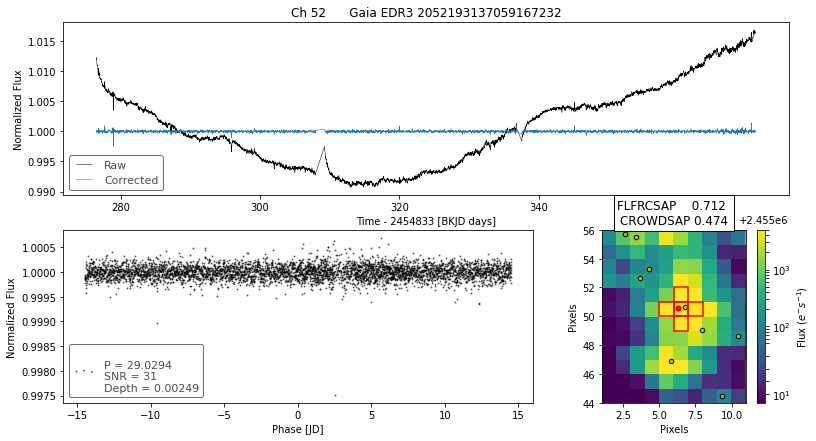

___________________________________________________
designation                Gaia EDR3 2101033924593919360
ra                                            289.311498
ra_error                                         0.17356
dec                                            39.747496
dec_error                                       0.196328
pmra                                           -0.167455
pmdec                                          -4.955748
parallax                                        0.685168
parallax_error                                  0.197759
phot_g_n_obs                                         298
phot_g_mean_flux                              431.159177
phot_g_mean_flux_error                          1.406583
phot_g_mean_mag                                19.100773
phot_bp_n_obs                                         30
phot_bp_mean_flux                             231.055789
phot_bp_mean_flux_error                        14.627894
phot_bp_mean_mag                    

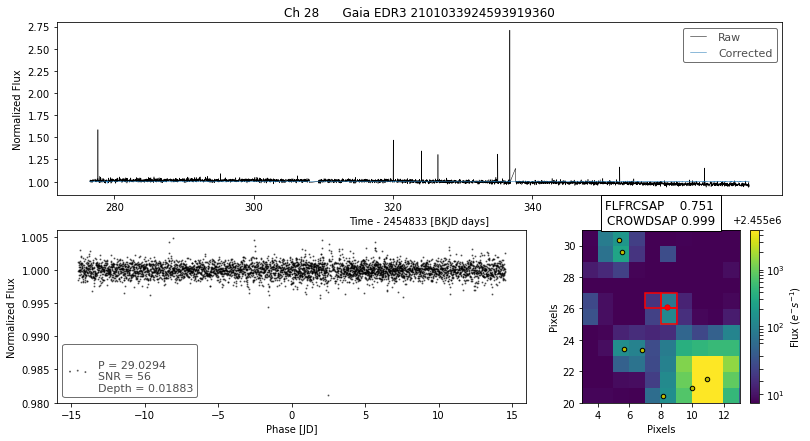

___________________________________________________
designation                Gaia EDR3 2077708781842667776
ra                                              293.8451
ra_error                                        0.067951
dec                                            41.908756
dec_error                                       0.082439
pmra                                           -4.760529
pmdec                                         -11.058531
parallax                                        0.479805
parallax_error                                  0.083856
phot_g_n_obs                                         293
phot_g_mean_flux                             1862.827541
phot_g_mean_flux_error                          4.760243
phot_g_mean_mag                                17.511936
phot_bp_n_obs                                         26
phot_bp_mean_flux                             1933.26842
phot_bp_mean_flux_error                         148.7847
phot_bp_mean_mag                    

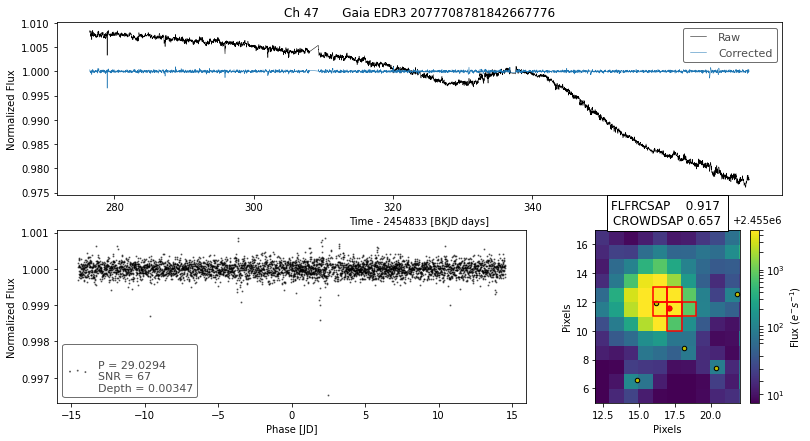

___________________________________________________
designation                Gaia EDR3 2128156883587655424
ra                                             294.38859
ra_error                                        0.039007
dec                                              46.7931
dec_error                                       0.046707
pmra                                           -1.304579
pmdec                                          -9.687105
parallax                                        0.601647
parallax_error                                  0.045662
phot_g_n_obs                                         357
phot_g_mean_flux                             3807.099112
phot_g_mean_flux_error                          2.376355
phot_g_mean_mag                                16.735882
phot_bp_n_obs                                         19
phot_bp_mean_flux                             2006.27482
phot_bp_mean_flux_error                         40.26858
phot_bp_mean_mag                    

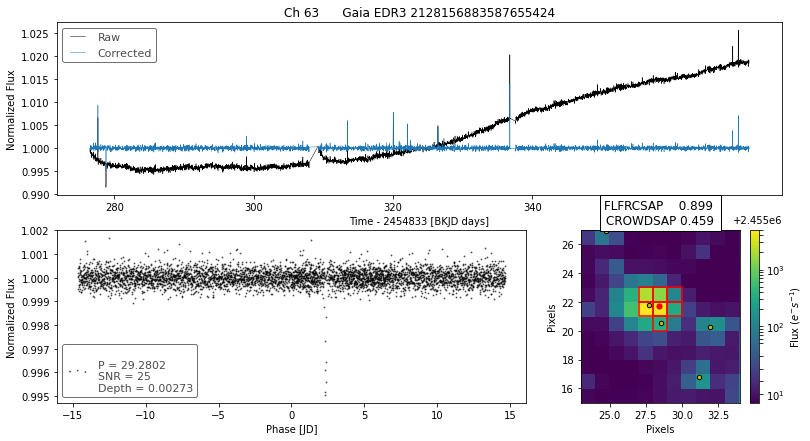

___________________________________________________
designation                Gaia EDR3 2107266570672734592
ra                                            285.189947
ra_error                                        0.009031
dec                                            46.028029
dec_error                                       0.010185
pmra                                           -1.466158
pmdec                                          20.683971
parallax                                        2.823488
parallax_error                                  0.010132
phot_g_n_obs                                         348
phot_g_mean_flux                           502282.474445
phot_g_mean_flux_error                          78.78746
phot_g_mean_mag                                11.434997
phot_bp_n_obs                                         42
phot_bp_mean_flux                          281831.400196
phot_bp_mean_flux_error                        133.61566
phot_bp_mean_mag                    

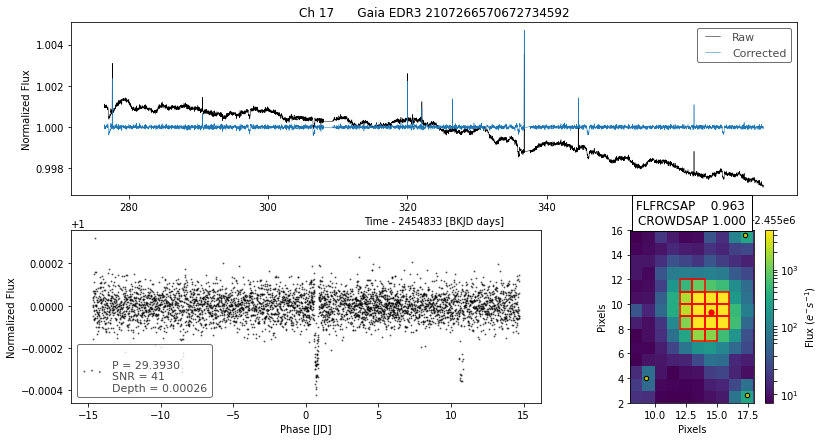

___________________________________________________
designation                Gaia EDR3 2077708884914725248
ra                                            293.840902
ra_error                                        0.260188
dec                                            41.918491
dec_error                                       0.297502
pmra                                           -0.985556
pmdec                                          -2.703207
parallax                                       -0.569402
parallax_error                                  0.322471
phot_g_n_obs                                         310
phot_g_mean_flux                              265.993914
phot_g_mean_flux_error                          0.867569
phot_g_mean_mag                                19.625187
phot_bp_n_obs                                         12
phot_bp_mean_flux                             131.262408
phot_bp_mean_flux_error                        16.877087
phot_bp_mean_mag                    

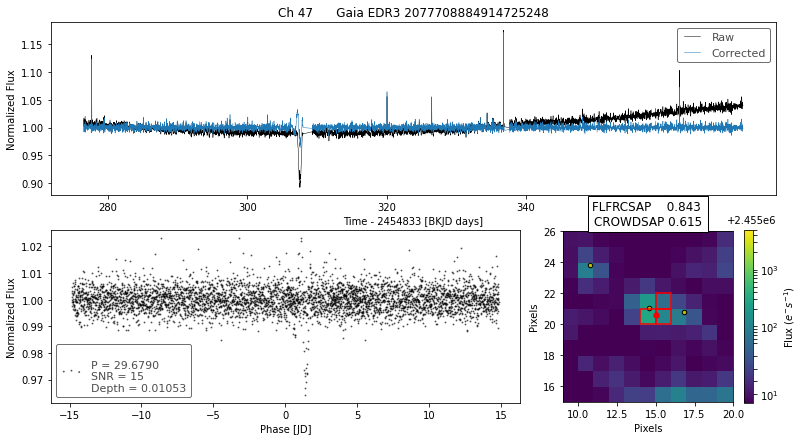

___________________________________________________


In [35]:
plot_highlights(from_depth)

In [26]:
highlights = ["Gaia EDR3 2076789727566520192", "Gaia EDR3 2078735858841858816", "Gaia EDR3 2082091568328182528", "Gaia EDR3 2102900959754861440", "2053614187112978176"]
highlights = ["Gaia EDR3 2102900959754861440"]

# CMD

In [29]:
catalogs["abs_gmag"] = (catalogs.phot_g_mean_mag + 
                          5 * (np.log10(catalogs.parallax/1e3) + 1))
catalogs["distance"] = 1e3 / catalogs.parallax
good_parallax = catalogs.parallax > 0.01

In [30]:
interesting = catalogs[np.in1d(catalogs.designation, highlights)]
interesting

,designation,ra,ra_error,dec,dec_error,pmra,pmdec,parallax,parallax_error,phot_g_n_obs,...,phot_bp_mean_mag,phot_rp_n_obs,phot_rp_mean_flux,phot_rp_mean_flux_error,phot_rp_mean_mag,col,row,clean_flag,abs_gmag,distance
17,Gaia EDR3 2102900959754861440,288.472397,0.081316,42.70924,0.093494,0.998662,2.7309,0.229695,0.094761,378,...,18.682972,45,738.578658,10.1094,17.576904,560.707682,591.306624,0,5.015386,4353.596783


In [31]:
kep_data = Table.read("../data/catalogs/kepler_dr2_4arcsec.fits", format="fits")
kep_data["abs_gmag"] = (kep_data['phot_g_mean_mag'] + 
                         5.*(np.log10(kep_data['parallax']/1.e3) + 1.))

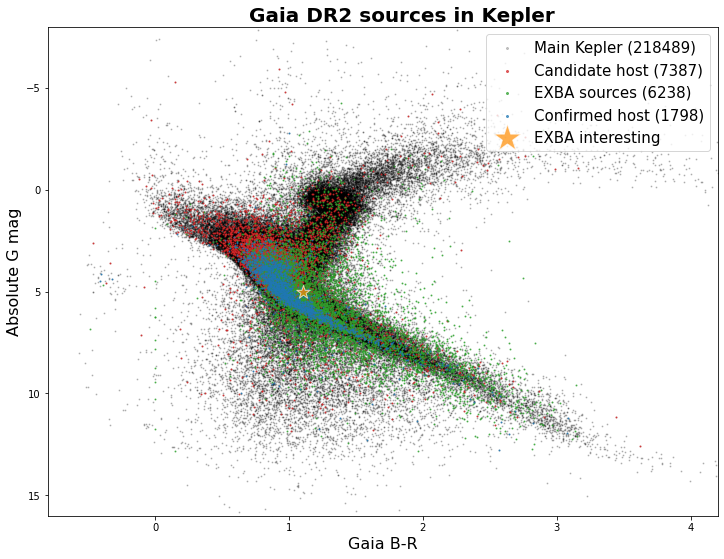

In [32]:
fig,ax = plt.subplots(1,1,figsize=(12,9))

filter = (kep_data['phot_g_mean_mag'] <= 20.) & (kep_data['parallax'] > 0.01)
ax.scatter(kep_data['bp_rp'], kep_data['abs_gmag'], 
           alpha=0.2, color='k', s=1,
           label='Main Kepler ({0})'.format(sum(filter)))

filter2 = (kep_data['planet?'] == 'cand') & filter
ax.scatter(kep_data['bp_rp'][filter2], kep_data['abs_gmag'][filter2], 
           alpha=0.7, s=1, color='tab:red',
           label='Candidate host ({0})'.format(sum(filter2)))

# EXBA
ax.scatter(catalogs['phot_bp_mean_mag'][good_parallax] - catalogs['phot_rp_mean_mag'][good_parallax], 
           catalogs['abs_gmag'][good_parallax], 
           alpha=0.7, s=1, color='tab:green',
           label='EXBA sources ({})'.format(sum(good_parallax)))

filter2 = (kep_data['planet?'] == 'conf') & filter
ax.scatter(kep_data['bp_rp'][filter2], kep_data['abs_gmag'][filter2], 
           alpha=0.7, s=1, color='tab:blue',
           label='Confirmed host ({0})'.format(sum(filter2)))

# interesting sources from EXBA
ax.scatter(interesting['phot_bp_mean_mag'] - interesting['phot_rp_mean_mag'], 
          interesting['abs_gmag'], 
          marker="*",
          alpha=0.7, s=200, color='darkorange', edgecolors="w",
          label='EXBA interesting')

ax.set_xlabel('Gaia B-R', fontsize=16)
ax.set_ylabel('Absolute G mag', fontsize=16)
ax.set_ylim([16,-8])
ax.set_xlim([-0.8,4.2])
ax.text(0.30,1.01,'Gaia DR2 sources in Kepler', transform=plt.gca().transAxes, 
        fontweight='bold', fontsize=20)
ax.legend(loc='upper right', fontsize=15, markerscale=2)

plt.show()